---
code-fold: true
code-tools: true
toc: true
categories: ["forecasting", "transformers"]
execute:
  error: false
  warning: false
title: "Grocery Sales Forecasting"
description: "Predicting future sales"
---

# Grocery Store Sales Forecasting

**Objective:** Predict future sales for each product in each shop using historical sales data.

### Problem Structure

The dataset is **panel data** (also known as longitudinal data) with 150 distinct time series (10 shops × 15 products). 

### Methodological Approach

After extensive EDA to understand the data, we employ a **multi-model comparison framework** that systematically increases model complexity, trading interpretability for predictive power:

1. **SARIMA** (Seasonal ARIMA) — Classical univariate baseline that models each shop-product independently
2. **Prophet** — Additive decomposition model with explicit seasonality components and hyperparameter tuning
3. **Chronos-2** — Pretrained transformer foundation model leveraging transfer learning (zero-shot + fine-tuned)
4. **TFT** (Temporal Fusion Transformer) — Global multivariate model that exploits cross-sectional structure with attention mechanisms

Each model is trained on historical data (through November 2021) and validated on a held-out month (December 2021) before generating final predictions.

### Key Technical Decisions

- **Validation Strategy**: December 2021 is held out as validation data to simulate real-world deployment conditions and avoid overfitting to historical patterns
- **Feature Engineering**: Engineered temporal features (day of week, month, holidays), lagged covariates (historical prices), and static identifiers (shop/product embeddings)
- **Experiment Tracking**: For all the models successfully fit, we compare MAE, RMSE, MAPE, and R²
- **Computational Efficiency**: Leveraged MPS (Metal Performance Shaders) for M3 GPU acceleration on deep learning models, with graceful CPU fallback


# Setup

In [1]:
# Import Libraries

# Standard library imports
import logging
import os
import random
import warnings
from datetime import timedelta
from io import StringIO
from pathlib import Path

# Third-party imports
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
import pymc as pm
import seaborn as sns
import torch
from chronos import Chronos2Pipeline
from darts import TimeSeries
from darts.models import TFTModel
from darts.dataprocessing.transformers import Scaler
from darts.utils.likelihood_models import QuantileRegression
from optuna.importance import get_param_importances
from optuna.pruners import MedianPruner
from prophet import Prophet
from prophet.diagnostics import cross_validation, performance_metrics
from pytorch_lightning.callbacks import EarlyStopping
from scipy import stats
from scipy.ndimage import uniform_filter1d
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error, mean_squared_error, r2_score
from statsmodels.nonparametric.smoothers_lowess import lowess
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.stats.stattools import durbin_watson
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.statespace.varmax import VARMAX
from statsmodels.tsa.stattools import pacf
from sklearn.model_selection import TimeSeriesSplit
from tqdm.auto import tqdm
import statsmodels.api as sm

# Configuration
warnings.filterwarnings('ignore')
plt.style.use('default')

# Define consistent color palette
COLORS = {
    'train': '#1f77b4',      # Blue for training data
    'test': '#d62728',       # Red for test predictions
    'price': '#FFA500',      # Gold for price
    'residual': '#404040',   # Dark gray for residuals
    'uncertainty': '#d62728', # Same red as test, will use with low alpha
}

# Style constants
TRAIN_ALPHA = 0.6
TEST_ALPHA = 0.7
UNCERTAINTY_ALPHA = 0.2
GRID_ALPHA = 0.3

# Set default palette for categorical plots (colorblind-friendly)
sns.set_palette("tab10")

%matplotlib inline

The StatsForecast module could not be imported. To enable support for the AutoARIMA, AutoETS and Croston models, please consider installing it.
The `XGBoost` module could not be imported. To enable XGBoost support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md
The `XGBoost` module could not be imported. To enable XGBoost support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md
The `XGBoost` module could not be imported. To enable XGBoost support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md
The `XGBoost` module could not be imported. To enable XGBoost support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md


In [2]:
# Load datasets 
train_df = pd.read_csv('data/sales_train.csv', dtype={'id': int, 'shop': int, 'product': int})
test_df = pd.read_csv('data/sales_test.csv', dtype={'id': int, 'shop': int, 'product': int})

# Create date column from year, month, day while keeping original columns
train_df['date'] = pd.to_datetime(train_df[['year', 'month', 'day']])
test_df['date'] = pd.to_datetime(test_df[['year', 'month', 'day']])

# Add day of week (0=Monday, 6=Sunday)
train_df['day_of_week'] = train_df['date'].dt.dayofweek
test_df['day_of_week'] = test_df['date'].dt.dayofweek

# Add validation flag: December 2021 is held out for validation
# Note: December 2021 appears in both train_df (with sales) and test_df (prices only)
train_df['is_validation'] = (train_df['date'].dt.year == 2021) & (train_df['date'].dt.month == 12)

print(f"Training data: {train_df['date'].min()} to {train_df['date'].max()}")
print(f"  - Tuning subset: {train_df[~train_df['is_validation']]['date'].min()} to {train_df[~train_df['is_validation']]['date'].max()} ({(~train_df['is_validation']).sum()} rows)")
print(f"  - Validation subset: {train_df[train_df['is_validation']]['date'].min()} to {train_df[train_df['is_validation']]['date'].max()} ({train_df['is_validation'].sum()} rows)")
print(f"Test data: {test_df['date'].min()} to {test_df['date'].max()} ({len(test_df)} rows)")

# Initialize global model comparison DataFrame
model_comparison = pd.DataFrame(columns=['Model', 'MAE', 'RMSE', 'MAPE (%)', 'R²', 'Naive MAE', 'Improvement (%)'])
model_comparison.set_index('Model', inplace=True)

Training data: 2018-01-01 00:00:00 to 2021-12-31 00:00:00
  - Tuning subset: 2018-01-01 00:00:00 to 2021-11-30 00:00:00 (214500 rows)
  - Validation subset: 2021-12-01 00:00:00 to 2021-12-31 00:00:00 (4030 rows)
Test data: 2021-12-01 00:00:00 to 2022-01-30 00:00:00 (9150 rows)


In [3]:
def validation_metrics(actuals, predictions, model_name, train_df=None, validation_df=None, naive_window_days=30):
    """
    Calculate and display validation metrics with naive baseline comparison.
    Updates the global model_comparison DataFrame with results.
    
    Parameters:
    - actuals: array-like of actual values
    - predictions: array-like of predicted values
    - model_name: str, name of the model for display
    - train_df: DataFrame, full training data for naive baseline calculation
    - validation_df: DataFrame, validation set data for naive baseline
    - naive_window_days: int, number of days to average for naive baseline
    
    Returns:
    - dict with keys: 'mae', 'rmse', 'mape', 'r2', 'naive_mae', 'improvement'
    """
    global model_comparison
    
    # Convert to numpy arrays
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    
    # Calculate metrics
    mae = mean_absolute_error(actuals, predictions)
    rmse = np.sqrt(mean_squared_error(actuals, predictions))
    
    # Calculate MAPE only for non-zero actuals to avoid division by zero
    # Use WMAPE (weighted MAPE) which is more robust
    non_zero_mask = actuals > 0.5  # Filter out zero/near-zero sales
    if non_zero_mask.sum() > 0:
        mape = mean_absolute_percentage_error(actuals[non_zero_mask], predictions[non_zero_mask]) * 100
    else:
        # Fallback to WMAPE if all actuals are near-zero
        mape = (np.abs(actuals - predictions).sum() / np.abs(actuals).sum() * 100) if actuals.sum() > 0 else 0
    
    r2 = r2_score(actuals, predictions)
    
    # Calculate naive baseline if data provided
    naive_mae = None
    improvement = None
    
    if train_df is not None and validation_df is not None:
        naive_predictions = []
        naive_actuals = []
        
        for idx, row in validation_df.iterrows():
            # Get last N days of training data for this shop-product combo
            last_n_days = train_df[
                (train_df['product'] == row['product']) &
                (train_df['shop'] == row['shop']) &
                (train_df['date'] < row['date']) &
                (train_df['date'] >= row['date'] - timedelta(days=naive_window_days + 1))
            ]
            
            naive_pred = last_n_days['sales'].mean() if len(last_n_days) > 0 else 0
            naive_predictions.append(naive_pred)
            naive_actuals.append(row['sales'])
        
        naive_predictions = np.array(naive_predictions)
        naive_actuals = np.array(naive_actuals)
        naive_mae = mean_absolute_error(naive_actuals, naive_predictions)
        improvement = ((naive_mae - mae) / naive_mae * 100) if naive_mae > 0 else 0
    
    # Print results
    print(f"{model_name.upper()} - VALIDATION SET EVALUATION")
    print(f"MAE:  {mae:.3f}")
    print(f"RMSE: {rmse:.3f}")
    print(f"MAPE: {mape:.2f}%")
    print(f"R²:   {r2:.4f}")
    
    # Update global model comparison DataFrame
    model_comparison.loc[model_name] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'R²': r2,
        'Naive MAE': naive_mae if naive_mae is not None else np.nan,
        'Improvement (%)': improvement if improvement is not None else np.nan
    }
    
    return {
        'mae': mae,
        'rmse': rmse,
        'mape': mape,
        'r2': r2,
        'naive_mae': naive_mae,
        'improvement': improvement
    }


def plot_residual_diagnostics(actuals, predictions, model_name, r2_score_val=None, dates=None):
    """
    Create 2×3 grid of residual diagnostic plots for time series.
    
    Parameters:
    - actuals: array-like of actual values
    - predictions: array-like of predicted values
    - model_name: str, name of the model for display
    - r2_score_val: float, optional R² score to display (if None, will be calculated)
    - dates: array-like of dates (optional), enables temporal diagnostic plots
    """
    # Convert to numpy arrays
    actuals = np.array(actuals)
    predictions = np.array(predictions)
    residuals = actuals - predictions
    
    # Calculate R² if not provided
    if r2_score_val is None:
        r2_score_val = r2_score(actuals, predictions)
    
    # Create 2×3 subplot grid
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    
    # Plot 1: Predicted vs Actual scatter
    ax = axes[0, 0]
    ax.scatter(actuals, predictions, alpha=0.3, s=10, color=COLORS['residual'])
    ax.plot([actuals.min(), actuals.max()], [actuals.min(), actuals.max()], 
            color=COLORS['test'], linestyle='--', linewidth=2, label='Perfect Prediction')
    ax.set_xlabel('Actual Sales', fontweight='bold')
    ax.set_ylabel('Predicted Sales', fontweight='bold')
    ax.set_title(f'Predicted vs Actual\nR² = {r2_score_val:.4f}', fontweight='bold')
    ax.legend()
    ax.grid(True, alpha=GRID_ALPHA)
    
    # Plot 2: Residuals vs Predicted
    ax = axes[0, 1]
    ax.scatter(predictions, residuals, alpha=0.3, s=10, color=COLORS['residual'])
    ax.axhline(y=0, color=COLORS['test'], linestyle='--', linewidth=2)
    ax.set_xlabel('Predicted Sales', fontweight='bold')
    ax.set_ylabel('Residuals', fontweight='bold')
    ax.set_title('Residual Plot', fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    
    # Plot 3: Residuals over time (if dates provided)
    ax = axes[0, 2]
    if dates is not None:
        dates_array = pd.to_datetime(dates)
        ax.scatter(dates_array, residuals, alpha=0.3, s=10, color=COLORS['residual'])
        ax.axhline(y=0, color=COLORS['test'], linestyle='--', linewidth=2)
        ax.set_xlabel('Date', fontweight='bold')
        ax.set_ylabel('Residuals', fontweight='bold')
        ax.set_title('Residuals Over Time', fontweight='bold')
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True, alpha=GRID_ALPHA)
    else:
        ax.text(0.5, 0.5, 'No temporal data\nprovided', ha='center', va='center',
                transform=ax.transAxes, fontsize=12, color='gray')
        ax.set_title('Residuals Over Time', fontweight='bold')
    
    # Plot 4: Residual histogram
    ax = axes[1, 0]
    # Calculate x-axis limits to 95% of data (2.5th to 97.5th percentile)
    xlim_lower = np.percentile(residuals, 2.5)
    xlim_upper = np.percentile(residuals, 97.5)
    # Create bin edges for the restricted range with 50 bins
    bin_edges = np.linspace(xlim_lower, xlim_upper, 51)
    ax.hist(residuals, bins=bin_edges, color=COLORS['residual'], edgecolor='black', alpha=0.7)
    ax.axvline(x=0, color=COLORS['test'], linestyle='--', linewidth=2)
    ax.set_xlim(xlim_lower, xlim_upper)
    ax.set_xlabel('Residual', fontweight='bold')
    ax.set_ylabel('Frequency', fontweight='bold')
    ax.set_title('Residual Distribution', fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    
    # Plot 5: Q-Q plot
    ax = axes[1, 1]
    stats.probplot(residuals, dist="norm", plot=ax)
    # Change colors to match residual theme
    ax.get_lines()[0].set_markerfacecolor(COLORS['residual'])
    ax.get_lines()[0].set_markeredgecolor(COLORS['residual'])
    ax.get_lines()[0].set_alpha(0.3)
    ax.get_lines()[1].set_color(COLORS['test'])  # Red reference line
    ax.get_lines()[1].set_linestyle('--')
    ax.set_title('Q-Q Plot', fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    
    # Plot 6: ACF of residuals (if dates provided)
    ax = axes[1, 2]
    if dates is not None and len(residuals) > 10:
        # Sort by date for ACF
        dates_array = pd.to_datetime(dates)
        sorted_indices = np.argsort(dates_array)
        sorted_residuals = residuals[sorted_indices]
        
        # Calculate and plot ACF
        from statsmodels.graphics.tsaplots import plot_acf
        plot_acf(sorted_residuals, lags=min(40, len(sorted_residuals)//2), ax=ax, alpha=0.05, zero=False)
        ax.set_title('Autocorrelation of Residuals', fontweight='bold')
        ax.set_xlabel('Lag', fontweight='bold')
        ax.set_ylabel('Autocorrelation', fontweight='bold')
    else:
        ax.text(0.5, 0.5, 'No temporal data\nprovided', ha='center', va='center',
                transform=ax.transAxes, fontsize=12, color='gray')
        ax.set_title('Autocorrelation of Residuals', fontweight='bold')
    
    plt.suptitle(f'{model_name} Validation Set Analysis', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()


def plot_forecast(viz_df, shops, products, model_name, lower_col=None, upper_col=None):
    """
    Create full shop×product faceted grid of predictions vs actuals with marginal plots.
    
    Shows:
    - Blue line: 13 months of training data (Dec 2020 - Dec 2021)
    - Solid red line: Model predictions (Dec 2021 - Jan 2022, overlaps training by 1 month)
    - Light red band: Uncertainty intervals around predictions
    - Yellow line: Price on secondary y-axis
    - X-axis: Year and quarter labels (e.g., 2020...Q2...Q3...Q4...2021...)
    
    Parameters:
    - viz_df: DataFrame with columns ['shop', 'product', 'date', 'actual_sales',
              'predicted_sales_mean', 'price', 'split'] + optional uncertainty columns
    - shops: list of shop IDs
    - products: list of product IDs
    - model_name: str, name of the model for display
    - lower_col: str, name of lower uncertainty bound column (e.g., 'q05', 'q10', 'predicted_sales_lower')
    - upper_col: str, name of upper uncertainty bound column (e.g., 'q95', 'q90', 'predicted_sales_upper')
    """
    # Create full shop×product faceted visualization with margins
    n_shops = len(shops)
    n_products = len(products)
    
    # Create grid with extra row and column for margins
    fig, axes = plt.subplots(n_shops + 1, n_products + 1, 
                             figsize=(4*(n_products + 1), 3*(n_shops + 1)))
    
    # Ensure axes is 2D
    if n_shops == 1 and n_products == 1:
        axes = np.array([[axes]])
    elif n_shops + 1 == 1:
        axes = axes.reshape(1, -1)
    elif n_products + 1 == 1:
        axes = axes.reshape(-1, 1)
    
    # Generate x-axis ticks: years and quarters
    min_date = viz_df['date'].min()
    max_date = viz_df['date'].max()
    
    # Year starts (January) - use full year labels
    year_starts = pd.date_range(start=min_date.replace(month=1, day=1), 
                                 end=max_date, 
                                 freq='YS')
    year_ticks = [d for d in year_starts if min_date <= d <= max_date]
    year_labels = [str(d.year) for d in year_ticks]
    
    # Quarter starts (April, July, October) - use Q2, Q3, Q4 labels
    quarter_ticks = []
    quarter_labels = []
    for year in range(min_date.year, max_date.year + 1):
        for month, label in [(4, 'Q2'), (7, 'Q3'), (10, 'Q4')]:
            quarter_date = pd.Timestamp(year=year, month=month, day=1)
            if min_date <= quarter_date <= max_date:
                quarter_ticks.append(quarter_date)
                quarter_labels.append(label)
    
    # Combine year and quarter ticks
    all_ticks = year_ticks + quarter_ticks
    all_labels = year_labels + quarter_labels
    
    # Sort by date
    tick_order = np.argsort([t.timestamp() for t in all_ticks])
    all_ticks = [all_ticks[i] for i in tick_order]
    all_labels = [all_labels[i] for i in tick_order]
    
    # Plot top-left corner: Total across all shops and products
    ax = axes[0, 0]
    ax2 = ax.twinx()
    
    # Aggregate data
    total_data = viz_df.groupby('date').agg({
        'actual_sales': 'sum',
        'predicted_sales_mean': 'sum',
        'price': 'mean'
    }).reset_index()
    
    # Plot actual sales (blue line)
    actual_mask = total_data['actual_sales'].notna()
    if actual_mask.any():
        ax.plot(total_data.loc[actual_mask, 'date'], 
               total_data.loc[actual_mask, 'actual_sales'], 
               linewidth=1.5, alpha=TRAIN_ALPHA, color=COLORS['train'], label='Actual')
    
    # Plot predictions (solid red line)
    pred_mask = total_data['predicted_sales_mean'].notna()
    if pred_mask.any():
        ax.plot(total_data.loc[pred_mask, 'date'], 
               total_data.loc[pred_mask, 'predicted_sales_mean'], 
               linewidth=1.5, alpha=TEST_ALPHA, color=COLORS['test'], label='Predicted')
    
    # Plot price (yellow line on secondary axis)
    price_mask = total_data['price'].notna()
    if price_mask.any():
        ax2.plot(total_data.loc[price_mask, 'date'], 
                total_data.loc[price_mask, 'price'],
                linewidth=1.2, alpha=0.7, color=COLORS['price'], label='Price')
    
    ax.set_ylabel('Sales', fontsize=9, fontweight='bold', color=COLORS['train'])
    ax2.set_ylabel('Price', fontsize=9, fontweight='bold', color=COLORS['price'])
    ax.tick_params(axis='y', labelcolor=COLORS['train'])
    ax2.tick_params(axis='y', labelcolor=COLORS['price'])
    ax.set_title('ALL Shops & Products', fontsize=10, fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    ax.set_xticks(all_ticks)
    ax.set_xticklabels(all_labels, fontsize=7, rotation=45, ha='right')
    
    # Combined legend
    lines1, labels1 = ax.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax.legend(lines1 + lines2, labels1 + labels2, loc='upper left', fontsize=7)
    
    # Plot first row (marginal by product): j=0 is corner (done), j=1+ are products
    for j, product in enumerate(products, start=1):
        ax = axes[0, j]
        ax2 = ax.twinx()
        
        product_data = viz_df[viz_df['product'] == product].groupby('date').agg({
            'actual_sales': 'sum',
            'predicted_sales_mean': 'sum',
            'price': 'mean'
        }).reset_index()
        
        # Actual sales
        actual_mask = product_data['actual_sales'].notna()
        if actual_mask.any():
            ax.plot(product_data.loc[actual_mask, 'date'], 
                   product_data.loc[actual_mask, 'actual_sales'],
                   linewidth=1.2, alpha=TRAIN_ALPHA, color=COLORS['train'])
        
        # Predictions
        pred_mask = product_data['predicted_sales_mean'].notna()
        if pred_mask.any():
            ax.plot(product_data.loc[pred_mask, 'date'], 
                   product_data.loc[pred_mask, 'predicted_sales_mean'],
                   linewidth=1.2, alpha=TEST_ALPHA, color=COLORS['test'])
        
        # Price
        price_mask = product_data['price'].notna()
        if price_mask.any():
            ax2.plot(product_data.loc[price_mask, 'date'], 
                    product_data.loc[price_mask, 'price'],
                    linewidth=1.0, alpha=0.7, color=COLORS['price'])
        
        ax.set_title(f'Product {product} (All Shops)', fontsize=9, fontweight='bold')
        ax.grid(True, alpha=GRID_ALPHA)
        ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)
        ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=7)
        ax.set_xticks(all_ticks)
        ax.set_xticklabels(all_labels, fontsize=7, rotation=45, ha='right')
    
    # Plot first column (marginal by shop): i=0 is corner (done), i=1+ are shops
    for i, shop in enumerate(shops, start=1):
        ax = axes[i, 0]
        ax2 = ax.twinx()
        
        shop_data = viz_df[viz_df['shop'] == shop].groupby('date').agg({
            'actual_sales': 'sum',
            'predicted_sales_mean': 'sum',
            'price': 'mean'
        }).reset_index()
        
        # Actual sales
        actual_mask = shop_data['actual_sales'].notna()
        if actual_mask.any():
            ax.plot(shop_data.loc[actual_mask, 'date'], 
                   shop_data.loc[actual_mask, 'actual_sales'],
                   linewidth=1.2, alpha=TRAIN_ALPHA, color=COLORS['train'])
        
        # Predictions
        pred_mask = shop_data['predicted_sales_mean'].notna()
        if pred_mask.any():
            ax.plot(shop_data.loc[pred_mask, 'date'], 
                   shop_data.loc[pred_mask, 'predicted_sales_mean'],
                   linewidth=1.2, alpha=TEST_ALPHA, color=COLORS['test'])
        
        # Price
        price_mask = shop_data['price'].notna()
        if price_mask.any():
            ax2.plot(shop_data.loc[price_mask, 'date'], 
                    shop_data.loc[price_mask, 'price'],
                    linewidth=1.0, alpha=0.7, color=COLORS['price'])
        
        ax.set_ylabel('Sales', fontsize=9, fontweight='bold', color=COLORS['train'])
        ax.set_title(f'Shop {shop} (All Products)', fontsize=9, fontweight='bold')
        ax.grid(True, alpha=GRID_ALPHA)
        ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)
        ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=7)
        ax.set_xticks(all_ticks)
        ax.set_xticklabels(all_labels, fontsize=7, rotation=45, ha='right')
    
    # Plot individual shop-product combinations
    for i, shop in enumerate(shops, start=1):
        for j, product in enumerate(products, start=1):
            ax = axes[i, j]
            ax2 = ax.twinx()
            
            # Filter data for this shop-product combination
            data = viz_df[(viz_df['shop'] == shop) & (viz_df['product'] == product)].copy()
            
            if len(data) == 0:
                ax.text(0.5, 0.5, 'No Data', ha='center', va='center', transform=ax.transAxes)
                ax.set_title(f'S{shop}, P{product}', fontsize=8)
                ax2.set_yticks([])
                continue
            
            # Sort by date
            data = data.sort_values('date')
            
            # Plot actual sales (blue line)
            actual_mask = data['actual_sales'].notna()
            if actual_mask.any():
                ax.plot(data.loc[actual_mask, 'date'], 
                       data.loc[actual_mask, 'actual_sales'],
                       color=COLORS['train'], linewidth=1, alpha=TRAIN_ALPHA)
            
            # Plot predictions (solid red line)
            pred_mask = data['predicted_sales_mean'].notna()
            if pred_mask.any():
                pred_data = data.loc[pred_mask]
                ax.plot(pred_data['date'], pred_data['predicted_sales_mean'],
                       color=COLORS['test'], linewidth=1, alpha=TEST_ALPHA)
                
                # Plot uncertainty intervals if columns provided
                if lower_col and upper_col and lower_col in pred_data.columns and upper_col in pred_data.columns:
                    ax.fill_between(pred_data['date'], 
                                   pred_data[lower_col], 
                                   pred_data[upper_col],
                                   color=COLORS['uncertainty'], alpha=UNCERTAINTY_ALPHA)
            
            # Plot price (yellow line on secondary axis)
            price_mask = data['price'].notna()
            if price_mask.any():
                ax2.plot(data.loc[price_mask, 'date'], 
                        data.loc[price_mask, 'price'],
                        color=COLORS['price'], linewidth=0.8, alpha=0.7)
            
            # Formatting
            ax.set_title(f'S{shop}, P{product}', fontsize=8)
            ax.grid(True, alpha=GRID_ALPHA)
            ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=6)
            ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=6)
            
            # Only show y-axis labels on edges
            if j != 1:
                ax.set_yticklabels([])
            if j != n_products:
                ax2.set_yticklabels([])
            
            ax.set_xticks(all_ticks)
            ax.set_xticklabels(all_labels, fontsize=6, rotation=45, ha='right')
    
    # Overall title
    fig.suptitle(f'{model_name} - Validation Forecasts', fontsize=16, fontweight='bold', y=0.995)
    
    plt.tight_layout(rect=[0, 0, 1, 0.99])
    plt.show()

# EDA

Fortunately the dataset is just barely small enough for us to plot in it's entirety, getting a good sense of trends and patterns.

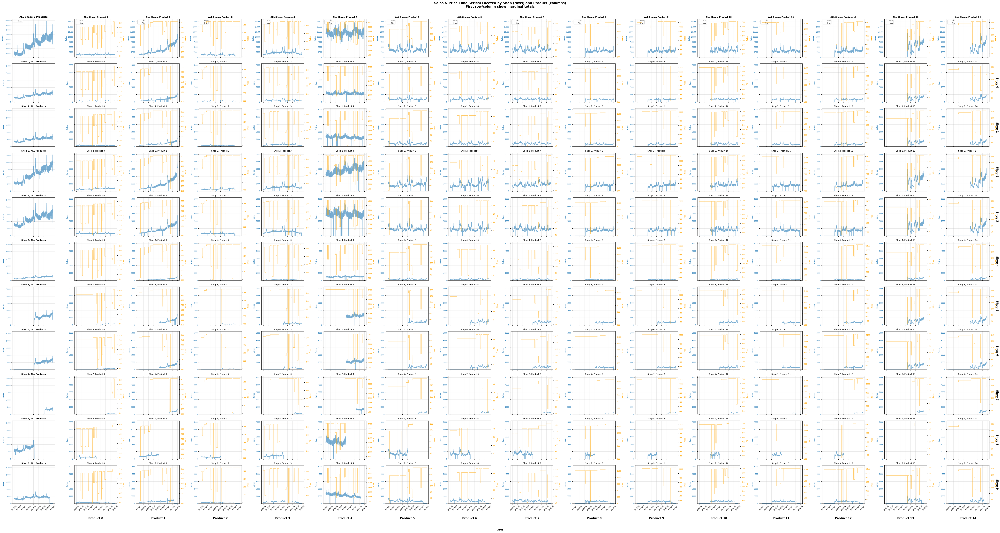

In [4]:
# Time series of sales and price faceted by shop and product 
# Get unique shops and products
shops = sorted(train_df['shop'].unique())
products = sorted(train_df['product'].unique())

# Pre-aggregate daily sales and price for all shop-product combinations at once (VECTORIZED!)
daily_data_all = train_df.groupby(['shop', 'product', 'date']).agg({
    'sales': 'sum',
    'price': 'mean'
}).reset_index()

# Calculate marginal data (aggregated across all shops/products)
# For first row: aggregate by product (sum sales across all shops)
marginal_by_product = train_df.groupby(['product', 'date']).agg({
    'sales': 'sum',
    'price': 'mean'
}).reset_index()

# For first column: aggregate by shop (sum sales across all products)
marginal_by_shop = train_df.groupby(['shop', 'date']).agg({
    'sales': 'sum',
    'price': 'mean'
}).reset_index()

# For top-left corner: aggregate everything (all shops and products)
marginal_total = train_df.groupby('date').agg({
    'sales': 'sum',
    'price': 'mean'
}).reset_index()

# Calculate sales ranges for different groups of plots
# Individual shop-product plots share this range
individual_sales_min = daily_data_all['sales'].min()
individual_sales_max = daily_data_all['sales'].max()

# Marginal by product (first row) share this range
marginal_product_sales_min = marginal_by_product['sales'].min()
marginal_product_sales_max = marginal_by_product['sales'].max()

# Marginal by shop (first column) share this range
marginal_shop_sales_min = marginal_by_shop['sales'].min()
marginal_shop_sales_max = marginal_by_shop['sales'].max()

# Total (corner) gets its own range
marginal_total_sales_min = marginal_total['sales'].min()
marginal_total_sales_max = marginal_total['sales'].max()

# Calculate price range for each product (to share within columns)
price_ranges = {}
for product in products:
    product_data = daily_data_all[daily_data_all['product'] == product]
    price_ranges[product] = (product_data['price'].min(), product_data['price'].max())

# Create a figure with subplots - add 1 extra row and column for marginals
n_shops = len(shops)
n_products = len(products)

fig, axes = plt.subplots(n_shops + 1, n_products + 1, figsize=(4*(n_products + 1), 3*(n_shops + 1)), sharex=True)

# Plot top-left corner: Total across all shops and products
ax = axes[0, 0]
line1 = ax.plot(marginal_total['date'], marginal_total['sales'], 
               linewidth=1.2, alpha=TRAIN_ALPHA, color=COLORS['train'], label='Sales')
ax.set_ylabel('Sales', fontsize=9, color=COLORS['train'], fontweight='bold')
ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)

# Set unique y-axis limit for total (corner) plot
ax.set_ylim(marginal_total_sales_min * 0.95, marginal_total_sales_max * 1.05)

ax.set_title('ALL Shops & Products', fontsize=10, fontweight='bold')
ax.grid(True, alpha=GRID_ALPHA)
ax.tick_params(axis='x', rotation=45, labelsize=7)
ax.legend(loc='upper left', fontsize=7)

# Plot first row (marginal by product): j=0 is corner (done), j=1+ are products
for j, product in enumerate(products, start=1):
    ax = axes[0, j]
    ax2 = ax.twinx()
    
    product_data = marginal_by_product[marginal_by_product['product'] == product]
    
    line1 = ax.plot(product_data['date'], product_data['sales'], 
                   linewidth=1.0, alpha=TRAIN_ALPHA, color=COLORS['train'], label='Sales')
    ax.set_ylabel('Sales', fontsize=8, color=COLORS['train'], fontweight='bold')
    ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)
    
    # Set shared sales y-axis limit for marginal row (by product)
    ax.set_ylim(marginal_product_sales_min * 0.95, marginal_product_sales_max * 1.05)
    
    line2 = ax2.plot(product_data['date'], product_data['price'], 
                    linewidth=1.0, alpha=TRAIN_ALPHA, color=COLORS['price'], label='Price')
    ax2.set_ylabel('Price', fontsize=8, color=COLORS['price'], fontweight='bold')
    ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=7)
    
    # Set shared price y-axis limits within each product column
    price_min, price_max = price_ranges[product]
    ax2.set_ylim(price_min * 0.95, price_max * 1.05)
    
    ax.set_title(f'ALL Shops, Product {product}', fontsize=9, fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    ax.tick_params(axis='x', rotation=45, labelsize=7)
    
    lines = line1 + line2
    labels = [l.get_label() for l in lines]
    ax.legend(lines, labels, loc='upper left', fontsize=6)

# Plot first column (marginal by shop): i=0 is corner (done), i=1+ are shops
for i, shop in enumerate(shops, start=1):
    ax = axes[i, 0]
    
    shop_data = marginal_by_shop[marginal_by_shop['shop'] == shop]
    
    line1 = ax.plot(shop_data['date'], shop_data['sales'], 
                   linewidth=1.0, alpha=TRAIN_ALPHA, color=COLORS['train'], label='Sales')
    ax.set_ylabel('Sales', fontsize=8, color=COLORS['train'], fontweight='bold')
    ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)
    
    # Set shared sales y-axis limit for marginal column (by shop)
    ax.set_ylim(marginal_shop_sales_min * 0.95, marginal_shop_sales_max * 1.05)
    
    ax.set_title(f'Shop {shop}, ALL Products', fontsize=9, fontweight='bold')
    ax.grid(True, alpha=GRID_ALPHA)
    ax.tick_params(axis='x', rotation=45, labelsize=7)

# Plot each shop-product combination (offset by 1 for marginals)
for i, shop in enumerate(shops, start=1):
    for j, product in enumerate(products, start=1):
        ax = axes[i, j]
        
        # Filter pre-aggregated data for this shop-product combination (FAST!)
        mask = (daily_data_all['shop'] == shop) & (daily_data_all['product'] == product)
        shop_product_data = daily_data_all[mask]
        
        if len(shop_product_data) > 0:
            # Create twin axis for price
            ax2 = ax.twinx()
            
            # Plot sales on primary axis
            line1 = ax.plot(shop_product_data['date'], shop_product_data['sales'], 
                           linewidth=0.8, alpha=TRAIN_ALPHA, color=COLORS['train'], label='Sales')
            ax.set_ylabel('Sales', fontsize=8, color=COLORS['train'])
            ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=7)
            
            # Set shared sales y-axis limits for all individual shop-product plots
            ax.set_ylim(individual_sales_min * 0.95, individual_sales_max * 1.05)
            
            # Plot price on secondary axis
            line2 = ax2.plot(shop_product_data['date'], shop_product_data['price'], 
                            linewidth=0.8, alpha=TRAIN_ALPHA, color=COLORS['price'], label='Price')
            ax2.set_ylabel('Price', fontsize=8, color=COLORS['price'])
            ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=7)
            
            # Set shared price y-axis limits within each product column
            price_min, price_max = price_ranges[product]
            ax2.set_ylim(price_min * 0.95, price_max * 1.05)
            
            ax.set_title(f'Shop {shop}, Product {product}', fontsize=9)
            ax.grid(True, alpha=GRID_ALPHA)
            
            # Rotate x-axis labels
            ax.tick_params(axis='x', rotation=45, labelsize=7)
        else:
            # No data for this combination
            ax.text(0.5, 0.5, 'No Data', ha='center', va='center', transform=ax.transAxes)
            ax.set_title(f'Shop {shop}, Product {product}', fontsize=9)

# Add row labels on the right side of each row
for i, shop in enumerate(shops, start=1):
    axes[i, -1].text(1.15, 0.5, f'Shop {shop}', 
                     transform=axes[i, -1].transAxes,
                     rotation=270, va='center', ha='left',
                     fontsize=12, fontweight='bold')

# Add column labels below each column
for j, product in enumerate(products, start=1):
    axes[-1, j].text(0.5, -0.35, f'Product {product}', 
                     transform=axes[-1, j].transAxes,
                     rotation=0, va='top', ha='center',
                     fontsize=12, fontweight='bold')

# Add common labels
fig.text(0.5, 0.01, 'Date', ha='center', fontsize=12, fontweight='bold')
fig.suptitle('Sales & Price Time Series: Faceted by Shop (rows) and Product (columns)\nFirst row/column show marginal totals', 
             fontsize=14, fontweight='bold', y=0.995)

plt.tight_layout(rect=[0.02, 0.03, 0.98, 0.99])
plt.show()


Next, we do some basic visualization of the temporal patterns in the data (weekly, annually, and autocorrelation).

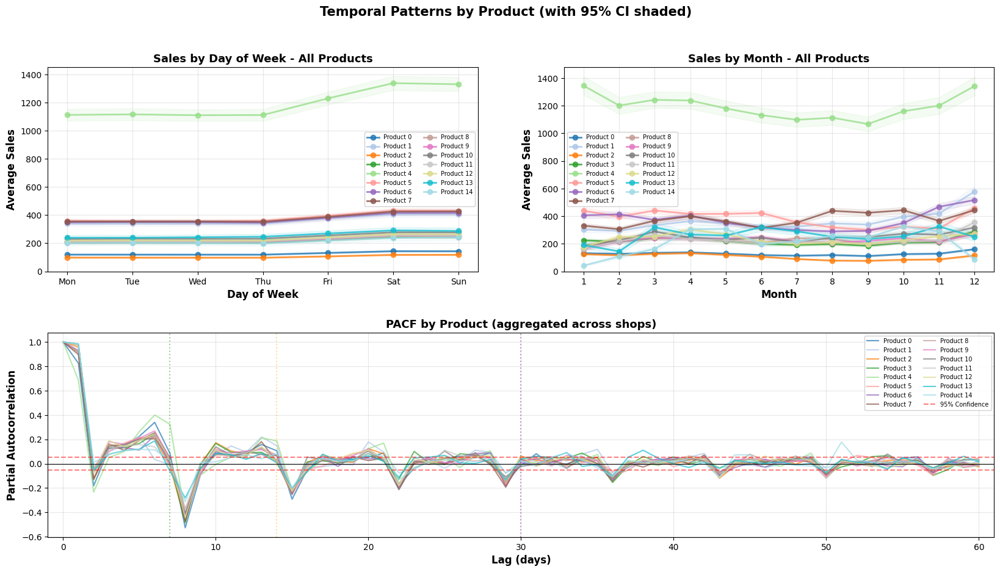

In [5]:
# Temporal Patterns by Product
# Analyze day-of-week, month seasonality, and PACF for all products on same panels

products = sorted(train_df['product'].unique())
n_products = len(products)

# Create figure with 2 rows: first row has 2 panels, second row has 1 wide panel
fig = plt.figure(figsize=(20, 10))
gs = fig.add_gridspec(2, 2, height_ratios=[1, 1], hspace=0.3)

days = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

# Use a colormap for distinct colors for each product
colors = plt.cm.tab20(np.linspace(0, 1, n_products))

# Day of week panel
ax1 = fig.add_subplot(gs[0, 0])
for i, product in enumerate(products):
    product_data = train_df[train_df['product'] == product]
    dow_stats = product_data.groupby('day_of_week')['sales'].agg(['mean', 'sem']).reset_index()
    dow_stats['ci'] = 1.96 * dow_stats['sem']
    
    ax1.plot(range(7), dow_stats['mean'], 
             marker='o', linewidth=2, markersize=6,
             color=colors[i], label=f'Product {product}', alpha=0.8)
    ax1.fill_between(range(7), 
                     dow_stats['mean'] - dow_stats['ci'], 
                     dow_stats['mean'] + dow_stats['ci'],
                     color=colors[i], alpha=0.1)

ax1.set_xticks(range(7))
ax1.set_xticklabels(days)
ax1.set_xlabel('Day of Week', fontsize=12, fontweight='bold')
ax1.set_ylabel('Average Sales', fontsize=12, fontweight='bold')
ax1.set_title('Sales by Day of Week - All Products', fontsize=13, fontweight='bold')
ax1.set_ylim(bottom=0)
ax1.grid(True, alpha=0.3)
ax1.legend(loc='best', ncol=2, fontsize=7, framealpha=0.9)

# Month panel
ax2 = fig.add_subplot(gs[0, 1])
for i, product in enumerate(products):
    product_data = train_df[train_df['product'] == product]
    month_stats = product_data.groupby('month')['sales'].agg(['mean', 'sem']).reset_index()
    month_stats['ci'] = 1.96 * month_stats['sem']
    
    ax2.plot(range(1, 13), month_stats['mean'],
             marker='o', linewidth=2, markersize=6,
             color=colors[i], label=f'Product {product}', alpha=0.8)
    ax2.fill_between(range(1, 13),
                     month_stats['mean'] - month_stats['ci'],
                     month_stats['mean'] + month_stats['ci'],
                     color=colors[i], alpha=0.1)

ax2.set_xlabel('Month', fontsize=12, fontweight='bold')
ax2.set_ylabel('Average Sales', fontsize=12, fontweight='bold')
ax2.set_title('Sales by Month - All Products', fontsize=13, fontweight='bold')
ax2.set_xticks(range(1, 13))
ax2.set_ylim(bottom=0)
ax2.grid(True, alpha=0.3)
ax2.legend(loc='best', ncol=2, fontsize=7, framealpha=0.9)

# PACF panel - Calculate PACF for each product separately (optimized) - FULL WIDTH
ax3 = fig.add_subplot(gs[1, :])
max_lags = 60

# Calculate PACF for each product - aggregate by date first to reduce computation
for i, product in enumerate(products):
    # Get all data for this product across all shops and aggregate by date
    product_data = train_df[train_df['product'] == product].sort_values('date')
    
    # Aggregate sales by date (sum across all shops for this product)
    daily_sales = product_data.groupby('date')['sales'].sum().values
    
    if len(daily_sales) > max_lags + 1 and np.std(daily_sales) > 0:
        try:
            # Calculate PACF
            pacf_values = pacf(daily_sales, nlags=max_lags, method='ywm')
            
            if not np.any(np.isnan(pacf_values)):
                # Plot as line
                ax3.plot(range(len(pacf_values)), pacf_values, 
                        linewidth=1.5, color=colors[i], label=f'Product {product}', alpha=0.7)
        except Exception as e:
            pass

# Add reference lines
confidence_threshold = 1.96 / np.sqrt(len(train_df.groupby('date').size()))
ax3.axhline(y=confidence_threshold, color='red', linestyle='--', linewidth=1.5, alpha=0.5, label='95% Confidence')
ax3.axhline(y=-confidence_threshold, color='red', linestyle='--', linewidth=1.5, alpha=0.5)
ax3.axhline(y=0, color='black', linestyle='-', linewidth=0.8)

# Add vertical lines at key lags
ax3.axvline(x=7, color='green', linestyle=':', linewidth=1.5, alpha=0.4)
ax3.axvline(x=14, color='orange', linestyle=':', linewidth=1.5, alpha=0.4)
ax3.axvline(x=30, color='purple', linestyle=':', linewidth=1.5, alpha=0.4)

ax3.set_xlabel('Lag (days)', fontsize=12, fontweight='bold')
ax3.set_ylabel('Partial Autocorrelation', fontsize=12, fontweight='bold')
ax3.set_title('PACF by Product (aggregated across shops)', fontsize=13, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.legend(loc='best', ncol=2, fontsize=7, framealpha=0.9)
ax3.set_xlim(-1, max_lags + 1)

plt.suptitle('Temporal Patterns by Product (with 95% CI shaded)', fontsize=15, fontweight='bold')
plt.tight_layout()
plt.show()

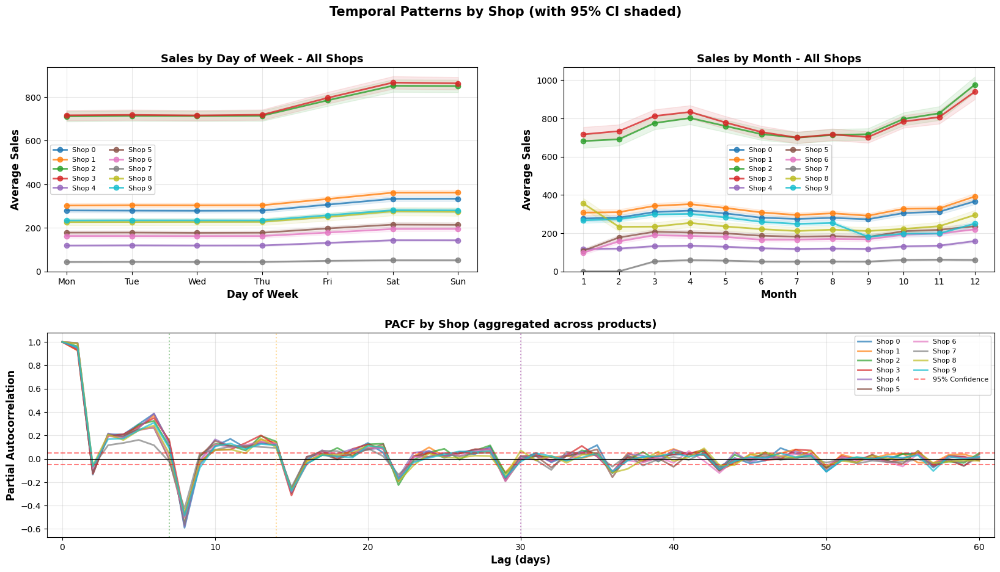

In [6]:
# Temporal Patterns by Shop
# Analyze day-of-week, month seasonality, and PACF for all shops on same panels

shops = sorted(train_df['shop'].unique())
n_shops = len(shops)

# Create figure with 2 rows: first row has 2 panels, second row has 1 wide panel
fig = plt.figure(figsize=(20, 10))
gs = fig.add_gridspec(2, 2, height_ratios=[1, 1], hspace=0.3)

days = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']

# Use a colormap for distinct colors for each shop
colors = plt.cm.tab10(np.linspace(0, 1, n_shops))

# Day of week panel
ax1 = fig.add_subplot(gs[0, 0])
for i, shop in enumerate(shops):
    shop_data = train_df[train_df['shop'] == shop]
    dow_stats = shop_data.groupby('day_of_week')['sales'].agg(['mean', 'sem']).reset_index()
    dow_stats['ci'] = 1.96 * dow_stats['sem']
    
    ax1.plot(range(7), dow_stats['mean'], 
             marker='o', linewidth=2, markersize=6,
             color=colors[i], label=f'Shop {shop}', alpha=0.8)
    ax1.fill_between(range(7), 
                     dow_stats['mean'] - dow_stats['ci'], 
                     dow_stats['mean'] + dow_stats['ci'],
                     color=colors[i], alpha=0.1)

ax1.set_xticks(range(7))
ax1.set_xticklabels(days)
ax1.set_xlabel('Day of Week', fontsize=12, fontweight='bold')
ax1.set_ylabel('Average Sales', fontsize=12, fontweight='bold')
ax1.set_title('Sales by Day of Week - All Shops', fontsize=13, fontweight='bold')
ax1.set_ylim(bottom=0)
ax1.grid(True, alpha=0.3)
ax1.legend(loc='best', ncol=2, fontsize=8, framealpha=0.9)

# Month panel
ax2 = fig.add_subplot(gs[0, 1])
for i, shop in enumerate(shops):
    shop_data = train_df[train_df['shop'] == shop]
    month_stats = shop_data.groupby('month')['sales'].agg(['mean', 'sem']).reset_index()
    month_stats['ci'] = 1.96 * month_stats['sem']
    
    ax2.plot(range(1, 13), month_stats['mean'],
             marker='o', linewidth=2, markersize=6,
             color=colors[i], label=f'Shop {shop}', alpha=0.8)
    ax2.fill_between(range(1, 13),
                     month_stats['mean'] - month_stats['ci'],
                     month_stats['mean'] + month_stats['ci'],
                     color=colors[i], alpha=0.1)

ax2.set_xlabel('Month', fontsize=12, fontweight='bold')
ax2.set_ylabel('Average Sales', fontsize=12, fontweight='bold')
ax2.set_title('Sales by Month - All Shops', fontsize=13, fontweight='bold')
ax2.set_xticks(range(1, 13))
ax2.set_ylim(bottom=0)
ax2.grid(True, alpha=0.3)
ax2.legend(loc='best', ncol=2, fontsize=8, framealpha=0.9)

# PACF panel - Calculate PACF for each shop separately (optimized) - FULL WIDTH
ax3 = fig.add_subplot(gs[1, :])
max_lags = 60

# Calculate PACF for each shop - aggregate by date first to reduce computation
for i, shop in enumerate(shops):
    # Get all data for this shop across all products and aggregate by date
    shop_data = train_df[train_df['shop'] == shop].sort_values('date')
    
    # Aggregate sales by date (sum across all products for this shop)
    daily_sales = shop_data.groupby('date')['sales'].sum().values
    
    if len(daily_sales) > max_lags + 1 and np.std(daily_sales) > 0:
        try:
            # Calculate PACF
            pacf_values = pacf(daily_sales, nlags=max_lags, method='ywm')
            
            if not np.any(np.isnan(pacf_values)):
                # Plot as line
                ax3.plot(range(len(pacf_values)), pacf_values, 
                        linewidth=2, color=colors[i], label=f'Shop {shop}', alpha=0.7)
        except Exception as e:
            pass

# Add reference lines
confidence_threshold = 1.96 / np.sqrt(len(train_df.groupby('date').size()))
ax3.axhline(y=confidence_threshold, color='red', linestyle='--', linewidth=1.5, alpha=0.5, label='95% Confidence')
ax3.axhline(y=-confidence_threshold, color='red', linestyle='--', linewidth=1.5, alpha=0.5)
ax3.axhline(y=0, color='black', linestyle='-', linewidth=0.8)

# Add vertical lines at key lags
ax3.axvline(x=7, color='green', linestyle=':', linewidth=1.5, alpha=0.4)
ax3.axvline(x=14, color='orange', linestyle=':', linewidth=1.5, alpha=0.4)
ax3.axvline(x=30, color='purple', linestyle=':', linewidth=1.5, alpha=0.4)

ax3.set_xlabel('Lag (days)', fontsize=12, fontweight='bold')
ax3.set_ylabel('Partial Autocorrelation', fontsize=12, fontweight='bold')
ax3.set_title('PACF by Shop (aggregated across products)', fontsize=13, fontweight='bold')
ax3.grid(True, alpha=0.3)
ax3.legend(loc='best', ncol=2, fontsize=8, framealpha=0.9)
ax3.set_xlim(-1, max_lags + 1)

plt.suptitle('Temporal Patterns by Shop (with 95% CI shaded)', fontsize=15, fontweight='bold')
plt.tight_layout()
plt.show()

Dataset: 137799 observations
Detrending shop×product time series with LOESS...
After LOESS detrending: 137799 observations
Filtered dataset: 137799 observations across 15 products
After LOESS detrending: 137799 observations
Filtered dataset: 137799 observations across 15 products


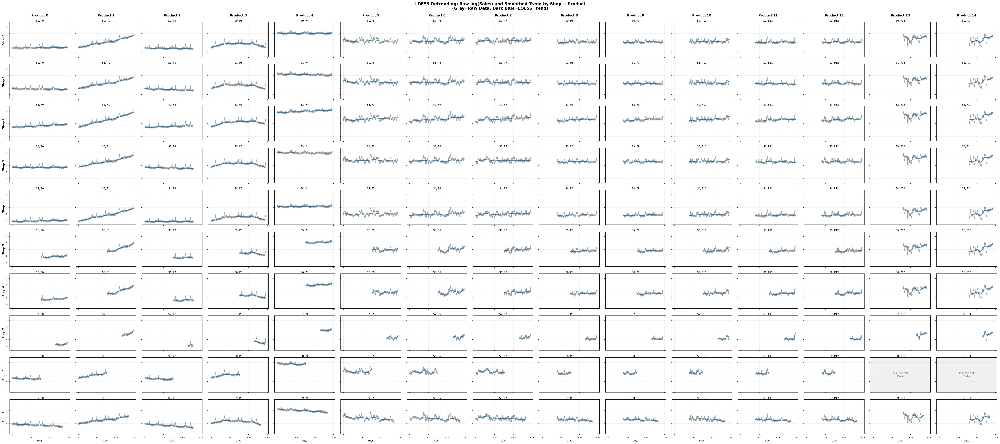

In [7]:
# PREPARE DATA FOR DETRENDING
valid_data = train_df[(train_df['sales'] > 0) & (train_df['price'] > 0)].copy()

# Add log transformations
valid_data['log_sales'] = np.log(valid_data['sales'])
valid_data['log_price'] = np.log(valid_data['price'])

# Remove inf/NaN values
valid_data = valid_data.replace([np.inf, -np.inf], np.nan)
valid_data = valid_data.dropna(subset=['log_sales', 'log_price'])

print(f"Dataset: {len(valid_data)} observations")

# DETREND EACH SHOP×PRODUCT TIME SERIES USING LOESS
print("Detrending shop×product time series with LOESS...")

# Create time index (days since start)
valid_data = valid_data.sort_values(['shop', 'product', 'date'])
min_date = valid_data['date'].min()
valid_data['days_since_start'] = (valid_data['date'] - min_date).dt.days

detrended_data = []

for (shop, product), group in valid_data.groupby(['shop', 'product']):
    if len(group) < 10:  # Skip if too few observations
        continue
    
    group = group.copy()
    
    # Sort by time
    group = group.sort_values('days_since_start')
    
    # Detrend log_sales with LOESS
    # frac controls smoothness: lower = less smooth (more wiggle), higher = smoother
    # Using frac=0.3 for moderate smoothing that captures trends without overfitting
    sales_smoothed = lowess(group['log_sales'].values, 
                           group['days_since_start'].values, 
                           frac=0.3, 
                           return_sorted=False)
    group['log_sales_detrended'] = group['log_sales'].values - sales_smoothed
    
    # Detrend log_price with LOESS
    price_smoothed = lowess(group['log_price'].values, 
                           group['days_since_start'].values, 
                           frac=0.3, 
                           return_sorted=False)
    group['log_price_detrended'] = group['log_price'].values - price_smoothed
    
    detrended_data.append(group)

valid_data = pd.concat(detrended_data, ignore_index=True)

print(f"After LOESS detrending: {len(valid_data)} observations")

# Filter to products with sufficient observations
product_counts = valid_data['product'].value_counts()
valid_products = product_counts[product_counts >= 50].index.tolist()
valid_data = valid_data[valid_data['product'].isin(valid_products)]

print(f"Filtered dataset: {len(valid_data)} observations across {len(valid_products)} products")

# Visualize LOESS smoothing: raw log(sales) vs LOESS trend for each shop×product
products_sorted = sorted(valid_data['product'].unique())
shops_sorted = sorted(valid_data['shop'].unique())
n_products = len(products_sorted)
n_shops = len(shops_sorted)

fig_loess, axes_loess = plt.subplots(n_shops, n_products, figsize=(3*n_products, 2*n_shops), sharex=True, sharey=True, dpi=150)

# Ensure axes is 2D even if only one shop or product
if n_shops == 1 and n_products == 1:
    axes_loess = np.array([[axes_loess]])
elif n_shops == 1:
    axes_loess = axes_loess.reshape(1, -1)
elif n_products == 1:
    axes_loess = axes_loess.reshape(-1, 1)

for shop_idx, shop in enumerate(shops_sorted):
    for prod_idx, product in enumerate(products_sorted):
        ax = axes_loess[shop_idx, prod_idx]
        
        # Get data for this shop×product combination
        shop_product_data = valid_data[(valid_data['product'] == product) & 
                                       (valid_data['shop'] == shop)].sort_values('days_since_start')
        
        if len(shop_product_data) < 10:
            ax.text(0.5, 0.5, 'Insufficient\nData', ha='center', va='center', 
                   transform=ax.transAxes, fontsize=9, color='gray')
            ax.set_facecolor('#f0f0f0')
        else:
            # Compute LOESS trend: log_sales - log_sales_detrended
            shop_product_data_copy = shop_product_data.copy()
            shop_product_data_copy['log_sales_trend'] = (shop_product_data_copy['log_sales'] - 
                                                         shop_product_data_copy['log_sales_detrended'])
            
            # Plot raw log(sales) - gray line for better visibility
            ax.plot(shop_product_data_copy['days_since_start'], 
                   shop_product_data_copy['log_sales'],
                   color=COLORS['residual'], linewidth=0.8, alpha=0.5, label='Raw')
            
            # Plot LOESS smoothed trend line on top
            ax.plot(shop_product_data_copy['days_since_start'], 
                   shop_product_data_copy['log_sales_trend'],
                   color=COLORS['train'], linewidth=2, alpha=0.9, label='LOESS Trend')
        
        # Title for each subplot
        ax.set_title(f'S{shop}, P{product}', fontsize=8, pad=2)
        
        # Y-axis labels only for leftmost column
        if prod_idx == 0:
            ax.set_ylabel(f'Shop {shop}', fontsize=9, fontweight='bold')
            ax.tick_params(axis='y', labelsize=6)
        else:
            ax.tick_params(axis='y', labelleft=False)
        
        # X-axis labels only for bottom row
        if shop_idx == n_shops - 1:
            ax.set_xlabel('Days', fontsize=7)
            ax.tick_params(axis='x', labelsize=6)
        else:
            ax.tick_params(axis='x', labelbottom=False)
        
        ax.grid(True, alpha=0.2, linewidth=0.5)

# Add column labels at the top
for prod_idx, product in enumerate(products_sorted):
    axes_loess[0, prod_idx].text(0.5, 1.15, f'Product {product}', 
                                  transform=axes_loess[0, prod_idx].transAxes,
                                  ha='center', va='bottom', fontsize=10, fontweight='bold')

fig_loess.suptitle('LOESS Detrending: Raw log(Sales) and Smoothed Trend by Shop × Product\n(Gray=Raw Data, Dark Blue=LOESS Trend)', 
                   fontsize=13, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

Here we use a basic LOESS procedure to detrend the data and see what additional behavior becomes apparent.

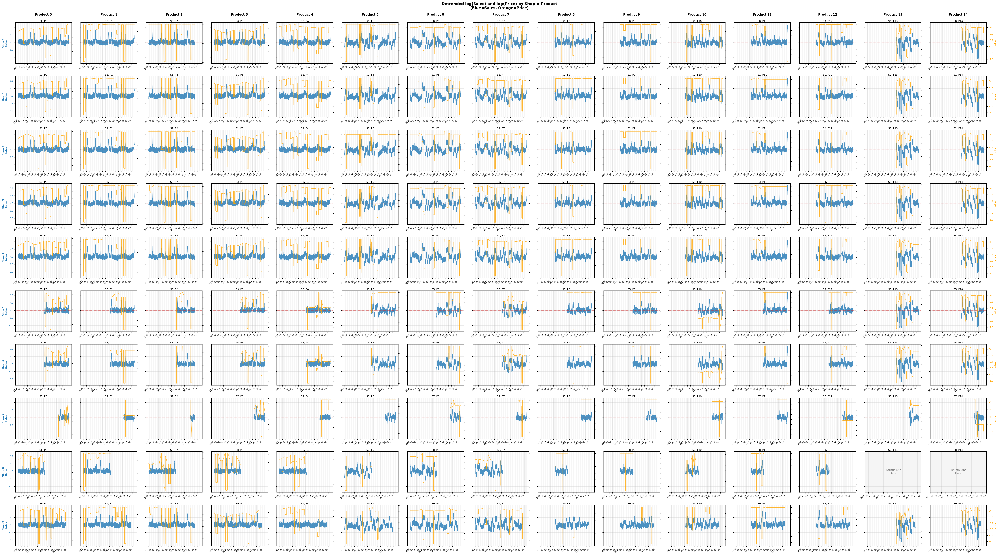

In [8]:
# Visualize detrended data with matplotlib
products_sorted = sorted(valid_data['product'].unique())
shops_sorted = sorted(valid_data['shop'].unique())
n_products = len(products_sorted)
n_shops = len(shops_sorted)

# Create subplots
fig_detrend, axes_detrend = plt.subplots(n_shops, n_products, 
                                         figsize=(3*n_products, 2.5*n_shops), 
                                         sharey=True, dpi=120)

# Ensure axes is 2D even if only one shop or product
if n_shops == 1 and n_products == 1:
    axes_detrend = np.array([[axes_detrend]])
elif n_shops == 1:
    axes_detrend = axes_detrend.reshape(1, -1)
elif n_products == 1:
    axes_detrend = axes_detrend.reshape(-1, 1)

# Get date range for alternating month backgrounds
min_date = valid_data['date'].min()
max_date = valid_data['date'].max()

# Generate list of month boundaries
month_starts = pd.date_range(start=min_date.replace(day=1), 
                              end=max_date, 
                              freq='MS')
month_starts_days = [(d - min_date).days for d in month_starts]

# Generate year and quarter tick positions
year_starts = pd.date_range(start=min_date.replace(month=1, day=1), 
                             end=max_date, 
                             freq='YS')
year_starts_days = [(d - min_date).days for d in year_starts]
year_labels = [str(d.year) for d in year_starts]

# Add Q1, Q2, Q3 markers (April 1, July 1, October 1)
quarter_ticks = []
quarter_labels = []
for year in range(min_date.year, max_date.year + 1):
    for month, label in [(4, 'Q2'), (7, 'Q3'), (10, 'Q4')]:
        quarter_date = pd.Timestamp(year=year, month=month, day=1)
        if min_date <= quarter_date <= max_date:
            quarter_ticks.append((quarter_date - min_date).days)
            quarter_labels.append(label)

# Combine year and quarter ticks
all_ticks = year_starts_days + quarter_ticks
all_labels = year_labels + quarter_labels

# Sort by tick position
tick_order = np.argsort(all_ticks)
all_ticks = [all_ticks[i] for i in tick_order]
all_labels = [all_labels[i] for i in tick_order]

# Process each shop-product combination
for shop_idx, shop in enumerate(shops_sorted):
    for prod_idx, product in enumerate(products_sorted):
        ax = axes_detrend[shop_idx, prod_idx]
        
        # Get data for this shop×product combination
        shop_product_data = valid_data[(valid_data['product'] == product) & 
                                       (valid_data['shop'] == shop)].sort_values('days_since_start').copy()
        
        if len(shop_product_data) < 10:
            # Add text for insufficient data
            ax.text(0.5, 0.5, 'Insufficient\nData', ha='center', va='center', 
                   transform=ax.transAxes, fontsize=9, color='gray')
            ax.set_facecolor('#f5f5f5')
        else:
            # Add alternating month backgrounds (every other month)
            ylim = ax.get_ylim()
            for i in range(0, len(month_starts_days)-1, 2):
                ax.axvspan(month_starts_days[i], month_starts_days[i+1], 
                          facecolor='lightgray', alpha=0.2, zorder=0)
            
            # Create twin axis for price
            ax2 = ax.twinx()
            
            # Plot detrended sales as line
            ax.plot(shop_product_data['days_since_start'], 
                   shop_product_data['log_sales_detrended'],
                   color=COLORS['train'], linewidth=1.0, alpha=0.8)
            
            # Plot detrended price as line
            ax2.plot(shop_product_data['days_since_start'], 
                    shop_product_data['log_price_detrended'],
                    color=COLORS['price'], linewidth=1.0, alpha=0.8)
            
            # Add zero reference line
            ax.axhline(y=0, color=COLORS['test'], linestyle='--', linewidth=0.8, alpha=0.5)
            
            # Format axes
            ax.tick_params(axis='y', labelcolor=COLORS['train'], labelsize=6)
            ax2.tick_params(axis='y', labelcolor=COLORS['price'], labelsize=6)
            
            # Only show y-axis labels on edge plots
            if prod_idx != 0:
                ax.tick_params(axis='y', labelleft=False)
            if prod_idx != n_products - 1:
                ax2.tick_params(axis='y', labelright=False)
        
        # Title for each subplot
        ax.set_title(f'S{shop}, P{product}', fontsize=8, pad=2)
        
        # Y-axis labels only for leftmost/rightmost columns
        if prod_idx == 0:
            ax.set_ylabel(f'Shop {shop}\nSales', fontsize=8, fontweight='bold', color=COLORS['train'])
        if prod_idx == n_products - 1 and len(shop_product_data) >= 10:
            ax2.set_ylabel('Price', fontsize=7, fontweight='bold', color=COLORS['price'])
        
        ax.grid(True, alpha=GRID_ALPHA, linewidth=0.5)

# Set X-axis to show years and quarters on ALL facets (apply after both loops)
for shop_idx in range(n_shops):
    for prod_idx in range(n_products):
        ax = axes_detrend[shop_idx, prod_idx]
        ax.set_xticks(all_ticks)
        ax.set_xticklabels(all_labels, fontsize=6, rotation=45, ha='right')

# Add column labels at the top
for prod_idx, product in enumerate(products_sorted):
    axes_detrend[0, prod_idx].text(0.5, 1.15, f'Product {product}', 
                                   transform=axes_detrend[0, prod_idx].transAxes,
                                   ha='center', va='bottom', fontsize=10, fontweight='bold')

fig_detrend.suptitle('Detrended log(Sales) and log(Price) by Shop × Product\n(Blue=Sales, Orange=Price)', 
                     fontsize=12, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

The covariance structure of the shops and products (how they vary together) is clearly important, so here we look at it directly.

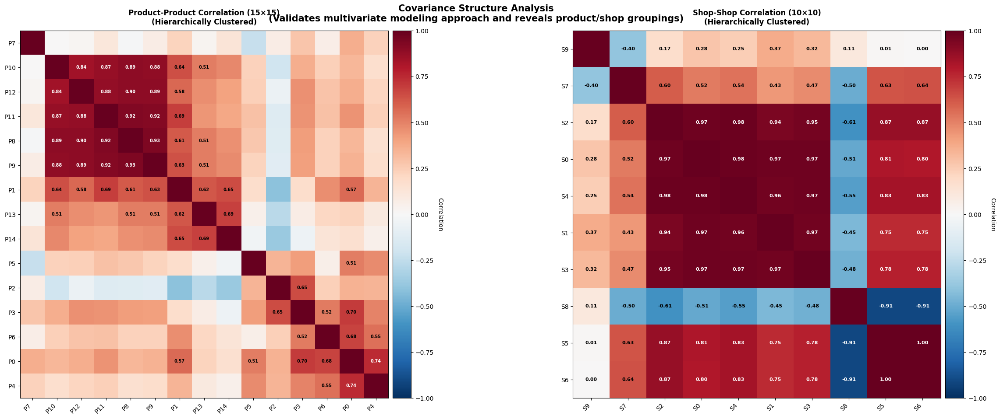

In [9]:
# Covariance Structure Analysis - Product, Shop, and Cross-Correlation Matrices

from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform

# Calculate correlation matrices for products and shops separately
product_daily = train_df.groupby(['product', 'date'])['sales'].sum().reset_index()
product_wide = product_daily.pivot(index='date', columns='product', values='sales').fillna(0)
product_corr = product_wide.corr()

shop_daily = train_df.groupby(['shop', 'date'])['sales'].sum().reset_index()
shop_wide = shop_daily.pivot(index='date', columns='shop', values='sales').fillna(0)
shop_corr = shop_wide.corr()

# Create 1-row layout: product & shop correlations side-by-side
fig = plt.figure(figsize=(24, 10))
gs = fig.add_gridspec(1, 2, width_ratios=[1, 1], 
                       hspace=0.3, wspace=0.3, left=0.05, right=0.98, top=0.92, bottom=0.08)

# ========== LEFT: PRODUCT-PRODUCT CORRELATION ==========
ax = fig.add_subplot(gs[0, 0])

# Hierarchical clustering to reorder products
product_dist = 1 - product_corr.abs()
product_linkage = linkage(squareform(product_dist), method='average')
product_order = dendrogram(product_linkage, no_plot=True)['leaves']
product_corr_ordered = product_corr.iloc[product_order, product_order]

# Plot heatmap
im = ax.imshow(product_corr_ordered, cmap='RdBu_r', aspect='equal', vmin=-1, vmax=1)
ax.set_xticks(range(len(product_corr_ordered)))
ax.set_yticks(range(len(product_corr_ordered)))
ax.set_xticklabels([f'P{p}' for p in product_corr_ordered.columns], rotation=45, ha='right', fontsize=10)
ax.set_yticklabels([f'P{p}' for p in product_corr_ordered.index], fontsize=10)
ax.set_title('Product-Product Correlation (15×15)\n(Hierarchically Clustered)', 
             fontsize=12, fontweight='bold', pad=10)

# Add colorbar
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
cbar = plt.colorbar(im, cax=cax)
cbar.set_label('Correlation', rotation=270, labelpad=15, fontsize=10)

# Add correlation values for strong correlations
for i in range(len(product_corr_ordered)):
    for j in range(len(product_corr_ordered)):
        if i != j and abs(product_corr_ordered.iloc[i, j]) > 0.5:
            text_color = 'white' if abs(product_corr_ordered.iloc[i, j]) > 0.7 else 'black'
            ax.text(j, i, f'{product_corr_ordered.iloc[i, j]:.2f}',
                   ha="center", va="center", color=text_color, fontsize=7, fontweight='bold')

# ========== RIGHT: SHOP-SHOP CORRELATION ==========
ax = fig.add_subplot(gs[0, 1])

# Hierarchical clustering to reorder shops
shop_dist = 1 - shop_corr.abs()
shop_linkage = linkage(squareform(shop_dist), method='average')
shop_order = dendrogram(shop_linkage, no_plot=True)['leaves']
shop_corr_ordered = shop_corr.iloc[shop_order, shop_order]

# Plot heatmap
im = ax.imshow(shop_corr_ordered, cmap='RdBu_r', aspect='equal', vmin=-1, vmax=1)
ax.set_xticks(range(len(shop_corr_ordered)))
ax.set_yticks(range(len(shop_corr_ordered)))
ax.set_xticklabels([f'S{s}' for s in shop_corr_ordered.columns], rotation=45, ha='right', fontsize=10)
ax.set_yticklabels([f'S{s}' for s in shop_corr_ordered.index], fontsize=10)
ax.set_title('Shop-Shop Correlation (10×10)\n(Hierarchically Clustered)', 
             fontsize=12, fontweight='bold', pad=10)

# Add colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
cbar = plt.colorbar(im, cax=cax)
cbar.set_label('Correlation', rotation=270, labelpad=15, fontsize=10)

# Add correlation values
for i in range(len(shop_corr_ordered)):
    for j in range(len(shop_corr_ordered)):
        if i != j:
            text_color = 'white' if abs(shop_corr_ordered.iloc[i, j]) > 0.7 else 'black'
            ax.text(j, i, f'{shop_corr_ordered.iloc[i, j]:.2f}',
                   ha="center", va="center", color=text_color, fontsize=8, fontweight='bold')

# Compute cross-correlation for use in next cell
cross_corr = pd.DataFrame(index=shop_wide.columns, columns=product_wide.columns)

for shop in shop_wide.columns:
    for product in product_wide.columns:
        cross_corr.loc[shop, product] = shop_wide[shop].corr(product_wide[product])

cross_corr = cross_corr.astype(float)

plt.suptitle('Covariance Structure Analysis\n(Validates multivariate modeling approach and reveals product/shop groupings)', 
             fontsize=15, fontweight='bold')
plt.show()

There are clearly latent product categories that we can reveal with some basic hierarchical clustering.

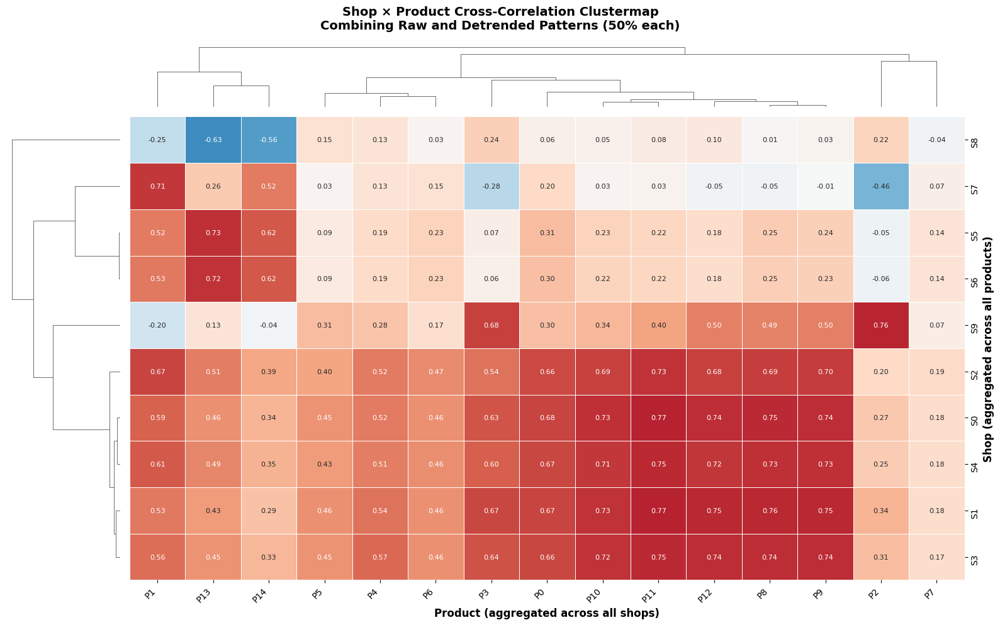


Product Clusters (based on raw + detrended correlations):
Cluster 1: [2, 7, 13]
Cluster 2: [1, 3, 4, 5, 6, 8, 9, 10, 11, 12]
Cluster 3: [0, 14]

Shop Clusters (based on raw + detrended correlations):
Cluster 1: [0, 2, 4]
Cluster 2: [3, 5, 6, 7, 8, 9]
Cluster 3: [1]


In [10]:
# Shop × Product Cross-Correlation Clustermap with Detrended Component
import seaborn as sns
from scipy.cluster.hierarchy import fcluster
from scipy.signal import detrend

# Compute detrended cross-correlation
# Detrend shop sales
shop_wide_detrended = shop_wide.copy()
for col in shop_wide_detrended.columns:
    shop_wide_detrended[col] = detrend(shop_wide_detrended[col])

# Detrend product sales
product_wide_detrended = product_wide.copy()
for col in product_wide_detrended.columns:
    product_wide_detrended[col] = detrend(product_wide_detrended[col])

# Compute detrended cross-correlation
cross_corr_detrended = pd.DataFrame(index=shop_wide.columns, columns=product_wide.columns)
for shop in shop_wide.columns:
    for product in product_wide.columns:
        cross_corr_detrended.loc[shop, product] = np.corrcoef(
            shop_wide_detrended[shop], 
            product_wide_detrended[product]
        )[0, 1]

cross_corr_detrended = cross_corr_detrended.astype(float)

# Combine raw and detrended correlations (weighted average)
# This captures both trend co-movement and residual pattern co-movement
alpha = 0.5  # Weight for raw vs detrended (0.5 = equal weight)
cross_corr_combined = alpha * cross_corr + (1 - alpha) * cross_corr_detrended

g = sns.clustermap(cross_corr_combined, 
                   cmap='RdBu_r', 
                   center=0,
                   vmin=-1, 
                   vmax=1,
                   annot=True, 
                   fmt='.2f',
                   annot_kws={'fontsize': 8},
                   cbar=False,
                   linewidths=0.5,
                   figsize=(16, 10),
                   dendrogram_ratio=(0.12, 0.12),
                   row_cluster=True,
                   col_cluster=True)

g.ax_heatmap.set_xticklabels([f'P{int(float(label.get_text()))}' for label in g.ax_heatmap.get_xticklabels()], 
                              rotation=45, ha='right', fontsize=10)
g.ax_heatmap.set_yticklabels([f'S{int(float(label.get_text()))}' for label in g.ax_heatmap.get_yticklabels()], 
                              fontsize=10)
g.ax_heatmap.set_xlabel('Product (aggregated across all shops)', fontsize=12, fontweight='bold')
g.ax_heatmap.set_ylabel('Shop (aggregated across all products)', fontsize=12, fontweight='bold')

# Remove the color key/legend in the top left corner
g.cax.set_visible(False)

# Add title with proper spacing
g.fig.suptitle('Shop × Product Cross-Correlation Clustermap\nCombining Raw and Detrended Patterns (50% each)',
               fontsize=14, fontweight='bold', y=0.99)

plt.tight_layout()
plt.show()

# Extract cluster assignments
# For products (columns)
n_product_clusters = 3  # Adjust this number as needed
product_clusters = fcluster(g.dendrogram_col.linkage, n_product_clusters, criterion='maxclust')
product_cluster_df = pd.DataFrame({
    'Product': cross_corr_combined.columns[g.dendrogram_col.reordered_ind],
    'Cluster': product_clusters
}).sort_values('Cluster')

print("\nProduct Clusters (based on raw + detrended correlations):")
for cluster in sorted(product_cluster_df['Cluster'].unique()):
    products = sorted(product_cluster_df[product_cluster_df['Cluster'] == cluster]['Product'].tolist())
    print(f"Cluster {cluster}: {products}")

# For shops (rows)
n_shop_clusters = 3  # Adjust this number as needed
shop_clusters = fcluster(g.dendrogram_row.linkage, n_shop_clusters, criterion='maxclust')
shop_cluster_df = pd.DataFrame({
    'Shop': cross_corr_combined.index[g.dendrogram_row.reordered_ind],
    'Cluster': shop_clusters
}).sort_values('Cluster')

print("\nShop Clusters (based on raw + detrended correlations):")
for cluster in sorted(shop_cluster_df['Cluster'].unique()):
    shops = sorted(shop_cluster_df[shop_cluster_df['Cluster'] == cluster]['Shop'].tolist())
    print(f"Cluster {cluster}: {shops}")

## Takeaways

**General**
- This is panel data that requires additively forecasting every product X shop combination separately
- Some shops appear or dissappear in the data. This occurs across all products, suggesting this is due to censoring and not stockouts, but we aren't sure
- Most products have consistent prices over the time frame of the data, with occasional sales
- Prices changes tend to synchronize across shops

**Trends**
- Most products don't appear to have strong trends (mostly stationary)
- Some products appear to have strong level trends across all shops (eg product 1 linear upwards, product 3 up and then down over time)
- Other products appear to have strong level trends but only at certain shops, even with opposite directions across shops (eg product 4)
- Certain products tend to move together or be missing together, indicating latent product categories (eg products 8-12, 13+14)
- Some shops exhibit a shop-specific trend (eg shop 9 downward trend)

**After Detrending**
- Most products don't seem to be hugely price elastic to the naked eye
- Temporary positive shocks to sales seem to be common and do not necessarily correlate with price drops, likely to be holidays based on timing
- The latent product categories appear even stronger after de-trending, clusters emerge around response to holidays and seasonality (products 0-4, 5-7, 8-12, and 13-14)

**Seasonality**
- **Autocorrelation:** Sales exhibit very strong autocorrelation, most strongly at the previous day and previous week
- **Weekly:** Sales are reliably higher on Saturday and Sunday, and to a lesser extent Friday
- **Annual:** Sales are particularly high around months 3-5 and 10-12

**Covariance**

Products behavior and shop behavior are both *strongly* correlated in **complex** ways. The best forecasting method will need to exploit this covariance structure and not simply model each one separately.

# Price Elasticity Model

## Econometric Baseline (Not Used for Forecasting)

Before diving into forecasting models, we estimate **price elasticity** using a classical econometric approach. This serves two purposes:

1. **Quantify price sensitivity**: Understand how responsive each product's demand is to price changes
2. **Inform feature engineering**: Determine whether price should be a key covariate in forecasting models

### Model Specification

$$\text{log(sales)}_{\text{detrended}} = \beta_0 + \sum_{p=1}^{15} \beta_p \cdot \text{log(price)}_{\text{detrended}} \cdot \mathbb{1}_{\text{product}=p} + \epsilon$$

**Why detrended variables?**
- Removes confounding from long-term trends (e.g., Product 1's growth might correlate spuriously with price changes)
- Isolates the **causal effect** of price fluctuations on sales fluctuations
- Controls for shop×product fixed effects implicitly (LOESS detrending is product-specific)

**Why product-specific elasticities?**
- Different products have different substitutability (e.g., premium vs. staple goods)
- No reference category ensures each elasticity is interpretable on its own

### Expected Findings

Based on EDA, we expect:
- **Low elasticity** for most products (visual inspection showed weak price-sales relationship)
- **Heterogeneity** across products (some may be more price-sensitive than others)
- **Model fit limitations** (R² will likely be low, confirming that time series methods will outperform static regression)

Using detrended data from EDA section
Dataset: 137799 observations across 15 products
Variables available: ['id', 'sales', 'price', 'shop', 'product', 'year', 'month', 'day', 'date', 'day_of_week', 'is_validation', 'log_sales', 'log_price', 'days_since_start', 'log_sales_detrended', 'log_price_detrended']


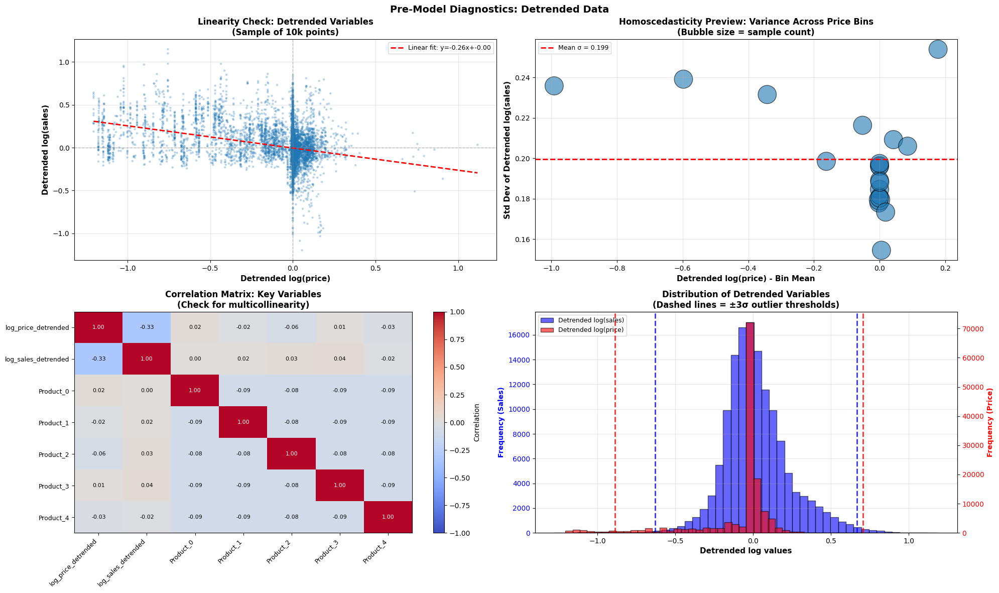

In [11]:
# Price Elasticity Analysis with LOESS Detrending (Simplified)
# Model: detrended_log(sales) = β × detrended_log(price) + product×price interactions
# Shop×product main effects are captured by the LOESS detrending itself

# USE DETRENDED DATA FROM EDA SECTION
# The valid_data DataFrame already contains log_sales_detrended and log_price_detrended
# computed in the earlier LOESS detrending cells

print(f"Using detrended data from EDA section")
print(f"Dataset: {len(valid_data)} observations across {len(valid_data['product'].unique())} products")
print(f"Variables available: {list(valid_data.columns)}")

# Pre-Model Regression Assumption Checks
# Check assumptions on detrended data BEFORE fitting the model

# Create 2x2 diagnostic panel
fig, axes = plt.subplots(2, 2, figsize=(20, 12))

# 1. LINEARITY CHECK: Scatter plot of detrended log(price) vs detrended log(sales)
ax = axes[0, 0]
sample_size = min(10000, len(valid_data))
sample_indices = np.random.choice(len(valid_data), sample_size, replace=False)
sample_data = valid_data.iloc[sample_indices]

ax.scatter(sample_data['log_price_detrended'], sample_data['log_sales_detrended'], 
           alpha=0.3, s=10, edgecolors='none')

# Add trend line
z = np.polyfit(sample_data['log_price_detrended'], sample_data['log_sales_detrended'], 1)
p = np.poly1d(z)
x_line = np.linspace(sample_data['log_price_detrended'].min(), 
                     sample_data['log_price_detrended'].max(), 100)
ax.plot(x_line, p(x_line), "r--", linewidth=2, label=f'Linear fit: y={z[0]:.2f}x+{z[1]:.2f}')

ax.axhline(y=0, color='gray', linestyle='--', linewidth=1, alpha=0.5)
ax.axvline(x=0, color='gray', linestyle='--', linewidth=1, alpha=0.5)
ax.set_xlabel('Detrended log(price)', fontsize=11, fontweight='bold')
ax.set_ylabel('Detrended log(sales)', fontsize=11, fontweight='bold')
ax.set_title('Linearity Check: Detrended Variables\n(Sample of 10k points)', fontsize=12, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3)

# 2. HOMOSCEDASTICITY PREVIEW: Variance of detrended sales across price bins
ax = axes[0, 1]
n_bins = 20
valid_data_sorted = valid_data.sort_values('log_price_detrended')
valid_data_sorted['price_bin'] = pd.qcut(valid_data_sorted['log_price_detrended'], 
                                          q=n_bins, duplicates='drop')

variance_by_bin = valid_data_sorted.groupby('price_bin').agg({
    'log_sales_detrended': ['mean', 'std', 'count'],
    'log_price_detrended': 'mean'
}).reset_index()
variance_by_bin.columns = ['price_bin', 'sales_mean', 'sales_std', 'count', 'price_mean']

ax.scatter(variance_by_bin['price_mean'], variance_by_bin['sales_std'], 
           s=variance_by_bin['count']/10, alpha=0.6, edgecolors='black', linewidth=1)
ax.axhline(y=variance_by_bin['sales_std'].mean(), color='red', linestyle='--', 
           linewidth=2, label=f'Mean σ = {variance_by_bin["sales_std"].mean():.3f}')
ax.set_xlabel('Detrended log(price) - Bin Mean', fontsize=11, fontweight='bold')
ax.set_ylabel('Std Dev of Detrended log(sales)', fontsize=11, fontweight='bold')
ax.set_title('Homoscedasticity Preview: Variance Across Price Bins\n(Bubble size = sample count)', 
             fontsize=12, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3)

# 3. CORRELATION MATRIX: Check for multicollinearity before fitting
ax = axes[1, 0]

# Create a simple correlation matrix with key variables
corr_vars = valid_data[['log_price_detrended', 'log_sales_detrended']].copy()

# Add a few product indicators to show variation
for prod in sorted(valid_data['product'].unique())[:5]:  # First 5 products as examples
    corr_vars[f'Product_{prod}'] = (valid_data['product'] == prod).astype(int)

corr_matrix = corr_vars.corr()

# Create heatmap
im = ax.imshow(corr_matrix, cmap='coolwarm', aspect='auto', vmin=-1, vmax=1)
ax.set_xticks(range(len(corr_matrix.columns)))
ax.set_yticks(range(len(corr_matrix.columns)))
ax.set_xticklabels(corr_matrix.columns, rotation=45, ha='right', fontsize=9)
ax.set_yticklabels(corr_matrix.columns, fontsize=9)

# Add correlation values
for i in range(len(corr_matrix)):
    for j in range(len(corr_matrix)):
        text = ax.text(j, i, f'{corr_matrix.iloc[i, j]:.2f}',
                      ha="center", va="center", color="black" if abs(corr_matrix.iloc[i, j]) < 0.5 else "white",
                      fontsize=8)

ax.set_title('Correlation Matrix: Key Variables\n(Check for multicollinearity)', 
             fontsize=12, fontweight='bold')
plt.colorbar(im, ax=ax, label='Correlation')

# 4. OUTLIERS: Distribution of detrended variables
ax = axes[1, 1]
ax2 = ax.twinx()

# Histogram for detrended sales
n_sales, bins_sales, patches_sales = ax.hist(valid_data['log_sales_detrended'], 
                                              bins=50, alpha=0.6, color='blue', 
                                              edgecolor='black', label='Detrended log(sales)')

# Histogram for detrended price
n_price, bins_price, patches_price = ax2.hist(valid_data['log_price_detrended'], 
                                               bins=50, alpha=0.6, color='red', 
                                               edgecolor='black', label='Detrended log(price)')

# Add vertical lines for outlier thresholds (±3 standard deviations)
sales_mean = valid_data['log_sales_detrended'].mean()
sales_std = valid_data['log_sales_detrended'].std()
ax.axvline(x=sales_mean - 3*sales_std, color='blue', linestyle='--', linewidth=2, alpha=0.8)
ax.axvline(x=sales_mean + 3*sales_std, color='blue', linestyle='--', linewidth=2, alpha=0.8)

price_mean = valid_data['log_price_detrended'].mean()
price_std = valid_data['log_price_detrended'].std()
ax2.axvline(x=price_mean - 3*price_std, color='red', linestyle='--', linewidth=2, alpha=0.8)
ax2.axvline(x=price_mean + 3*price_std, color='red', linestyle='--', linewidth=2, alpha=0.8)

# Labels and formatting
ax.set_xlabel('Detrended log values', fontsize=11, fontweight='bold')
ax.set_ylabel('Frequency (Sales)', fontsize=10, fontweight='bold', color='blue')
ax2.set_ylabel('Frequency (Price)', fontsize=10, fontweight='bold', color='red')
ax.set_title('Distribution of Detrended Variables\n(Dashed lines = ±3σ outlier thresholds)', 
             fontsize=12, fontweight='bold')
ax.tick_params(axis='y', labelcolor='blue')
ax2.tick_params(axis='y', labelcolor='red')
ax.grid(True, alpha=0.3)

# Add legend
lines1, labels1 = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines1 + lines2, labels1 + labels2, loc='upper left', fontsize=9)

plt.suptitle('Pre-Model Diagnostics: Detrended Data', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

Fitting simplified elasticity model (NO REFERENCE CATEGORY)...

PRICE ELASTICITY MODEL (NO REFERENCE CATEGORY)
Dependent Variable: LOESS detrended log(sales)
                                 OLS Regression Results                                 
Dep. Variable:     log_sales_detrended   R-squared (uncentered):                   0.239
Model:                             OLS   Adj. R-squared (uncentered):              0.239
Method:                  Least Squares   F-statistic:                              2889.
Date:                 Sun, 16 Nov 2025   Prob (F-statistic):                        0.00
Time:                         22:34:01   Log-Likelihood:                          33848.
No. Observations:               137799   AIC:                                 -6.767e+04
Df Residuals:                   137784   BIC:                                 -6.752e+04
Df Model:                           15                                                  
Covariance Type:             nonrobust   

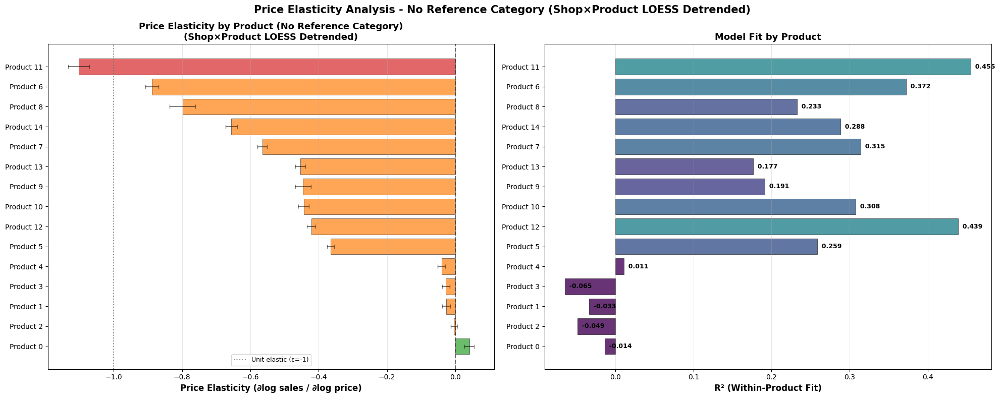


Detailed Elasticity Table:
 product  elasticity  std_error      p_value            category  n_obs  r_squared
      11   -1.102694   0.015720 0.000000e+00   Elastic (|ε| > 1)   8192   0.455369
       6   -0.887812   0.009994 0.000000e+00 Inelastic (|ε| < 1)  10960   0.372339
       8   -0.798526   0.019244 0.000000e+00 Inelastic (|ε| < 1)   8200   0.232734
      14   -0.655802   0.008599 0.000000e+00 Inelastic (|ε| < 1)   5170   0.288473
       7   -0.565235   0.007491 0.000000e+00 Inelastic (|ε| < 1)  11008   0.314519
      13   -0.453330   0.007725 0.000000e+00 Inelastic (|ε| < 1)   5199   0.176647
       9   -0.445645   0.011960 0.000000e+00 Inelastic (|ε| < 1)   8213   0.191164
      10   -0.443574   0.007810 0.000000e+00 Inelastic (|ε| < 1)   8241   0.307716
      12   -0.421802   0.006554 0.000000e+00 Inelastic (|ε| < 1)   8212   0.438853
       5   -0.365066   0.005186 0.000000e+00 Inelastic (|ε| < 1)  10975   0.258654
       4   -0.040369   0.005491 1.960654e-13 Inelastic (|ε|

In [12]:
print("Fitting simplified elasticity model (NO REFERENCE CATEGORY)...")

# CREATE SIMPLIFIED DESIGN MATRIX
# Include ALL product indicators for price interactions (no reference category)
products = sorted(valid_products)

# Product-specific price elasticities (interactions) - include ALL products
for prod in products:  # Changed from products[:-1] to include all products
    valid_data[f'Product_{prod}_LogPrice'] = (valid_data['product'] == prod).astype(int) * valid_data['log_price_detrended']

# Build feature matrix - ONLY product-specific price interactions (no common effect, no intercept)
# Each product gets its own independent elasticity estimate
feature_cols = [f'Product_{p}_LogPrice' for p in products]

X = valid_data[feature_cols]
# NO constant term added - each product gets its own elasticity directly
y = valid_data['log_sales_detrended']

# Fit model WITHOUT intercept
model = sm.OLS(y, X)
results = model.fit()
coefs = results.params

print(f"\n{'='*80}")
print(f"PRICE ELASTICITY MODEL (NO REFERENCE CATEGORY)")
print(f"Dependent Variable: LOESS detrended log(sales)")
print(f"{'='*80}")
print(results.summary())
print("\n")

# EXTRACT ELASTICITY RESULTS BY PRODUCT
elasticity_results = []

product_stats = valid_data.groupby('product').agg({
    'price': ['mean', 'std'],
    'sales': 'mean'
}).reset_index()
product_stats.columns = ['product', 'avg_price', 'price_std', 'avg_sales']

for product in sorted(valid_products):
    prod_stats = product_stats[product_stats['product'] == product].iloc[0]
    n_obs = len(valid_data[valid_data['product'] == product])
    
    price_coef_name = f'Product_{product}_LogPrice'
    
    # All products now have direct coefficients (no reference category)
    elasticity = coefs[price_coef_name]
    elasticity_se = results.bse[price_coef_name]
    t_stat = elasticity / elasticity_se if elasticity_se > 0 else 0
    p_value = 2 * (1 - stats.t.cdf(abs(t_stat), len(valid_data) - len(coefs)))
    
    t_crit = 1.96
    ci_lower = elasticity - t_crit * elasticity_se
    ci_upper = elasticity + t_crit * elasticity_se
    
    product_mask = valid_data['product'] == product
    if product_mask.sum() > 0:
        y_product = valid_data.loc[product_mask, 'log_sales_detrended'].values
        y_pred_product = results.fittedvalues[product_mask].values
        
        ss_res = np.sum((y_product - y_pred_product)**2)
        ss_tot = np.sum((y_product - np.mean(y_product))**2)
        r_squared = 1 - (ss_res / ss_tot) if ss_tot > 0 else 0
    else:
        r_squared = 0
    
    result = {
        'product': product,
        'elasticity': elasticity,
        'std_error': elasticity_se,
        'p_value': p_value,
        'ci_lower': ci_lower,
        'ci_upper': ci_upper,
        'significant': p_value < 0.05 if not np.isnan(p_value) else False,
        'avg_price': prod_stats['avg_price'],
        'avg_sales': prod_stats['avg_sales'],
        'price_std': prod_stats['price_std'],
        'r_squared': r_squared,
        'n_obs': n_obs
    }
    
    elasticity_results.append(result)

elasticity_df = pd.DataFrame(elasticity_results)
elasticity_df = elasticity_df.sort_values('elasticity')

conditions = [
    elasticity_df['elasticity'] < -1,
    (elasticity_df['elasticity'] >= -1) & (elasticity_df['elasticity'] < 0),
    elasticity_df['elasticity'] >= 0
]
categories = ['Elastic (|ε| > 1)', 'Inelastic (|ε| < 1)', 'Positive (unusual)']
elasticity_df['category'] = np.select(conditions, categories, default='Unknown')

print("\n" + "="*80)
print("ELASTICITY SUMMARY (NO REFERENCE CATEGORY)")
print("="*80)
print(f"Model includes independent elasticity estimates for all {len(products)} products")
print(f"No common baseline or reference category - each product has its own direct estimate")
print("")
for category in ['Elastic (|ε| > 1)', 'Inelastic (|ε| < 1)', 'Positive (unusual)']:
    products_in_cat = elasticity_df[elasticity_df['category'] == category]['product'].tolist()
    if products_in_cat:
        print(f"{category}: Products {products_in_cat}")
print("\n")

# VISUALIZATION - Simplified (only elasticity and R²)
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Use tab10 palette for elasticity categories
color_elastic = sns.color_palette("tab10")[3]  # Red-ish for elastic
color_inelastic = sns.color_palette("tab10")[1]  # Orange for inelastic
color_positive = sns.color_palette("tab10")[2]  # Green for positive (unusual)

# 1. Elasticities
ax = axes[0]
x_pos = np.arange(len(elasticity_df))

# Assign colors based on elasticity category
colors = []
for elasticity in elasticity_df['elasticity']:
    if elasticity < -1:
        colors.append(color_elastic)
    elif elasticity < 0:
        colors.append(color_inelastic)
    else:
        colors.append(color_positive)

ax.barh(x_pos, elasticity_df['elasticity'], color=colors, alpha=0.7, edgecolor='black', linewidth=0.5)

valid_se = ~elasticity_df['std_error'].isna()
if valid_se.any():
    ax.errorbar(elasticity_df.loc[valid_se, 'elasticity'], 
                x_pos[valid_se.values],
                xerr=1.96*elasticity_df.loc[valid_se, 'std_error'],
                fmt='none', ecolor='black', capsize=3, alpha=0.5, linewidth=1.5)

ax.axvline(x=0, color='#333333', linestyle='--', linewidth=1.5, alpha=0.7)
ax.axvline(x=-1, color='#666666', linestyle=':', linewidth=1.5, label='Unit elastic (ε=-1)', alpha=0.7)
ax.set_yticks(x_pos)
ax.set_yticklabels([f"Product {p}" for p in elasticity_df['product']])
ax.set_xlabel('Price Elasticity (∂log sales / ∂log price)', fontsize=12, fontweight='bold')
ax.set_title('Price Elasticity by Product (No Reference Category)\n(Shop×Product LOESS Detrended)', fontsize=13, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3, axis='x')
ax.invert_yaxis()

# 2. R²
ax = axes[1]  # Fix: use the second subplot
# Use viridis for sequential colormap
r2_colors = plt.cm.viridis(elasticity_df['r_squared'])

bars = ax.barh(range(len(elasticity_df)), elasticity_df['r_squared'],
               color=r2_colors, edgecolor='black', alpha=0.8, linewidth=0.5)
ax.set_yticks(range(len(elasticity_df)))
ax.set_yticklabels([f"Product {p}" for p in elasticity_df['product']])
ax.set_xlabel('R² (Within-Product Fit)', fontsize=12, fontweight='bold')
ax.set_title('Model Fit by Product', fontsize=13, fontweight='bold')
ax.grid(True, alpha=0.3, axis='x')
ax.invert_yaxis()

for i, (idx, row) in enumerate(elasticity_df.iterrows()):
    text_color = 'white' if row['r_squared'] > 0.5 else 'black'
    ax.text(row['r_squared'], i, f"  {row['r_squared']:.3f}",
            va='center', fontsize=9, fontweight='bold', color=text_color)

plt.suptitle('Price Elasticity Analysis - No Reference Category (Shop×Product LOESS Detrended)', 
             fontsize=15, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

display_cols = ['product', 'elasticity', 'std_error', 'p_value', 'category', 'n_obs', 'r_squared']
print("\nDetailed Elasticity Table:")
print(elasticity_df[display_cols].to_string(index=False))


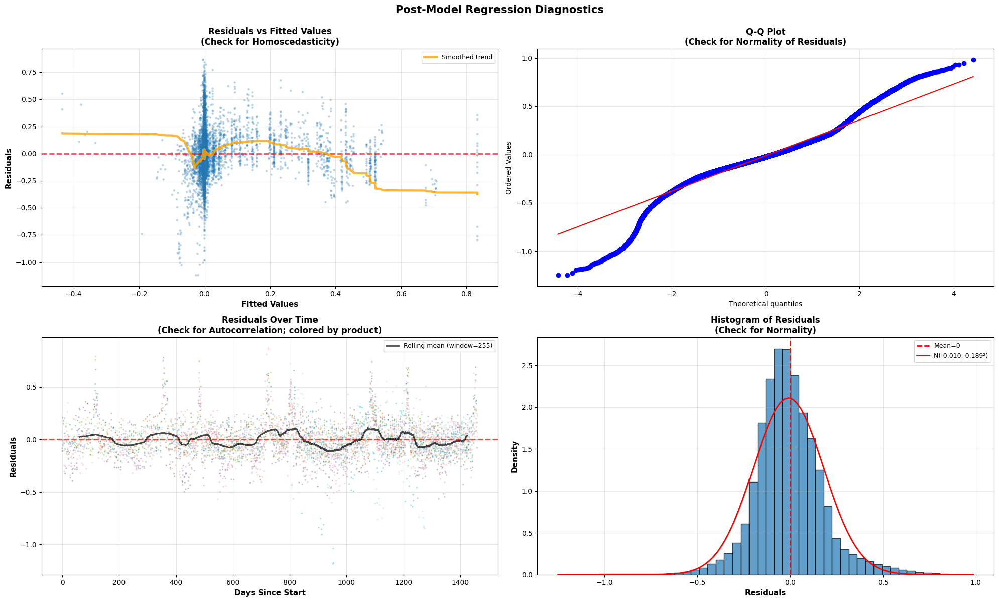


REGRESSION DIAGNOSTIC TESTS

1. AUTOCORRELATION (Durbin-Watson Test):
   Durbin-Watson statistic: 0.437
   Interpretation: 2.0 = no autocorrelation
                  <1.0 or >3.0 = concerning positive/negative autocorrelation
   → WARNING: Strong positive autocorrelation detected

2. NORMALITY OF RESIDUALS (Shapiro-Wilk Test):
   (Testing on random sample of 5,000 residuals)
   Shapiro-Wilk statistic: 0.9537
   P-value: 0.0000
   → WARNING: Residuals are NOT normally distributed (p < 0.05)
   → Consider: Robust standard errors or transformation

3. MULTICOLLINEARITY (Variance Inflation Factors):
   Computing VIF for 15 features...
   → OK: No features with VIF > 10

   Top features by VIF:
            Feature  VIF
 Product_2_LogPrice  1.0
 Product_1_LogPrice  1.0
 Product_3_LogPrice  1.0
Product_10_LogPrice  1.0
Product_14_LogPrice  1.0
 Product_0_LogPrice  1.0
 Product_4_LogPrice  1.0
 Product_5_LogPrice  1.0
 Product_8_LogPrice  1.0
 Product_9_LogPrice  1.0

4. HOMOSCEDASTICITY:
   

In [13]:
# Post-Model Regression Diagnostics
# Check residuals and model assumptions AFTER fitting

fig, axes = plt.subplots(2, 2, figsize=(20, 12))

# 1. RESIDUALS VS FITTED (Homoscedasticity)
ax = axes[0, 0]
sample_size = min(10000, len(results.resid))
sample_indices = np.random.choice(len(results.resid), sample_size, replace=False)

ax.scatter(results.fittedvalues.iloc[sample_indices], results.resid.iloc[sample_indices], 
           alpha=0.3, s=10, edgecolors='none')
ax.axhline(y=0, color='red', linestyle='--', linewidth=2, alpha=0.7)

# Add smooth trend line to detect patterns
from scipy.ndimage import uniform_filter1d
sorted_idx = np.argsort(results.fittedvalues.iloc[sample_indices])
x_sorted = results.fittedvalues.iloc[sample_indices].values[sorted_idx]
y_sorted = results.resid.iloc[sample_indices].values[sorted_idx]
if len(x_sorted) > 100:
    window = len(x_sorted) // 20
    y_smooth = uniform_filter1d(y_sorted, size=window, mode='nearest')
    ax.plot(x_sorted, y_smooth, 'orange', linewidth=3, label='Smoothed trend', alpha=0.8)

ax.set_xlabel('Fitted Values', fontsize=11, fontweight='bold')
ax.set_ylabel('Residuals', fontsize=11, fontweight='bold')
ax.set_title('Residuals vs Fitted Values\n(Check for Homoscedasticity)', fontsize=12, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3)

# 2. Q-Q PLOT (Normality of Residuals)
ax = axes[0, 1]
stats.probplot(results.resid, dist="norm", plot=ax)
ax.set_title('Q-Q Plot\n(Check for Normality of Residuals)', fontsize=12, fontweight='bold')
ax.grid(True, alpha=0.3)

# 3. RESIDUALS OVER TIME (Autocorrelation)
ax = axes[1, 0]
valid_data_with_resid = valid_data.copy()
valid_data_with_resid['residuals'] = results.resid.values

time_sample_size = min(5000, len(valid_data_with_resid))
time_sample = valid_data_with_resid.sort_values('days_since_start').iloc[::len(valid_data_with_resid)//time_sample_size]

scatter = ax.scatter(time_sample['days_since_start'], time_sample['residuals'],
                    c=time_sample['product'], cmap='tab20', alpha=0.4, s=5, edgecolors='none')
ax.axhline(y=0, color='red', linestyle='--', linewidth=2, alpha=0.7)

# Add rolling mean to detect autocorrelation
window_size = max(50, len(time_sample)//20)
if len(time_sample) >= window_size:
    rolling_mean = time_sample.set_index('days_since_start')['residuals'].rolling(
        window=window_size, center=True).mean()
    ax.plot(rolling_mean.index, rolling_mean.values, 'black', linewidth=2, 
            label=f'Rolling mean (window={window_size})', alpha=0.7)

ax.set_xlabel('Days Since Start', fontsize=11, fontweight='bold')
ax.set_ylabel('Residuals', fontsize=11, fontweight='bold')
ax.set_title('Residuals Over Time\n(Check for Autocorrelation; colored by product)', 
             fontsize=12, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3)

# 4. HISTOGRAM OF RESIDUALS (Normality)
ax = axes[1, 1]
ax.hist(results.resid, bins=50, edgecolor='black', alpha=0.7, density=True)
ax.axvline(x=0, color='red', linestyle='--', linewidth=2, label='Mean=0')

# Overlay normal distribution
mu, sigma = results.resid.mean(), results.resid.std()
x_norm = np.linspace(results.resid.min(), results.resid.max(), 100)
ax.plot(x_norm, stats.norm.pdf(x_norm, mu, sigma), 
        'r-', linewidth=2, label=f'N({mu:.3f}, {sigma:.3f}²)')

ax.set_xlabel('Residuals', fontsize=11, fontweight='bold')
ax.set_ylabel('Density', fontsize=11, fontweight='bold')
ax.set_title('Histogram of Residuals\n(Check for Normality)', fontsize=12, fontweight='bold')
ax.legend(fontsize=9)
ax.grid(True, alpha=0.3)

plt.suptitle('Post-Model Regression Diagnostics', 
             fontsize=15, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

# STATISTICAL TESTS
print("\n" + "="*80)
print("REGRESSION DIAGNOSTIC TESTS")
print("="*80)

# Durbin-Watson test for autocorrelation
dw_stat = durbin_watson(results.resid)
print(f"\n1. AUTOCORRELATION (Durbin-Watson Test):")
print(f"   Durbin-Watson statistic: {dw_stat:.3f}")
print(f"   Interpretation: 2.0 = no autocorrelation")
print(f"                  <1.0 or >3.0 = concerning positive/negative autocorrelation")
if dw_stat < 1.0:
    print(f"   → WARNING: Strong positive autocorrelation detected")
elif dw_stat > 3.0:
    print(f"   → WARNING: Strong negative autocorrelation detected")
elif 1.5 <= dw_stat <= 2.5:
    print(f"   → OK: No significant autocorrelation")
else:
    print(f"   → CAUTION: Mild autocorrelation present")

# Shapiro-Wilk test for normality (on sample if data is large)
print(f"\n2. NORMALITY OF RESIDUALS (Shapiro-Wilk Test):")
if len(results.resid) > 5000:
    sample_resid = np.random.choice(results.resid, 5000, replace=False)
    print(f"   (Testing on random sample of 5,000 residuals)")
else:
    sample_resid = results.resid
    
shapiro_stat, shapiro_p = stats.shapiro(sample_resid)
print(f"   Shapiro-Wilk statistic: {shapiro_stat:.4f}")
print(f"   P-value: {shapiro_p:.4f}")
if shapiro_p < 0.05:
    print(f"   → WARNING: Residuals are NOT normally distributed (p < 0.05)")
    print(f"   → Consider: Robust standard errors or transformation")
else:
    print(f"   → OK: Residuals appear normally distributed (p ≥ 0.05)")

# VIF for multicollinearity
print(f"\n3. MULTICOLLINEARITY (Variance Inflation Factors):")
print(f"   Computing VIF for {X.shape[1]} features...")

vif_data = pd.DataFrame()
vif_data["Feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

# Show only high VIF features or top 15
high_vif = vif_data[vif_data['VIF'] > 10].sort_values('VIF', ascending=False)
if len(high_vif) > 0:
    print(f"\n   Features with VIF > 10 (indicating high multicollinearity):")
    print(high_vif.to_string(index=False))
    print(f"\n   → WARNING: {len(high_vif)} features have high multicollinearity")
else:
    print(f"   → OK: No features with VIF > 10")
    print(f"\n   Top features by VIF:")
    print(vif_data.nlargest(10, 'VIF').to_string(index=False))

# Homoscedasticity (Breusch-Pagan test would go here, but visual inspection is often sufficient)
print(f"\n4. HOMOSCEDASTICITY:")
print(f"   Residual standard deviation: {results.resid.std():.4f}")
print(f"   → Check 'Residuals vs Fitted' plot for fan/funnel patterns")
print(f"   → If heteroscedasticity present, consider robust standard errors")

# Model fit summary
print(f"\n5. OVERALL MODEL FIT:")
print(f"   R²: {results.rsquared:.4f}")
print(f"   Adjusted R²: {results.rsquared_adj:.4f}")
print(f"   F-statistic: {results.fvalue:.2f}")
print(f"   Prob (F-statistic): {results.f_pvalue:.4e}")
print(f"   AIC: {results.aic:.2f}")
print(f"   BIC: {results.bic:.2f}")

print("="*80 + "\n")

## Takeaways

All the products are relatively inelastic to price, which is what we expected after visual inspection. The one major exception is product 14, for which a 1% increase in price leads to a 1.12% decrease in sales.

We will still leverage prices in the forecasting, but will mostly focus on trends, seasonality, and exploiting the covariance structure of the panel data.

---

# Modeling Strategy

## Overview: From Classical to Modern Deep Learning

Based on the EDA findings, we design a **progressive modeling strategy** that systematically increases complexity.

### 1. **Baseline: SARIMA (Seasonal ARIMA)**
- **Type**: Classical univariate time series model
- **Rationale**: Establishes a defensible baseline using well-understood statistical methods. SARIMA models each shop-product series independently, making them interpretable and computationally efficient.
- **Key limitation**: Ignores cross-sectional dependencies between products and shops that EDA revealed to be substantial.

### 2. **Interpretable ML: Prophet**
- **Type**: Additive regression model with explicit seasonality
- **Rationale**: Provides a bridge between classical statistics and modern ML. Prophet's decomposition into trend + seasonality + holidays offers interpretability while incorporating domain knowledge (weekly/yearly cycles, holiday effects).
- **Key advancement**: Explicit handling of multiple seasonality scales (daily, weekly, yearly) and outlier-robust trend estimation.
- **Tuning approach**: Hyperparameter optimization via Optuna with time series cross-validation to prevent data leakage.

### 3. **Transfer Learning: Chronos-2**
- **Type**: Pretrained transformer foundation model
- **Rationale**: Leverages transfer learning from a model pretrained on thousands of diverse time series. This is particularly valuable given our relatively short historical window (2 years).
- **Two-stage approach**:
  - **Zero-shot inference**: Tests the model's out-of-the-box performance without any domain-specific training
  - **Fine-tuning**: Adapts the pretrained weights to our specific grocery sales patterns
- **Key advancement**: Can learn from limited data by transferring knowledge from pretraining corpus.

### 4. **State-of-the-Art: TFT (Temporal Fusion Transformer)**
- **Type**: Global multivariate deep learning model with attention mechanisms
- **Rationale**: Directly addresses the cross-sectional dependency structure identified in EDA. Unlike local models (SARIMA, Prophet) that treat each series independently, TFT learns a **single global model** across all 150 shop-product combinations.
- **Key capabilities**:
  - **Multi-horizon forecasting**: Natively predicts entire future sequences (61 days)
  - **Attention mechanisms**: Learns which historical time steps and which covariates matter most
  - **Static + future covariates**: Incorporates shop/product embeddings (static) and time-varying features (prices, calendar effects)
  - **Probabilistic forecasts**: Outputs quantiles (5th, 50th, 95th percentiles) for uncertainty quantification
- **Key advancement**: Exploits the panel structure — a sales spike in one product can inform predictions for correlated products.

## Validation Philosophy

**Held-out validation period**: December 2021 is reserved exclusively for validation, never used for training. This mimics real-world deployment where we must forecast one month ahead.

**Metrics tracked**:
- **MAE** (Mean Absolute Error): Interpretable in original sales units
- **RMSE** (Root Mean Squared Error): Penalizes large errors more heavily
- **MAPE** (Mean Absolute Percentage Error): Scale-independent, useful for comparing products with different sales volumes
- **R²**: Captures proportion of variance explained

---

# SARIMA Model

## Classical Baseline: Seasonal ARIMA

**Model Type**: Univariate autoregressive model with seasonal components

### Specification: SARIMAX(1,1,1)(1,1,1,7)

$$
\nabla \nabla_7 y_t = \phi_1 \nabla \nabla_7 y_{t-1} + \theta_1 \epsilon_{t-1} + \Phi_1 \epsilon_{t-7} + \Theta_1 \epsilon_{t-8} + \epsilon_t
$$

**Notation**:
- $\nabla$: First-difference operator (removes level trends)
- $\nabla_7$: Seasonal difference at lag 7 (removes weekly seasonality)
- $\phi_1$: AR(1) coefficient (captures autocorrelation)
- $\theta_1$: MA(1) coefficient (captures moving average pattern)
- $\Phi_1, \Theta_1$: Seasonal AR/MA coefficients (captures weekly patterns)

### Design Choices

1. **Product-level aggregation**: Sum across all shops for each product
   - **Why**: Simplifies to 15 series instead of 150, making SARIMA computationally tractable
   - **Tradeoff**: Loses shop-specific patterns and cross-sectional dependencies

2. **Weekly seasonality (s=7)**: Hardcoded based on EDA findings
   - Saturday/Sunday sales spikes are consistent across all products
   - PACF analysis showed strong lag-7 autocorrelation

3. **No exogenous variables**: Pure time series approach
   - **Why**: Establishes clean baseline before adding covariates
   - **Limitation**: Ignores price variation (though elasticity is low)

### Expected Performance

- **Strengths**: Captures weekly patterns, computationally efficient, interpretable
- **Weaknesses**: Misses cross-sectional dependencies, can't leverage shop-specific information, struggles with non-stationary trends

In [14]:
# SARIMA Baseline - Simple seasonal model for comparison

sarima_models = {}
sarima_forecasts = {}

# Train SARIMA for each product (simplified - no shop effects)
for product in sorted(train_df['product'].unique()):
    # Aggregate daily sales across all shops for this product
    product_data = train_df[train_df['product'] == product].groupby('date')['sales'].sum().reset_index()
    product_data = product_data.set_index('date').asfreq('D', fill_value=0)
    
    try:
        # Fit SARIMA model with weekly seasonality
        # (p,d,q)(P,D,Q,s) = (1,1,1)(1,1,1,7)
        model = SARIMAX(
            product_data['sales'],
            order=(1, 1, 1),          # AR(1), I(1), MA(1)
            seasonal_order=(1, 1, 1, 7),  # Weekly seasonality
            enforce_stationarity=False,
            enforce_invertibility=False
        )
        
        fitted_model = model.fit(disp=False, maxiter=100)
        sarima_models[product] = fitted_model
        
        # Forecast December 2021 (31 days)
        forecast = fitted_model.forecast(steps=31)
        sarima_forecasts[product] = forecast
        
        print(f"Product {product}: AIC={fitted_model.aic:.1f}, BIC={fitted_model.bic:.1f}")
        
    except Exception as e:
        print(f"Product {product}: Failed to fit - {str(e)[:50]}")
        sarima_models[product] = None

print(f"\n✓ Successfully trained SARIMA models for {len([m for m in sarima_models.values() if m is not None])} products")
print("="*80)

Product 0: AIC=16776.2, BIC=16802.6
Product 1: AIC=20665.9, BIC=20692.3
Product 1: AIC=20665.9, BIC=20692.3
Product 2: AIC=17086.7, BIC=17113.1
Product 2: AIC=17086.7, BIC=17113.1
Product 3: AIC=19183.1, BIC=19209.5
Product 3: AIC=19183.1, BIC=19209.5
Product 4: AIC=23043.7, BIC=23070.1
Product 4: AIC=23043.7, BIC=23070.1
Product 5: AIC=21026.4, BIC=21052.8
Product 5: AIC=21026.4, BIC=21052.8
Product 6: AIC=20947.4, BIC=20973.8
Product 6: AIC=20947.4, BIC=20973.8
Product 7: AIC=20648.4, BIC=20674.8
Product 7: AIC=20648.4, BIC=20674.8
Product 8: AIC=19832.2, BIC=19858.6
Product 8: AIC=19832.2, BIC=19858.6
Product 9: AIC=19682.0, BIC=19708.3
Product 9: AIC=19682.0, BIC=19708.3
Product 10: AIC=20072.0, BIC=20098.3
Product 10: AIC=20072.0, BIC=20098.3
Product 11: AIC=19991.0, BIC=20017.4
Product 11: AIC=19991.0, BIC=20017.4
Product 12: AIC=19916.1, BIC=19942.5
Product 12: AIC=19916.1, BIC=19942.5
Product 13: AIC=21414.6, BIC=21440.8
Product 13: AIC=21414.6, BIC=21440.8
Product 14: AIC=2111

## Validation

Evaluate SARIMA baseline performance on a held-out validation set (November 2021) to compare with Prophet model.

Training SARIMA on data through November 2021 (tuning set)...
✓ Trained 15 models

✓ Trained 15 models

SARIMA BASELINE - VALIDATION SET EVALUATION
MAE:  1065.849
RMSE: 1749.465
MAPE: 20.58%
R²:   0.7752
SARIMA BASELINE - VALIDATION SET EVALUATION
MAE:  1065.849
RMSE: 1749.465
MAPE: 20.58%
R²:   0.7752


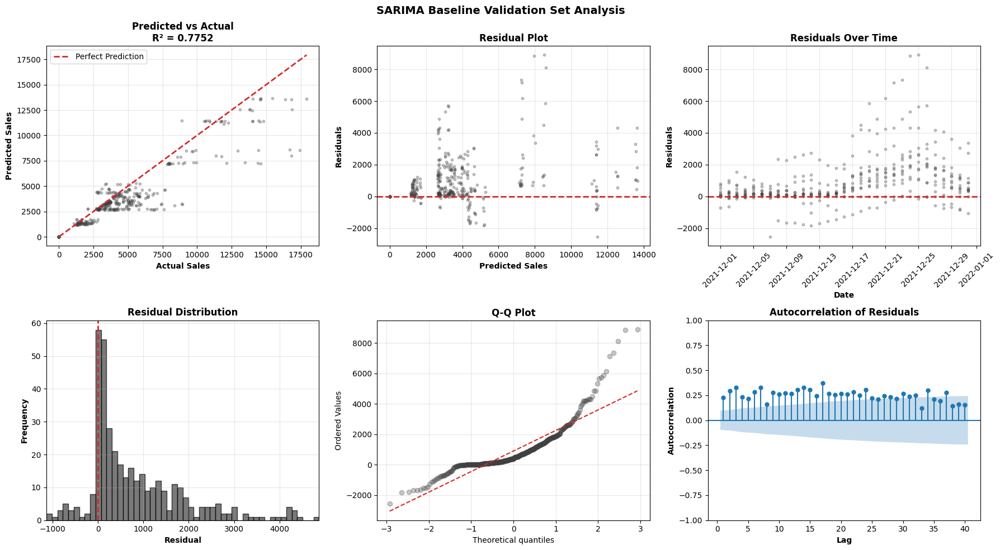

In [15]:
# Use validation flag to split data
sarima_train_split = train_df[~train_df['is_validation']]  # Jan 2018 - Nov 2021
sarima_val_split = train_df[train_df['is_validation']]     # Dec 2021

# Train SARIMA models on tuning data and forecast December
sarima_val_models = {}
sarima_val_forecasts = {}

print("Training SARIMA on data through November 2021 (tuning set)...")
for product in sorted(train_df['product'].unique()):
    # Aggregate daily sales for training through November
    product_data = sarima_train_split[sarima_train_split['product'] == product].groupby('date')['sales'].sum().reset_index()
    product_data = product_data.set_index('date').asfreq('D', fill_value=0)
    
    try:
        model = SARIMAX(
            product_data['sales'],
            order=(1, 1, 1),
            seasonal_order=(1, 1, 1, 7),
            enforce_stationarity=False,
            enforce_invertibility=False
        )
        
        fitted_model = model.fit(disp=False, maxiter=100)
        sarima_val_models[product] = fitted_model
        
        # Forecast December 2021 (31 days)
        forecast = fitted_model.forecast(steps=31)
        sarima_val_forecasts[product] = forecast
        
    except Exception as e:
        sarima_val_models[product] = None

print(f"✓ Trained {len([m for m in sarima_val_models.values() if m is not None])} models\n")

# Collect predictions and actuals for validation period
sarima_val_predictions = []
sarima_val_actuals = []
sarima_val_dates = []

for product in sorted(sarima_val_models.keys()):
    if sarima_val_models[product] is None:
        continue
    
    # Get validation data for this product (December 2021)
    product_val = sarima_val_split[sarima_val_split['product'] == product].groupby('date')['sales'].sum().reset_index()
    product_val = product_val.set_index('date').asfreq('D', fill_value=0)
    
    # Get forecasts for validation period
    if product in sarima_val_forecasts:
        forecast = sarima_val_forecasts[product].values
        
        # Match forecasts with actuals
        n_days = min(len(forecast), len(product_val))
        for i in range(n_days):
            sarima_val_predictions.append(max(0, forecast[i]))
            sarima_val_actuals.append(product_val['sales'].iloc[i])
            sarima_val_dates.append(product_val.index[i])

sarima_val_predictions = np.array(sarima_val_predictions)
sarima_val_actuals = np.array(sarima_val_actuals)

# Calculate validation metrics with naive baseline comparison
# Note: SARIMA aggregates by product only (not by shop-product), so we need to expand validation data
sarima_val_df_expanded = []
for product in sorted(train_df['product'].unique()):
    product_val_data = sarima_val_split[sarima_val_split['product'] == product]
    for _, row in product_val_data.iterrows():
        sarima_val_df_expanded.append(row)
sarima_val_df_expanded = pd.DataFrame(sarima_val_df_expanded) if sarima_val_df_expanded else sarima_val_split.copy()

sarima_metrics = validation_metrics(
    actuals=sarima_val_actuals,
    predictions=sarima_val_predictions,
    model_name="SARIMA Baseline",
    train_df=sarima_train_split,
    validation_df=sarima_val_df_expanded,
    naive_window_days=60  # SARIMA uses 60-day window
)

# Plot residual diagnostics
plot_residual_diagnostics(
    actuals=sarima_val_actuals,
    predictions=sarima_val_predictions,
    model_name="SARIMA Baseline",
    r2_score_val=sarima_metrics['r2'],
    dates=sarima_val_dates
)

---

# Prophet Model

## Why Prophet After SARIMA?

SARIMA provided a solid baseline but has key limitations:
1. **Inflexible seasonality**: Hardcoded weekly patterns can't adapt to product-specific seasonal profiles
2. **No covariates**: Can't incorporate price or shop-level information
3. **Stationarity assumptions**: Struggles with complex trend changes

**Prophet addresses these limitations** while maintaining interpretability.

---

## Model Architecture: Additive Decomposition

Prophet uses an **additive model** structure:

$$y(t) = g(t) + s(t) + h(t) + \epsilon_t$$

Where:
- $g(t)$: **Piecewise linear trend** with automatic changepoint detection
- $s(t)$: **Periodic seasonality** using Fourier series (weekly + yearly)
- $h(t)$: **Holiday effects** (custom holiday calendar)
- $\epsilon_t$: **Error term** (assumed Gaussian, but robust to outliers via Huber loss)

### Key Technical Features

**1. Trend Flexibility**
- **Automatic changepoint detection**: Identifies structural breaks in trend
- **Regularization**: `changepoint_prior_scale` controls sensitivity (higher = more flexible)
- **Capacity bounds**: Can specify growth limits if domain knowledge suggests saturation

**2. Multi-Scale Seasonality**
- **Weekly**: Captures weekend spikes (Fourier order controls smoothness)
- **Yearly**: Captures holiday months (March-May, Oct-Dec peaks)
- **Fourier series**: Smooth, periodic basis functions avoid overfitting to noise

**3. Covariate Integration**
- **Shop indicators**: One-hot encoded categorical regressors
- **Price**: Current price as numeric regressor
- **Lagged prices**: 1-day and 7-day lags capture delayed price effects
- **Regressor prior scale**: Controls how strongly regressors influence predictions

**4. Robust Estimation**
- **Outlier handling**: Can use Student-t likelihood for heavy-tailed residuals
- **Missing data**: Gracefully handles gaps in time series

### Hyperparameter Tuning Strategy

Instead of manual selection, I use **Optuna** for automated hyperparameter optimization:

**Search Space**:
- `changepoint_prior_scale`: [0.001, 1.0] — Trend flexibility
- `seasonality_prior_scale`: [0.01, 100.0] — Seasonality strength
- `holidays_prior_scale`: [0.01, 100.0] — Holiday effect magnitude
- `seasonality_mode`: {additive, multiplicative} — How seasonality combines with trend
- `weekly_fourier_order`: [3, 10] — Weekly pattern smoothness
- `yearly_fourier_order`: [5, 20] — Yearly pattern smoothness

**Optimization Procedure**:
1. **Per-product tuning**: Each product gets its own hyperparameter set (15 separate studies)
2. **Time series CV**: Optuna objective uses Prophet's built-in cross-validation (expanding window)
3. **Metric**: Minimize MAPE on cross-validation folds
4. **Trials**: 40 trials per product with MedianPruner for early stopping
5. **Parallelization**: 4 workers for computational efficiency

**Why per-product tuning?**
- Products have heterogeneous seasonal patterns (EDA revealed distinct product clusters)
- One-size-fits-all hyperparameters would underfit this diversity
- Computational cost is manageable (15 products × 40 trials = 600 total, parallelized)

---

## Data Preparation 

Prophet requires data in a specific format with `ds` (datestamp) and `y` (value) columns. We'll prepare the data with shop as a categorical regressor along with price, using one model per product.

In [16]:
# Prepare data for Prophet
# Prophet requires 'ds' (datetime) and 'y' (value) columns

# Prepare training data
prophet_train = train_df.copy()
prophet_train['ds'] = prophet_train['date']
prophet_train['y'] = prophet_train['sales']
prophet_train['price'] = prophet_train['price']

# Sort by shop, product, date to ensure proper lag calculation
prophet_train = prophet_train.sort_values(['shop', 'product', 'date'])

# Create lagged price features (1 day and 7 day lags)
prophet_train['price_lag_1'] = prophet_train.groupby(['shop', 'product'])['price'].shift(1)
prophet_train['price_lag_7'] = prophet_train.groupby(['shop', 'product'])['price'].shift(7)

# Fill NaN values for lagged features with the current price (forward fill within group)
prophet_train['price_lag_1'] = prophet_train.groupby(['shop', 'product'])['price_lag_1'].fillna(method='bfill')
prophet_train['price_lag_7'] = prophet_train.groupby(['shop', 'product'])['price_lag_7'].fillna(method='bfill')

# One-hot encode shop for categorical treatment (using pandas)
# Get the raw shop IDs (integers) from the original dataframe
unique_shops = sorted(train_df['shop'].unique())

# Create shop indicator columns
for shop in unique_shops:
    prophet_train[f'shop_{shop}'] = (prophet_train['shop'] == shop).astype(int)

# Prepare test data with same encoding
prophet_test = test_df.copy()
prophet_test['ds'] = prophet_test['date']
prophet_test['price'] = prophet_test['price']

# Sort test data for proper lag calculation
prophet_test = prophet_test.sort_values(['shop', 'product', 'date'])

# For test data, we need to create lagged features using the last values from training
# Combine train and test temporarily to calculate lags properly
combined = pd.concat([
    train_df[['shop', 'product', 'date', 'price']].assign(split='train'),
    test_df[['shop', 'product', 'date', 'price']].assign(split='test')
], ignore_index=True).sort_values(['shop', 'product', 'date'])

# Calculate lags on combined data
combined['price_lag_1'] = combined.groupby(['shop', 'product'])['price'].shift(1)
combined['price_lag_7'] = combined.groupby(['shop', 'product'])['price'].shift(7)

# Extract test data lags
test_lags = combined[combined['split'] == 'test'][['shop', 'product', 'date', 'price_lag_1', 'price_lag_7']]

# Merge lags into prophet_test
prophet_test = prophet_test.merge(
    test_lags,
    on=['shop', 'product', 'date'],
    how='left'
)

# Fill any remaining NaN values in test set with current price
prophet_test['price_lag_1'] = prophet_test['price_lag_1'].fillna(prophet_test['price'])
prophet_test['price_lag_7'] = prophet_test['price_lag_7'].fillna(prophet_test['price'])

# One-hot encode shop for test data
for shop in unique_shops:
    prophet_test[f'shop_{shop}'] = (prophet_test['shop'] == shop).astype(int)

# Create shop_cols list for easy reference
shop_cols = [f'shop_{s}' for s in unique_shops]

# Get unique products (we'll train one model per product)
products = sorted(prophet_train['product'].unique())

In [17]:
def create_prophet_model(params, shop_cols):
    """
    Create and configure a Prophet model with given hyperparameters.
    
    Parameters:
    - params: Dictionary of hyperparameters
    - shop_cols: List of shop column names to add as regressors
    
    Returns:
    - Configured Prophet model (not yet fitted)
    """
    # Create Prophet model with core hyperparameters
    model = Prophet(
        changepoint_prior_scale=params['changepoint_prior_scale'],
        seasonality_prior_scale=params['seasonality_prior_scale'],
        holidays_prior_scale=params['holidays_prior_scale'],
        seasonality_mode=params['seasonality_mode'],
        changepoint_range=params['changepoint_range'],
        yearly_seasonality=False,
        weekly_seasonality=False,
        daily_seasonality=False
    )
    
    # Add custom seasonalities with Fourier orders
    model.add_seasonality(
        name='yearly',
        period=365.25,
        fourier_order=params['yearly_seasonality_fourier']
    )
    model.add_seasonality(
        name='weekly',
        period=7,
        fourier_order=params['weekly_seasonality_fourier']
    )
    
    # Add shop regressors
    for shop_col in shop_cols:
        model.add_regressor(shop_col)
    
    # Add price regressors
    model.add_regressor('price')
    model.add_regressor('price_lag_1')
    model.add_regressor('price_lag_7')
    
    return model

## Hyperparameter Tuning

Use Optuna to find optimal hyperparameters for each product. We'll use Prophet's built-in cross-validation with a time series split strategy to evaluate different parameter combinations and minimize MAE.

**Computational structure:**
1. **Products Loop** (sequential): One product at a time
2. **Optuna Trials Loop** (parallel workers): 40 trials per product, 4 running in parallel 
3. **Prophet CV Folds Loop** (sequential): ~4 rolling time-series folds per trial (60-day windows)

In [18]:
# Suppress cmdstanpy logging
logging.getLogger('cmdstanpy').setLevel(logging.ERROR)
logging.getLogger('cmdstanpy').disabled = True

def objective_per_product(trial, product_id, train_data):
    """
    Objective function for Optuna hyperparameter optimization per product.
    Uses Prophet's built-in cross_validation for robust time-series evaluation with multiple rolling windows.
    NOTE: train_data should already be filtered to exclude validation set (is_validation=False)
    """
    
    # Define search space for hyperparameters
    params = {
        'changepoint_prior_scale': trial.suggest_float('changepoint_prior_scale', 0.001, 0.5, log=True),
        'seasonality_prior_scale': trial.suggest_float('seasonality_prior_scale', 0.01, 10, log=True),
        'holidays_prior_scale': trial.suggest_float('holidays_prior_scale', 0.01, 10, log=True),
        'seasonality_mode': trial.suggest_categorical('seasonality_mode', ['additive', 'multiplicative']),
        'changepoint_range': trial.suggest_float('changepoint_range', 0.8, 0.95),
        'yearly_seasonality_fourier': trial.suggest_int('yearly_seasonality_fourier', 3, 15),
        'weekly_seasonality_fourier': trial.suggest_int('weekly_seasonality_fourier', 2, 10)
    }
    
    try:
        # Filter data for this product
        product_data = train_data[train_data['product'] == product_id][['ds', 'y', 'price', 'price_lag_1', 'price_lag_7'] + shop_cols].copy()
        
        # Calculate UNIQUE days (product data has one row per shop per day)
        data_days = product_data['ds'].nunique()  # Count unique dates, not rows!
        horizon_days = 60  # Match test period
        
        # Need enough data: initial + horizon + at least 1 period
        min_days_needed = horizon_days * 3  # 180 days minimum
        if data_days < min_days_needed:
            return 1e6
        
        # Calculate initial period: use 60% of available data (leaving 40% for CV folds)
        initial_days = int(data_days * 0.6)
        initial_str = f'{initial_days} days'
            
        # Train model on full product data
        model_cv = create_prophet_model(params, shop_cols)
        
        # Suppress Prophet output without causing I/O errors
        import sys
        old_stdout = sys.stdout
        old_stderr = sys.stderr
        try:
            sys.stdout = StringIO()
            sys.stderr = StringIO()
            model_cv.fit(product_data)
        finally:
            sys.stdout = old_stdout
            sys.stderr = old_stderr
        
        # Use Prophet's cross_validation with rolling windows
        # initial: adaptive based on data span, period: advance by 60 days, horizon: predict 60 days
        try:
            old_stdout = sys.stdout
            old_stderr = sys.stderr
            sys.stdout = StringIO()
            sys.stderr = StringIO()
            try:
                df_cv = cross_validation(
                    model_cv,
                    initial=initial_str,  # Adaptive: 60% of data
                    period='60 days',     # Move forward 60 days each fold
                    horizon='60 days',    # Predict 60 days ahead (matches test period)
                    parallel='threads',
                    disable_tqdm=True
                )
            finally:
                sys.stdout = old_stdout
                sys.stderr = old_stderr
        except Exception as e:
            # CV failed
            return 1e6
        
        # Calculate performance metrics
        df_perf = performance_metrics(df_cv, rolling_window=0.1)  # Use rolling window for smoothing
        mean_mae = df_perf['mae'].mean()
        
        return mean_mae
        
    except Exception:
        return 1e6

In [19]:
# Run per-product hyperparameter optimization

# Restore stdout/stderr in case they were closed by previous cells
import sys
if sys.stdout.closed:
    sys.stdout = sys.__stdout__
if sys.stderr.closed:
    sys.stderr = sys.__stderr__

# Keep optuna progress bar but suppress other logging
optuna.logging.set_verbosity(optuna.logging.WARNING)

# Filter prophet_train to ONLY tuning data (exclude validation set)
prophet_train_tuning = prophet_train[~prophet_train['is_validation']].copy()

# Get list of all products
product_ids = sorted(prophet_train['product'].unique())
n_trials = 40  # Number of trials per product
n_jobs = 4  # Number of parallel jobs for Optuna trials

# Store results
studies_by_product = {}
best_params_by_product = {}

# Use tqdm for overall product progress
for product_id in tqdm(product_ids, desc="Products", unit="product"):
    # Create or load study for this product
    study = optuna.create_study(
        study_name=f'prophet_product_{product_id}_tuning',
        storage='sqlite:///prophet_tuning.db',
        load_if_exists=True,
        direction='minimize',
        pruner=MedianPruner(n_startup_trials=3, n_warmup_steps=0)
    )
    
    # Check if we already have enough trials
    existing_trials = len(study.trials)
    trials_to_run = max(0, n_trials - existing_trials)
    
    if trials_to_run > 0:
        print(f"  Product {product_id}: Running {trials_to_run} additional trials ({existing_trials} existing)")
        # Run optimization with parallel trials and progress bar - using TUNING data only
        study.optimize(
            lambda trial: objective_per_product(trial, product_id, prophet_train_tuning),
            n_trials=trials_to_run,
            n_jobs=n_jobs,
            show_progress_bar=True
        )
    else:
        print(f"  Product {product_id}: Skipping - already has {existing_trials} trials")
    
    # Store results
    studies_by_product[product_id] = study
    best_params_by_product[product_id] = study.best_params

Products:   0%|          | 0/15 [00:00<?, ?product/s]

  Product 0: Skipping - already has 40 trials
  Product 1: Skipping - already has 40 trials
  Product 2: Skipping - already has 40 trials
  Product 3: Skipping - already has 40 trials
  Product 4: Skipping - already has 40 trials
  Product 5: Skipping - already has 40 trials
  Product 6: Skipping - already has 40 trials
  Product 7: Skipping - already has 40 trials
  Product 8: Skipping - already has 40 trials
  Product 9: Skipping - already has 40 trials
  Product 10: Skipping - already has 40 trials
  Product 11: Skipping - already has 40 trials
  Product 12: Skipping - already has 40 trials
  Product 13: Skipping - already has 40 trials
  Product 14: Skipping - already has 40 trials
  Product 4: Skipping - already has 40 trials
  Product 5: Skipping - already has 40 trials
  Product 6: Skipping - already has 40 trials
  Product 7: Skipping - already has 40 trials
  Product 8: Skipping - already has 40 trials
  Product 9: Skipping - already has 40 trials
  Product 10: Skipping - alre

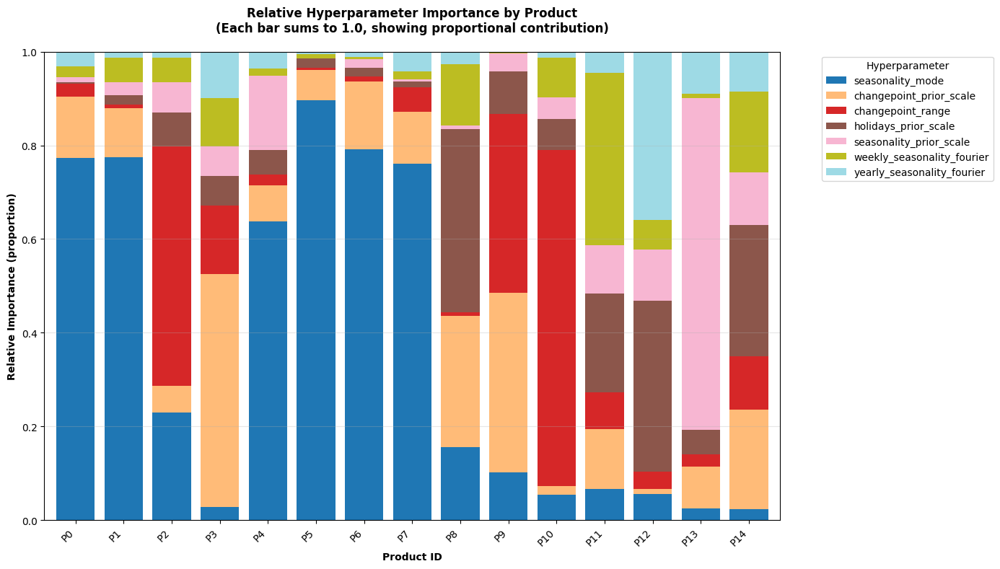

In [20]:
# Analyze hyperparameter importance across products
importance_data = []
for product_id, study in studies_by_product.items():
    importances = optuna.importance.get_param_importances(study)
    for param, importance in importances.items():
        importance_data.append({
            'product': product_id,
            'parameter': param,
            'importance': importance
        })

importance_df = pd.DataFrame(importance_data)

# Pivot to get importance matrix (products × parameters)
importance_pivot = importance_df.pivot(index='product', columns='parameter', values='importance').fillna(0)

# Define parameter order for consistent visualization
param_order = importance_pivot.sum(axis=0).sort_values(ascending=False).index

# Stacked Bar Chart - Relative Importance by Product
fig, ax = plt.subplots(figsize=(14, 8))

# Normalize importances for each product (to show relative importance)
importance_pivot_norm = importance_pivot.div(importance_pivot.sum(axis=1), axis=0)

# Sort products by ID for cleaner visualization
importance_pivot_norm_sorted = importance_pivot_norm.sort_index()

# Create stacked bar chart
importance_pivot_norm_sorted[param_order].plot(
    kind='bar',
    stacked=True,
    ax=ax,
    colormap='tab20',
    width=0.8
)

# Customize
ax.set_xlabel('Product ID', fontweight='bold')
ax.set_ylabel('Relative Importance (proportion)', fontweight='bold')
ax.set_title('Relative Hyperparameter Importance by Product\n(Each bar sums to 1.0, showing proportional contribution)', 
             pad=20, fontweight='bold')
ax.set_xticklabels([f"P{p}" for p in importance_pivot_norm_sorted.index], rotation=45, ha='right')
ax.legend(title='Hyperparameter', bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True)
ax.set_ylim(0, 1)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()


Best MAE by Product:
 product   best_mae  n_trials
       0  51.598989        40
       1 179.523699        40
       2  49.930102        40
       3  96.507575        40
       4 493.682707        40
       5 163.667693        40
       6 176.544514        40
       7 160.260911        40
       8 106.635425        40
       9 116.718898        40
      10 122.881100        40
      11 107.460051        40
      12 118.147382        40
      13 320.064912        40
      14 233.599078        40

Average MAE across all products: 166.48
Median MAE across all products: 122.88


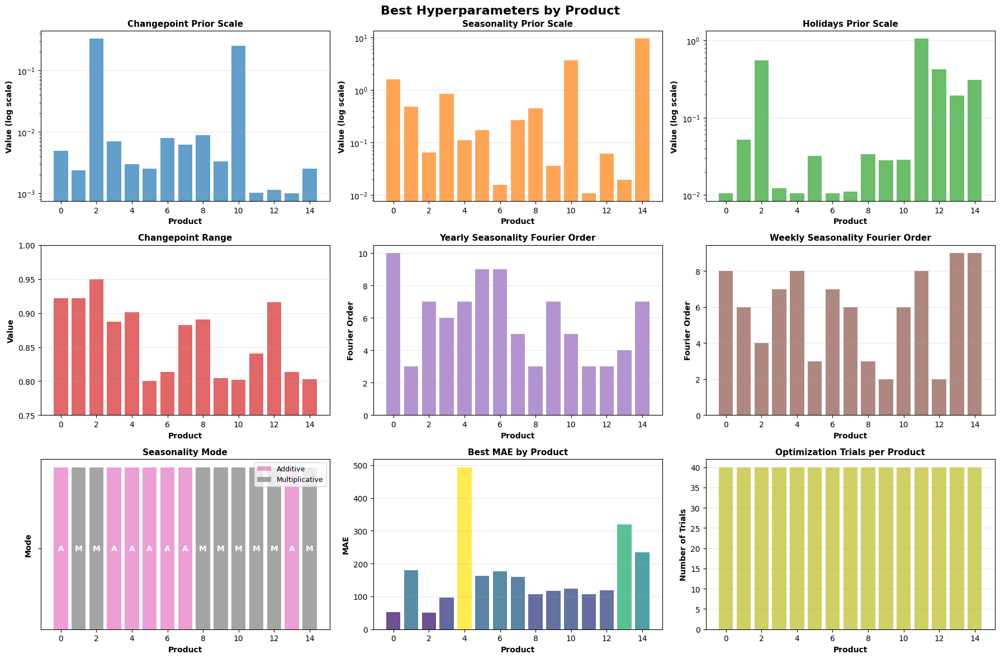

In [21]:
# Visualize optimization results summary

# Create a summary of best MAE and hyperparameters by product
summary_data = []
for product_id, study in studies_by_product.items():
    params = best_params_by_product[product_id]
    summary_data.append({
        'product': product_id,
        'best_mae': study.best_value,
        'n_trials': len(study.trials),
        'changepoint_prior_scale': params['changepoint_prior_scale'],
        'seasonality_prior_scale': params['seasonality_prior_scale'],
        'holidays_prior_scale': params['holidays_prior_scale'],
        'seasonality_mode': params['seasonality_mode'],
        'changepoint_range': params['changepoint_range'],
        'yearly_fourier': params['yearly_seasonality_fourier'],
        'weekly_fourier': params['weekly_seasonality_fourier']
    })

summary_df = pd.DataFrame(summary_data).sort_values('product')

print("\nBest MAE by Product:")
print(summary_df[['product', 'best_mae', 'n_trials']].to_string(index=False))
print(f"\nAverage MAE across all products: {summary_df['best_mae'].mean():.2f}")
print(f"Median MAE across all products: {summary_df['best_mae'].median():.2f}")

# Create visualization of best hyperparameters across products
fig, axes = plt.subplots(3, 3, figsize=(18, 12))
fig.suptitle('Best Hyperparameters by Product', fontsize=16, fontweight='bold')

# Use tab10 palette for consistency
param_colors = sns.color_palette("tab10", 9)

# 1. Changepoint Prior Scale
ax = axes[0, 0]
ax.bar(summary_df['product'], summary_df['changepoint_prior_scale'], color=param_colors[0], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Value (log scale)', fontsize=10, fontweight='bold')
ax.set_title('Changepoint Prior Scale', fontsize=11, fontweight='bold')
ax.set_yscale('log')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 2. Seasonality Prior Scale
ax = axes[0, 1]
ax.bar(summary_df['product'], summary_df['seasonality_prior_scale'], color=param_colors[1], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Value (log scale)', fontsize=10, fontweight='bold')
ax.set_title('Seasonality Prior Scale', fontsize=11, fontweight='bold')
ax.set_yscale('log')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 3. Holidays Prior Scale
ax = axes[0, 2]
ax.bar(summary_df['product'], summary_df['holidays_prior_scale'], color=param_colors[2], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Value (log scale)', fontsize=10, fontweight='bold')
ax.set_title('Holidays Prior Scale', fontsize=11, fontweight='bold')
ax.set_yscale('log')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 4. Changepoint Range
ax = axes[1, 0]
ax.bar(summary_df['product'], summary_df['changepoint_range'], color=param_colors[3], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Value', fontsize=10, fontweight='bold')
ax.set_title('Changepoint Range', fontsize=11, fontweight='bold')
ax.set_ylim([0.75, 1.0])
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 5. Yearly Seasonality Fourier Order
ax = axes[1, 1]
ax.bar(summary_df['product'], summary_df['yearly_fourier'], color=param_colors[4], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Fourier Order', fontsize=10, fontweight='bold')
ax.set_title('Yearly Seasonality Fourier Order', fontsize=11, fontweight='bold')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 6. Weekly Seasonality Fourier Order
ax = axes[1, 2]
ax.bar(summary_df['product'], summary_df['weekly_fourier'], color=param_colors[5], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Fourier Order', fontsize=10, fontweight='bold')
ax.set_title('Weekly Seasonality Fourier Order', fontsize=11, fontweight='bold')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 7. Seasonality Mode
ax = axes[2, 0]
mode_colors = [param_colors[6] if mode == 'additive' else param_colors[7] for mode in summary_df['seasonality_mode']]
ax.bar(summary_df['product'], [1]*len(summary_df), color=mode_colors, alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Mode', fontsize=10, fontweight='bold')
ax.set_title('Seasonality Mode', fontsize=11, fontweight='bold')
ax.set_yticks([0.5])
ax.set_yticklabels([''])
ax.legend(handles=[
    plt.Rectangle((0,0),1,1, fc=param_colors[6], alpha=0.7, label='Additive'),
    plt.Rectangle((0,0),1,1, fc=param_colors[7], alpha=0.7, label='Multiplicative')
], loc='upper right', fontsize=9)
for i, (product, mode) in enumerate(zip(summary_df['product'], summary_df['seasonality_mode'])):
    ax.text(product, 0.5, mode[0].upper(), ha='center', va='center', 
            fontweight='bold', fontsize=10, color='white')

# 8. Best MAE by Product
ax = axes[2, 1]
mae_colors = plt.cm.viridis(summary_df['best_mae'] / summary_df['best_mae'].max())
ax.bar(summary_df['product'], summary_df['best_mae'], color=mae_colors, alpha=0.8)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('MAE', fontsize=10, fontweight='bold')
ax.set_title('Best MAE by Product', fontsize=11, fontweight='bold')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

# 9. Number of Trials
ax = axes[2, 2]
ax.bar(summary_df['product'], summary_df['n_trials'], color=param_colors[8], alpha=0.7)
ax.set_xlabel('Product', fontsize=10, fontweight='bold')
ax.set_ylabel('Number of Trials', fontsize=10, fontweight='bold')
ax.set_title('Optimization Trials per Product', fontsize=11, fontweight='bold')
ax.grid(True, alpha=GRID_ALPHA, axis='y')

plt.tight_layout()
plt.show()


## Full Model

Train a model on the full training set with optimal hyperparameters

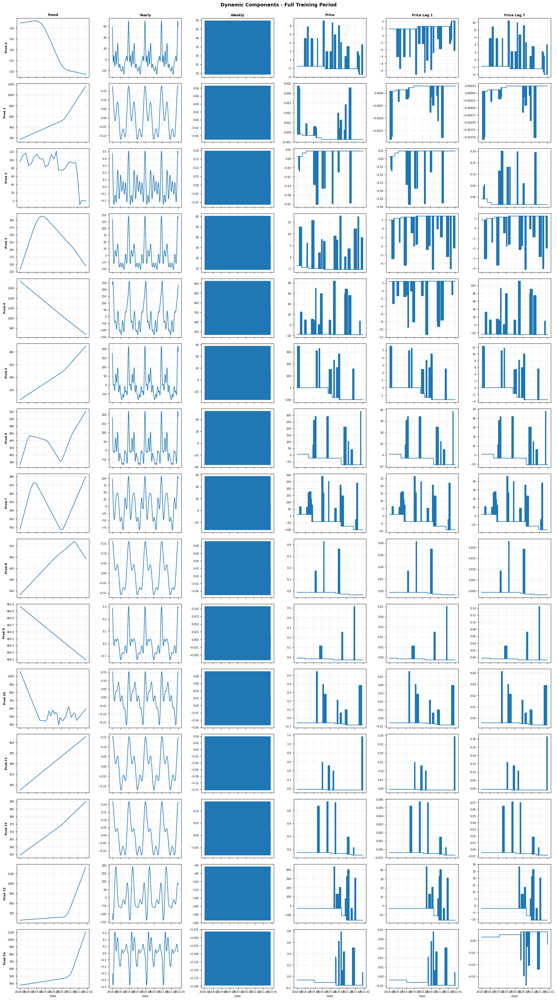

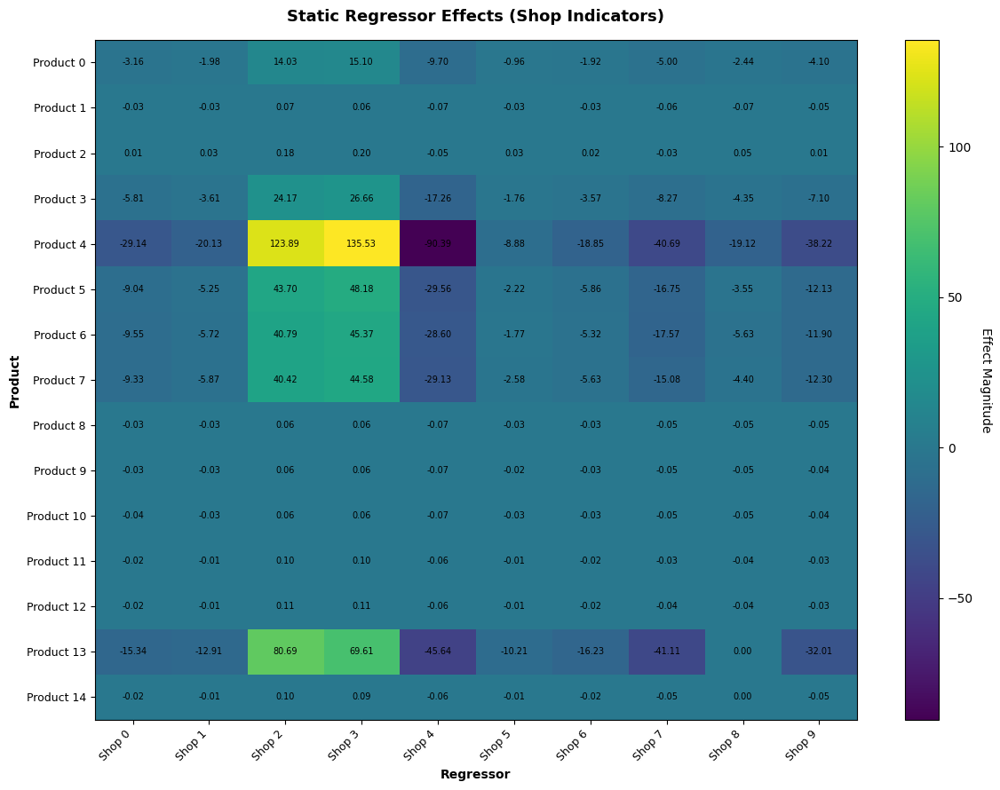

In [22]:
# Train Prophet models on TUNING data for validation evaluation

prophet_val_models = {}
prophet_val_forecasts = {}
prophet_val_components = {}  # For component decomposition plots

# Filter to tuning data only
prophet_train_tuning = prophet_train[~prophet_train['is_validation']].copy()

for product in sorted(prophet_train['product'].unique()):
    # Convert to regular Python int to avoid numpy type issues
    product = int(product)
    
    # Check if we have hyperparameters for this product using try-except
    try:
        params = best_params_by_product[product]
    except KeyError:
        print(f"Skipping product {product} - no hyperparameters (insufficient training data)")
        continue
    
    # Filter TUNING data for this product
    product_data = prophet_train_tuning[prophet_train_tuning['product'] == product].copy()
    
    # Smart zero filtering: keep zeros after first sale for each shop
    filtered_dfs = []
    for shop in sorted(product_data['shop'].unique()):
        shop_data = product_data[product_data['shop'] == shop].sort_values('ds').copy()
        
        # Find first non-zero sale
        first_sale_idx = shop_data[shop_data['y'] > 0].index
        if len(first_sale_idx) > 0:
            first_sale_date = shop_data.loc[first_sale_idx[0], 'ds']
            # Keep all data from first sale onward (including zeros)
            shop_data = shop_data[shop_data['ds'] >= first_sale_date]
            filtered_dfs.append(shop_data)
    
    if not filtered_dfs:
        continue
    
    product_data = pd.concat(filtered_dfs, ignore_index=True)
    
    # Prepare Prophet dataframe
    prophet_df = product_data[['ds', 'y'] + shop_cols + ['price', 'price_lag_1', 'price_lag_7']].copy()
    
    # Use product-specific optimized hyperparameters (already retrieved above)
    # Create Prophet model with optimized hyperparameters
    model = create_prophet_model(params, shop_cols)
    
    # Fit the model on tuning data
    model.fit(prophet_df)
    
    # Get December validation data for this product
    # Note: prophet_train already has correctly computed price lags for the validation period
    # (lags use November prices for December predictions)
    dec_val_data = prophet_train[
        (prophet_train['is_validation']) &
        (prophet_train['product'] == product)
    ][['ds'] + shop_cols + ['price', 'price_lag_1', 'price_lag_7']].copy()
    
    # Generate predictions on validation data (if exists) for evaluation
    if len(dec_val_data) > 0:
        forecast_val = model.predict(dec_val_data)
    else:
        # No validation data - use empty forecast
        forecast_val = None
    
    # Generate component decomposition on the FULL TRAINING DATA for visualization
    # This shows how the model decomposes the historical signal
    components_data = prophet_train[
        prophet_train['product'] == product
    ][['ds'] + shop_cols + ['price', 'price_lag_1', 'price_lag_7']].copy()
    
    forecast_components = model.predict(components_data)
    
    # Store the model, validation forecast, and component decomposition
    prophet_val_models[product] = model
    prophet_val_forecasts[product] = forecast_val
    prophet_val_components[product] = forecast_components

# Create component plots with dynamic and static regressors separated
products = sorted(prophet_val_models.keys())
n_products = len(products)

# Get components from first model (use full training period decomposition)
sample_forecast = prophet_val_components[products[0]]
sample_model = prophet_val_models[products[0]]

# Separate dynamic and static components
dynamic_cols = []
dynamic_names = []
static_cols = []
static_names = []

# Add standard time series components (dynamic)
if 'trend' in sample_forecast.columns:
    dynamic_cols.append('trend')
    dynamic_names.append('Trend')

if 'yearly' in sample_forecast.columns:
    dynamic_cols.append('yearly')
    dynamic_names.append('Yearly')

if 'weekly' in sample_forecast.columns:
    dynamic_cols.append('weekly')
    dynamic_names.append('Weekly')

if 'daily' in sample_forecast.columns:
    dynamic_cols.append('daily')
    dynamic_names.append('Daily')

if 'holidays' in sample_forecast.columns:
    dynamic_cols.append('holidays')
    dynamic_names.append('Holidays')

# Classify regressors as dynamic or static
for reg_name in sorted(sample_model.extra_regressors.keys()):
    if reg_name in sample_forecast.columns:
        # Shop indicators are always static (one-hot encoded, constant within each forecast)
        if reg_name.startswith('shop_'):
            static_cols.append(reg_name)
            static_names.append(reg_name.replace('_', ' ').title())
        else:
            # For price and other regressors, check if they vary over time
            variance = sample_forecast[reg_name].var()
            
            if variance > 1e-10:  # Dynamic (varies over time)
                dynamic_cols.append(reg_name)
                dynamic_names.append(reg_name.replace('_', ' ').title())
            else:  # Static (constant values)
                static_cols.append(reg_name)
                static_names.append(reg_name.replace('_', ' ').title())

n_dynamic = len(dynamic_cols)
n_static = len(static_cols)

# PLOT 1: Dynamic components (one faceted plot)
if n_dynamic > 0:
    fig, axes = plt.subplots(n_products, n_dynamic, figsize=(3.5 * n_dynamic, 2.5 * n_products))
    
    # Handle edge cases
    if n_products == 1 and n_dynamic == 1:
        axes = np.array([[axes]])
    elif n_products == 1:
        axes = axes.reshape(1, -1)
    elif n_dynamic == 1:
        axes = axes.reshape(-1, 1)
    
    # Plot dynamic components - use full training period decomposition
    for row_idx, product in enumerate(products):
        forecast = prophet_val_components[product]
        
        for col_idx, (comp, comp_name) in enumerate(zip(dynamic_cols, dynamic_names)):
            ax = axes[row_idx, col_idx]
            
            if comp in forecast.columns:
                ax.plot(forecast['ds'], forecast[comp], linewidth=1.5)
            
            ax.grid(True, alpha=0.3)
            ax.tick_params(labelsize=7)
            
            if row_idx == 0:
                ax.set_title(comp_name, fontsize=9, fontweight='bold', pad=6)
            
            if col_idx == 0:
                ax.set_ylabel(f'Prod {product}', fontsize=8, fontweight='bold')
            
            if row_idx == n_products - 1:
                ax.set_xlabel('Date', fontsize=7)
            else:
                ax.set_xticklabels([])
    
    fig.suptitle('Dynamic Components - Full Training Period', fontsize=13, fontweight='bold', y=0.998)
    plt.tight_layout()
    plt.show()

# PLOT 2: Static regressors as heatmap
if n_static > 0:
    # Create a matrix: rows=products, columns=static regressors
    # Use mean value across time for each product-regressor combination
    static_matrix = np.zeros((n_products, n_static))
    
    for row_idx, product in enumerate(products):
        forecast = prophet_val_components[product]
        for col_idx, comp in enumerate(static_cols):
            if comp in forecast.columns:
                static_matrix[row_idx, col_idx] = forecast[comp].mean()
    
    # Create heatmap with sequential colormap
    fig, ax = plt.subplots(figsize=(max(8, n_static * 1.2), max(6, n_products * 0.6)))
    
    im = ax.imshow(static_matrix, cmap='viridis', aspect='auto')
    
    # Set ticks and labels
    ax.set_xticks(np.arange(n_static))
    ax.set_yticks(np.arange(n_products))
    ax.set_xticklabels(static_names, rotation=45, ha='right', fontsize=9)
    ax.set_yticklabels([f'Product {p}' for p in products], fontsize=9)
    
    # Add colorbar
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Effect Magnitude', rotation=270, labelpad=15, fontsize=10)
    
    # Add values in cells
    for i in range(n_products):
        for j in range(n_static):
            text = ax.text(j, i, f'{static_matrix[i, j]:.2f}',
                          ha='center', va='center', color='black', fontsize=7)
    
    ax.set_title('Static Regressor Effects (Shop Indicators)', fontsize=13, fontweight='bold', pad=15)
    ax.set_xlabel('Regressor', fontsize=10, fontweight='bold')
    ax.set_ylabel('Product', fontsize=10, fontweight='bold')
    
    plt.tight_layout()
    plt.show()

## Predicted vs Actual 

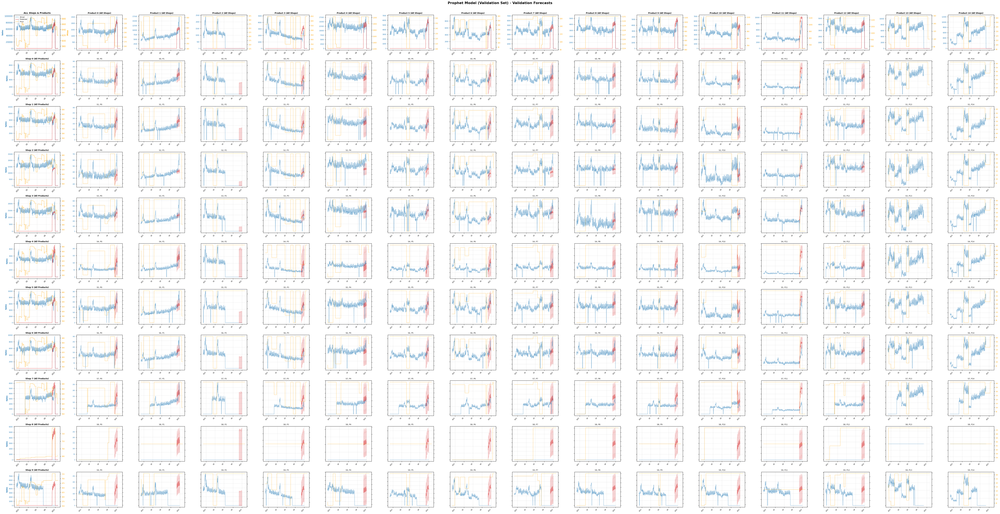

In [23]:
# Prepare combined data for visualization and create full shop×product facet grid
prophet_viz_data = []

# Get 13 months of training data for visualization (Dec 2020 - Dec 2021)
viz_cutoff_date = pd.Timestamp('2020-12-01')

# Get all unique shops and products
shops = sorted(train_df['shop'].unique())
products_viz = sorted(train_df['product'].unique())

# Get shop columns for filtering
shop_cols = [f'shop_{s}' for s in unique_shops]
cols_for_viz = ['ds', 'y', 'price', 'price_lag_1', 'price_lag_7'] + shop_cols
cols_for_test_viz = ['ds', 'price', 'price_lag_1', 'price_lag_7'] + shop_cols

# Process ALL shop-product combinations using validation models
for product in prophet_val_models.keys():
    # Get the model for this product
    model = prophet_val_models[product]
    
    # Process all shops for this product
    for shop in shops:
        # Get training data for this shop-product combo (13 months: Dec 2020 - Nov 2021)
        train_combo = prophet_train[
            (prophet_train['product'] == product) & 
            (prophet_train['shop'] == shop) &
            (prophet_train['ds'] >= viz_cutoff_date) &
            (~prophet_train['is_validation'])  # Exclude validation period from training viz
        ][cols_for_viz].copy()
        
        # Get validation data for this shop-product combo (December 2021)
        val_combo = prophet_train[
            (prophet_train['product'] == product) & 
            (prophet_train['shop'] == shop) &
            (prophet_train['is_validation'])
        ][cols_for_viz].copy()
        
        # Add training data WITHOUT predictions (actuals only)
        if len(train_combo) > 0:
            for j, row in train_combo.iterrows():
                prophet_viz_data.append({
                    'shop': shop,
                    'product': product,
                    'date': row['ds'],
                    'actual_sales': row['y'],
                    'price': row['price'],
                    'predicted_sales_mean': np.nan,  # No predictions for training period
                    'predicted_sales_lower': np.nan,
                    'predicted_sales_upper': np.nan,
                    'split': 'train'
                })
        
        # Predictions for validation period (December 2021)
        if len(val_combo) > 0:
            val_forecast = model.predict(val_combo[cols_for_test_viz])
            for j, row in val_combo.iterrows():
                forecast_row = val_forecast[val_forecast['ds'] == row['ds']]
                if len(forecast_row) > 0:
                    # Convert Prophet's 80% CI to 90% CI
                    yhat_std = (forecast_row['yhat_upper'].values[0] - forecast_row['yhat_lower'].values[0]) / (2 * 1.28)
                    lower_90 = forecast_row['yhat'].values[0] - 1.645 * yhat_std
                    upper_90 = forecast_row['yhat'].values[0] + 1.645 * yhat_std
                    
                    prophet_viz_data.append({
                        'shop': shop,
                        'product': product,
                        'date': row['ds'],
                        'actual_sales': row['y'],  # We have actuals for validation period
                        'price': row['price'],
                        'predicted_sales_mean': max(0, forecast_row['yhat'].values[0]),
                        'predicted_sales_lower': max(0, lower_90),
                        'predicted_sales_upper': max(0, upper_90),
                        'split': 'test'
                    })
        
        # Add price data for January 2022 (for visualization only - no predictions)
        test_combo_prices = test_df[
            (test_df['product'] == product) & 
            (test_df['shop'] == shop)
        ][['date', 'price']].copy()
        
        for _, row in test_combo_prices.iterrows():
            prophet_viz_data.append({
                'shop': shop,
                'product': product,
                'date': row['date'],
                'actual_sales': np.nan,
                'price': row['price'],
                'predicted_sales_mean': np.nan,
                'predicted_sales_lower': np.nan,
                'predicted_sales_upper': np.nan,
                'split': 'test'
            })

prophet_viz_df = pd.DataFrame(prophet_viz_data)

# Plot forecast grid using utility function
plot_forecast(
    viz_df=prophet_viz_df,
    shops=shops,
    products=products_viz,
    model_name="Prophet Model (Validation Set)",
    lower_col='predicted_sales_lower',
    upper_col='predicted_sales_upper'
)

## Validation

Number of products with models: 15
Number of products with forecasts: 15
Product 0: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 1: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 2: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 3: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 4: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 5: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 6: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 7: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 4: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 5: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Product 6: 310 validation rows, 310 forecast rows
  Matched 310/310 validation rows
Pro

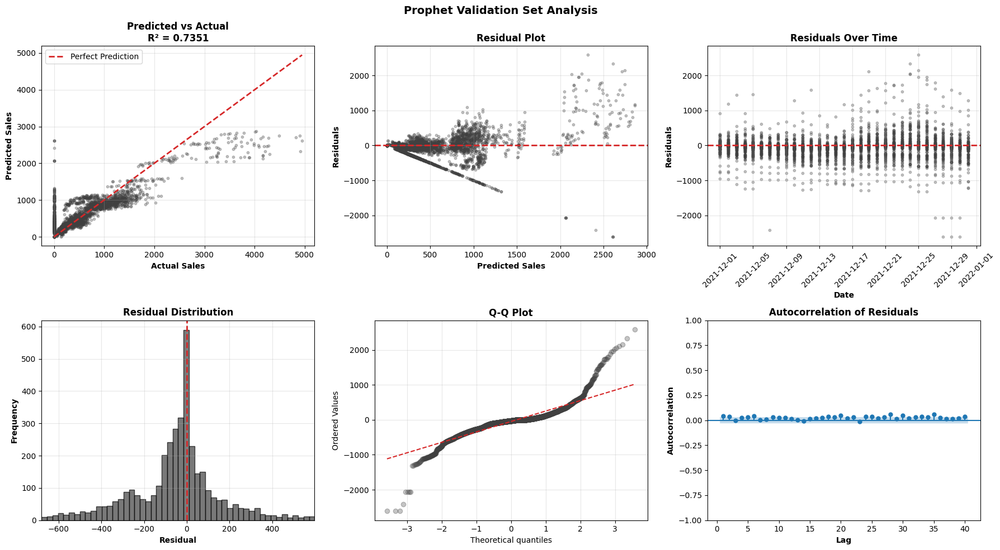

In [24]:
# Evaluate Prophet models on the December 2021 validation set

# Extract predictions and actuals
prophet_val_predictions = []
prophet_val_actuals = []
prophet_val_dates = []

print(f"Number of products with models: {len(prophet_val_models)}")
print(f"Number of products with forecasts: {len(prophet_val_forecasts)}")

for product in sorted(prophet_val_models.keys()):
    if product not in prophet_val_forecasts:
        print(f"Product {product}: Not in forecasts dict")
        continue
    
    forecast_val = prophet_val_forecasts[product]
    
    if forecast_val is None or len(forecast_val) == 0:
        print(f"Product {product}: No validation forecast available")
        continue
    
    # Get validation data for this product
    product_val_data = prophet_train[
        (prophet_train['product'] == product) & 
        (prophet_train['is_validation'] == True)
    ].copy()
    
    print(f"Product {product}: {len(product_val_data)} validation rows, {len(forecast_val)} forecast rows")
    
    # Match predictions with actuals by date AND shop
    matched_count = 0
    
    for idx, row in product_val_data.iterrows():
        # Filter forecast by date first
        forecast_date_match = forecast_val[forecast_val['ds'] == row['ds']]
        
        if len(forecast_date_match) == 0:
            continue
        
        # Find which shop is active in the validation row (shop_X == 1)
        active_shop_col = None
        for shop_col in shop_cols:
            if shop_col in row.index and row[shop_col] == 1:
                active_shop_col = shop_col
                break
        
        if active_shop_col is None:
            continue
        
        # In the forecast, find the row where this shop column is NON-ZERO
        # (Prophet outputs the effect value, not 0/1 indicator)
        forecast_row = forecast_date_match[forecast_date_match[active_shop_col] != 0]
        
        if len(forecast_row) > 0:
            prophet_val_predictions.append(max(0, forecast_row['yhat'].values[0]))
            prophet_val_actuals.append(row['y'])
            prophet_val_dates.append(row['ds'])
            matched_count += 1
    
    print(f"  Matched {matched_count}/{len(product_val_data)} validation rows")

print(f"\nTotal predictions collected: {len(prophet_val_predictions)}")

# Convert to arrays
prophet_val_predictions = np.array(prophet_val_predictions)
prophet_val_actuals = np.array(prophet_val_actuals)

# Only proceed with metrics if we have predictions
if len(prophet_val_predictions) > 0:
    # Calculate validation metrics with naive baseline comparison
    # Prepare validation dataframe
    prophet_val_df = prophet_train[prophet_train['is_validation'] == True].copy()

    prophet_metrics = validation_metrics(
        actuals=prophet_val_actuals,
        predictions=prophet_val_predictions,
        model_name="Prophet",
        train_df=prophet_train[~prophet_train['is_validation']],
        validation_df=prophet_val_df,
        naive_window_days=30
    )

    # Plot residual diagnostics
    plot_residual_diagnostics(
        actuals=prophet_val_actuals,
        predictions=prophet_val_predictions,
        model_name="Prophet",
        r2_score_val=prophet_metrics['r2'],
        dates=prophet_val_dates
    )
else:
    print("\nERROR: No predictions were matched! Check the matching logic.")


---

# Chronos-2 Model

## Why Foundation Models After Prophet?

Prophet gave us interpretable seasonality and hyperparameter-tuned forecasts, but still has limitations:
1. **Additive structure**: Assumes trends and seasonality combine linearly
2. **Limited cross-series learning**: Each product model is independent
3. **Manual feature engineering**: Requires explicit specification of regressors

**Chronos-2 offers a paradigm shift**: Instead of manually specifying model structure, we leverage a **pretrained transformer** that has learned general time series patterns from thousands of diverse datasets.

---

## Transfer Learning for Time Series

### What is Chronos-2?

Chronos-2 is a **foundation model** for time series forecasting, analogous to GPT for language:

**Pretraining Corpus**: Trained on 100,000+ time series from diverse domains (finance, weather, retail, web traffic, etc.)

**Architecture**: Transformer encoder-decoder
- **Encoder**: Processes historical context with self-attention (learns which past time steps are relevant)
- **Decoder**: Generates future predictions autoregressively
- **Tokenization**: Time series values are discretized into tokens (like words in NLP)

**Key Advantage**: **Transfer learning** — knowledge from pretraining transfers to our grocery sales domain even though the model has never seen grocery data before.

### Zero-Shot vs. Fine-Tuning

**Zero-Shot Inference**:
- Use pretrained weights **as-is**, no domain-specific training
- Tests the model's generalization ability
- Fast (no training time), but may miss domain-specific patterns

**Fine-Tuning**:
- **Adapt** pretrained weights to our specific grocery sales data
- Updates model parameters on our historical data (through November 2021)
- Balances general knowledge (from pretraining) with domain-specific patterns
- Computational cost: ~10-20 minutes on M3 GPU with `NUM_STEPS` gradient steps

**Our approach**: Compare both to quantify the value of fine-tuning.

---

## Multivariate Forecasting Architecture

### Design Decision: 150-Dimensional Multivariate Series

Instead of 150 independent univariate models, we construct a **single multivariate series**:

$$\mathbf{X}_t \in \mathbb{R}^{150}$$

Where each dimension corresponds to one shop-product combination.

**Why multivariate?**
1. **Cross-sectional learning**: Model observes co-movement between products and shops
2. **Shared patterns**: Weekend spikes affect all series simultaneously — multivariate structure captures this
3. **Missing data handling**: When one shop-product has gaps, the model can impute using correlated series

**Architecture details**:
- **Input**: Historical matrix $(T_{\text{hist}} \times 150)$ where rows are time steps, columns are series
- **Output**: Forecast matrix $(H \times 150)$ where $H = 31$ days (December 2021)
- **Quantiles**: Model outputs 10th, 50th, 90th percentiles for each series and time step

**Limitation**: Chronos-2's multivariate mode doesn't accept time-varying covariates (like price). This is a known constraint of the pretrained tokenization scheme.

---

## Fine-Tuning Methodology

**Training Data**: All historical data through November 2021 (150 series × ~730 days)

**Objective**: Minimize quantile loss across all forecast horizons and series

$$\mathcal{L} = \sum_{q \in \{0.1, 0.5, 0.9\}} \sum_{t,i} \rho_q\left(y_{t,i} - \hat{y}_{t,i}^{(q)}\right)$$

Where $\rho_q$ is the pinball loss function.

**Training Configuration**:
- **Gradient steps**: Controlled by `NUM_STEPS` parameter (e.g., 10 steps for fast iteration)
- **Hardware**: MPS (Metal Performance Shaders) for M3 GPU acceleration
- **Checkpointing**: Saves fine-tuned weights to `chronos-2-finetuned/{NUM_STEPS}_steps/`
- **Validation**: December 2021 held out for fair evaluation

**Expected Outcome**: Fine-tuning should improve over zero-shot by adapting to grocery-specific patterns (holiday timing, product correlations).

---

## Data Preparation

We use a **multivariate approach** where all 150 shop-product combinations are treated as a single 150-dimensional time series. This enables the model to:
- Learn cross-correlations between all shop-product pairs
- Capture interdependencies (e.g., complementary products, shop-specific patterns)
- Share information across related series during forecasting

The alternative univariate approach would treat each shop-product as independent, missing these relationships.

In [25]:
def create_multivariate_arrays(df, shops, products, value_col='sales'):
    """
    Convert long-format DataFrame to multivariate arrays.
    
    Returns 2D array of shape (n_timesteps, 150) where each column is a shop-product combo.
    Pads with zeros for missing values to ensure all series have the same length.
    """
    # Get all dates across the dataset
    all_dates = sorted(df['date'].unique())
    n_timesteps = len(all_dates)
    n_series = len(shops) * len(products)
    
    # Create output matrix: (n_series, n_timesteps) for Chronos-2 multivariate API
    matrix = np.zeros((n_series, n_timesteps))
    
    # Create mapping of series index to (shop, product)
    col_mapping = {}
    series_idx = 0
    for shop in shops:
        for product in products:
            col_mapping[series_idx] = (shop, product)
            series_idx += 1
    
    # Fill in values (skip if column doesn't exist)
    if value_col not in df.columns:
        return matrix, col_mapping, all_dates
    
    for series_idx, (shop, product) in col_mapping.items():
        series_data = df[
            (df['shop'] == shop) & 
            (df['product'] == product)
        ].sort_values('date')
        
        if len(series_data) > 0:
            # Map dates to column indices, series to row indices
            for _, row in series_data.iterrows():
                date_idx = all_dates.index(row['date'])
                matrix[series_idx, date_idx] = row[value_col]
    
    return matrix, col_mapping, all_dates

# Get shop-product combinations
shops = sorted(train_df['shop'].unique())
products = sorted(train_df['product'].unique())

# Create TUNING DATA matrices (for validation evaluation)
train_df_tuning = train_df[~train_df['is_validation']].copy()

train_sales_matrix_tuning, col_mapping, train_dates_tuning = create_multivariate_arrays(
    train_df_tuning, shops, products, 'sales'
)
train_price_matrix_tuning, _, _ = create_multivariate_arrays(
    train_df_tuning, shops, products, 'price'
)

# Create FULL TRAINING DATA matrices (for final test predictions)
train_sales_matrix, col_mapping, train_dates = create_multivariate_arrays(
    train_df, shops, products, 'sales'
)
train_price_matrix, _, _ = create_multivariate_arrays(
    train_df, shops, products, 'price'
)

# Create multivariate arrays for test data (future covariates)
test_price_matrix, _, test_dates = create_multivariate_arrays(
    test_df, shops, products, 'price'
)

## Zero-Shot

First we try a one-shot inference without fine-tuning on our data. We can use the full training set because there's no tuning.

In [26]:
# Prepare data for Chronos-2 zero-shot model
# Using FULL training data (Jan 2018 - Dec 2021) since zero-shot doesn't require tuning
# Single 150-dimensional multivariate time series (all shop-product combinations)
# This enables the model to learn cross-correlations across all series

# Create multivariate input as a single time series
# Shape: (150, n_timesteps) where 150 = 10 shops × 15 products
chronos_input = {
    'target': train_sales_matrix  # Full historical sales for all shop-product combos
}

# Wrap in list since predict_quantiles expects a list of inputs
chronos_inputs = [chronos_input]

In [27]:
# Load Chronos-2 model
chronos_pipeline = Chronos2Pipeline.from_pretrained(
    "amazon/chronos-2",
    device_map="mps",
    dtype=torch.bfloat16
)

# Generate quantile predictions for multivariate time series
quantile_levels = [0.1, 0.5, 0.9]

# Generate forecasts
# Output will be: (quantiles, point_forecasts)
# quantiles shape: list of 1 tensor with shape (150, 61, 3)
# point_forecasts shape: list of 1 tensor with shape (150, 61)
chronos_quantile_forecasts, chronos_point_forecasts = chronos_pipeline.predict_quantiles(
    chronos_inputs,
    prediction_length=61,
    quantile_levels=quantile_levels
)

In [28]:
# Convert multivariate forecasts to DataFrame (unpack back to shop-product level)
chronos_predictions_list = []

# Extract forecasts from the single multivariate output
# Shape: (150, 61, 3) for quantiles, (150, 61) for point forecasts
quantile_forecasts = chronos_quantile_forecasts[0].cpu().numpy()  # (150, 61, 3)
point_forecasts = chronos_point_forecasts[0].cpu().numpy()  # (150, 61)

print(f"Extracting predictions from multivariate output:")
print(f"  Quantile forecasts shape: {quantile_forecasts.shape}")
print(f"  Point forecasts shape: {point_forecasts.shape}")

# Unpack to shop-product combinations using col_mapping
for series_idx, (shop, product) in col_mapping.items():
    # Get forecasts for this shop-product combination (series series_idx)
    series_quantiles = quantile_forecasts[series_idx, :, :]  # (61, 3)
    series_point = point_forecasts[series_idx, :]  # (61,)
    
    # Create predictions for each date
    for t, date in enumerate(test_dates):
        pred_dict = {
            'shop': shop,
            'product': product,
            'date': pd.Timestamp(date),
            'q10': series_quantiles[t, 0],   # 0.1 quantile
            'median': series_quantiles[t, 1],  # 0.5 quantile (median)
            'q90': series_quantiles[t, 2],   # 0.9 quantile
            'point': series_point[t]          # Point forecast
        }
        chronos_predictions_list.append(pred_dict)

chronos_pred_df = pd.DataFrame(chronos_predictions_list)

# Ensure non-negative predictions
for col in ['q10', 'median', 'q90', 'point']:
    chronos_pred_df[col] = chronos_pred_df[col].clip(lower=0)

Extracting predictions from multivariate output:
  Quantile forecasts shape: (150, 61, 3)
  Point forecasts shape: (150, 61)


### Predicted vs Actual

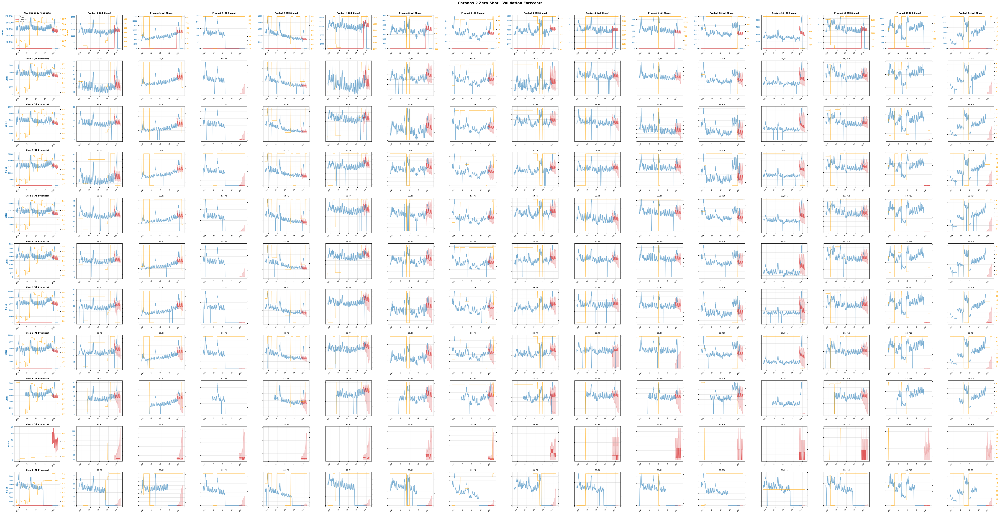

In [29]:
# Visualize Chronos-2 predictions vs actual (December 2020 onwards)

viz_start_date = pd.Timestamp('2020-12-01')
test_start = pd.Timestamp('2021-12-01')
test_end = pd.Timestamp('2022-01-31')

# Get historical data from December 2020 onwards
historical_data = train_df[train_df['date'] >= viz_start_date].copy()

# Merge price data into chronos_pred_df from test_df
chronos_pred_with_price = chronos_pred_df.merge(
    test_df[['shop', 'product', 'date', 'price']],
    on=['shop', 'product', 'date'],
    how='left'
)

# Combine data for visualization using plot_forecast format
chronos_viz_data = []

# Add historical actuals
for _, row in historical_data.iterrows():
    chronos_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': row['sales'],
        'price': row['price'],
        'predicted_sales_mean': np.nan,
        'q10': np.nan,
        'q90': np.nan,
        'split': 'train'
    })

# Add test predictions with uncertainty
for _, row in chronos_pred_with_price.iterrows():
    chronos_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': np.nan,
        'price': row['price'],
        'predicted_sales_mean': row['median'],
        'q10': row['q10'],
        'q90': row['q90'],
        'split': 'test'
    })

chronos_viz_df = pd.DataFrame(chronos_viz_data)

# Use plot_forecast function for consistent visualization
shops = sorted(train_df['shop'].unique())
products = sorted(train_df['product'].unique())

plot_forecast(
    chronos_viz_df,
    shops,
    products,
    'Chronos-2 Zero-Shot',
    lower_col='q10',
    upper_col='q90'
)

### Validation

Evaluation data points: 4030
CHRONOS-2 ZERO-SHOT - VALIDATION SET EVALUATION
MAE:  123.303
RMSE: 267.490
MAPE: 23.99%
R²:   0.8297
CHRONOS-2 ZERO-SHOT - VALIDATION SET EVALUATION
MAE:  123.303
RMSE: 267.490
MAPE: 23.99%
R²:   0.8297


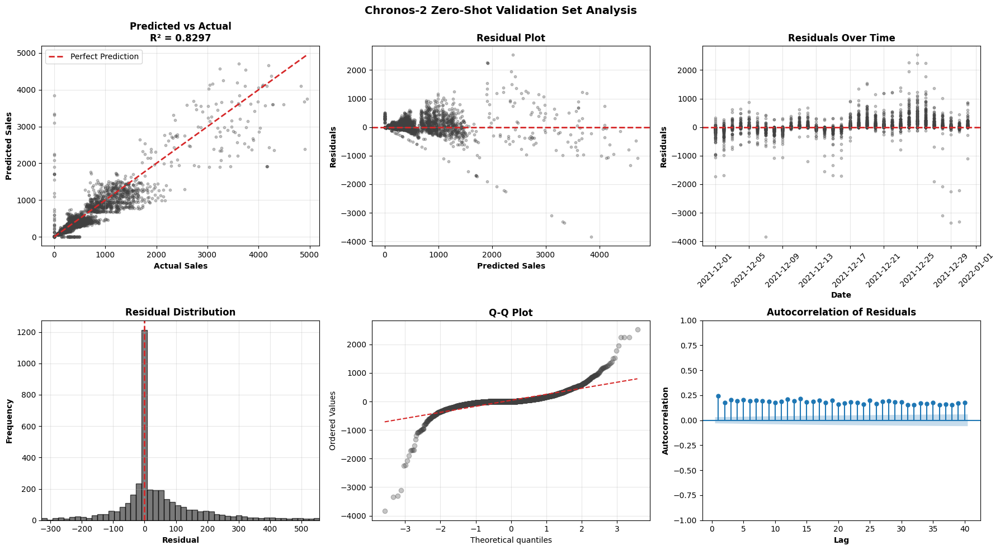

In [30]:
# Evaluate Chronos-2 on December 2021 (held-out in training data)

dec_start = pd.Timestamp('2021-12-01')
dec_end = pd.Timestamp('2021-12-31')

# Filter predictions for December
chronos_dec_preds = chronos_pred_df[
    (chronos_pred_df['date'] >= dec_start) & 
    (chronos_pred_df['date'] <= dec_end)
].copy()

# Get actual December 2021 sales from training data
train_dec_actual = train_df[
    (train_df['date'] >= dec_start) & 
    (train_df['date'] <= dec_end)
].copy()

# Merge predictions with actuals
chronos_eval_df = chronos_dec_preds.merge(
    train_dec_actual[['shop', 'product', 'date', 'sales', 'price']],
    on=['shop', 'product', 'date'],
    how='inner'
)

print(f"Evaluation data points: {len(chronos_eval_df)}")

# Calculate metrics using median predictions
chronos_predictions_eval = chronos_eval_df['median'].values
chronos_actuals_eval = chronos_eval_df['sales'].values

# Calculate validation metrics with naive baseline comparison
chronos_metrics = validation_metrics(
    actuals=chronos_actuals_eval,
    predictions=chronos_predictions_eval,
    model_name="Chronos-2 Zero-Shot",
    train_df=train_df[~train_df['is_validation']],
    validation_df=train_dec_actual,
    naive_window_days=30
)

# Plot residual diagnostics
plot_residual_diagnostics(
    chronos_actuals_eval,
    chronos_predictions_eval,
    "Chronos-2 Zero-Shot",
    r2_score_val=chronos_metrics['r2'],
    dates=chronos_eval_df['date']
)

## Fine-Tuned

Chronos-2 supports fine-tuning on domain-specific data to improve forecasting accuracy. This allows the model to learn patterns specific to our grocery sales dataset.

In [31]:
# Fine-tune or load Chronos-2 model
FORCE_RETRAIN = False  
NUM_STEPS = 50
MODEL_PATH = Path(f"chronos-2-finetuned/{NUM_STEPS}_steps")

if MODEL_PATH.exists() and not FORCE_RETRAIN:
    print(f"✓ Loading existing fine-tuned model from {MODEL_PATH}/")
    finetuned_pipeline = Chronos2Pipeline.from_pretrained(
        MODEL_PATH,
        device_map="mps",
        dtype=torch.bfloat16
    )
    print("✓ Model loaded successfully")
else:
    # Prepare training data for fine-tuning (using TUNING data only)
    # This allows us to validate the fine-tuned model on December 2021
    train_input = {
        'target': train_sales_matrix_tuning  # Shape: (150, n_tuning_timesteps)
    }
    train_inputs = [train_input]
    
    # Fine-tune the Chronos-2 model
    # Using limited steps for demonstration (full training would use 1000+ steps)
    finetuned_pipeline = chronos_pipeline.fit(
        inputs=train_inputs,
        prediction_length=61,  # Same as our test forecast horizon
        num_steps=NUM_STEPS,  
        learning_rate=1e-5,
        batch_size=4,
        logging_steps=1,
    )
    
    # Save the fine-tuned model
    print(f"\n✓ Saving fine-tuned model to {MODEL_PATH}/")
    finetuned_pipeline.save_pretrained(MODEL_PATH)
    print("✓ Model saved successfully")

✓ Loading existing fine-tuned model from chronos-2-finetuned/50_steps/
✓ Model loaded successfully
✓ Model loaded successfully


In [32]:
# Generate predictions using the fine-tuned model
# Use the same multivariate structure as one-shot (full training data)

# Reuse the multivariate input structure from one-shot
finetuned_input = {
    'target': train_sales_matrix  # Full training history: (150, 1461)
}

finetuned_inputs = [finetuned_input]

# Generate forecasts with fine-tuned model
finetuned_quantiles, finetuned_point_forecasts = finetuned_pipeline.predict_quantiles(
    finetuned_inputs,
    prediction_length=61,
    quantile_levels=[0.1, 0.5, 0.9]
)


In [33]:
# Extract fine-tuned predictions to DataFrame
finetuned_pred_list = []

# Extract forecasts from the multivariate output
# Shape: (150, 61, 3) for quantiles, (150, 61) for point forecasts
ft_quantile_forecasts = finetuned_quantiles[0].cpu().numpy()  # (150, 61, 3)
ft_point_forecasts = finetuned_point_forecasts[0].cpu().numpy()  # (150, 61)

# Unpack to shop-product combinations using col_mapping
for series_idx, (shop, product) in col_mapping.items():
    # Get forecasts for this shop-product combination
    series_quantiles = ft_quantile_forecasts[series_idx, :, :]  # (61, 3)
    series_point = ft_point_forecasts[series_idx, :]  # (61,)
    
    for t, date in enumerate(test_dates):
        finetuned_pred_list.append({
            'shop': shop,
            'product': product,
            'date': pd.Timestamp(date),
            'q10': series_quantiles[t, 0],
            'median': series_quantiles[t, 1],
            'q90': series_quantiles[t, 2],
            'point': series_point[t]
        })

finetuned_pred_df = pd.DataFrame(finetuned_pred_list)

# Ensure non-negative predictions
for col in ['q10', 'median', 'q90', 'point']:
    finetuned_pred_df[col] = finetuned_pred_df[col].clip(lower=0)

### Predicted vs Actual

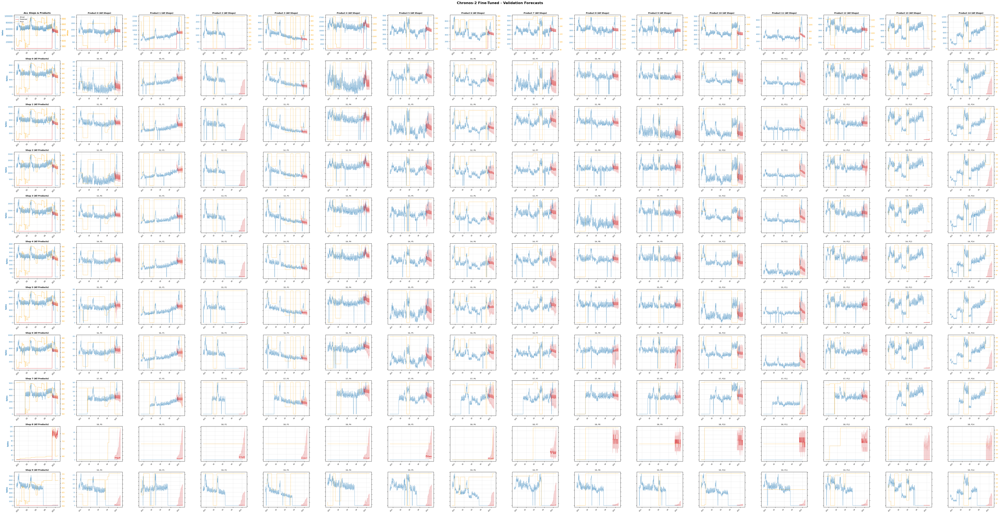

In [34]:
# Prepare visualization data for Chronos-2 Fine-Tuned
viz_start_date = pd.Timestamp('2020-12-01')  # 13 months before end of 2021

finetuned_viz_data = []

# Add 13 months of training data (Dec 2020 - Dec 2021)
for _, row in train_df[train_df['date'] >= viz_start_date].iterrows():
    finetuned_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': row['sales'],
        'price': row['price'],
        'predicted_sales_mean': np.nan,
        'q10': np.nan,
        'q90': np.nan,
        'split': 'train'
    })

# Add test predictions (Dec 2021 - Jan 2022) with price from test_df
for _, row in finetuned_pred_df.iterrows():
    # Get price for this shop-product-date from test_df
    price_row = test_df[
        (test_df['shop'] == row['shop']) &
        (test_df['product'] == row['product']) &
        (test_df['date'] == row['date'])
    ]
    price = price_row['price'].values[0] if len(price_row) > 0 else np.nan
    
    finetuned_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': np.nan,
        'price': price,
        'predicted_sales_mean': row['median'],
        'q10': row['q10'],
        'q90': row['q90'],
        'split': 'test'
    })

finetuned_viz_df = pd.DataFrame(finetuned_viz_data)

# Use plot_forecast function for consistent visualization
plot_forecast(
    finetuned_viz_df,
    shops,
    products,
    'Chronos-2 Fine-Tuned',
    lower_col='q10',
    upper_col='q90'
)


### Validation

Fine-tuned model evaluation data points: 4030
CHRONOS-2 FINE-TUNED - VALIDATION SET EVALUATION
MAE:  125.251
RMSE: 270.791
MAPE: 23.70%
R²:   0.8255
CHRONOS-2 FINE-TUNED - VALIDATION SET EVALUATION
MAE:  125.251
RMSE: 270.791
MAPE: 23.70%
R²:   0.8255


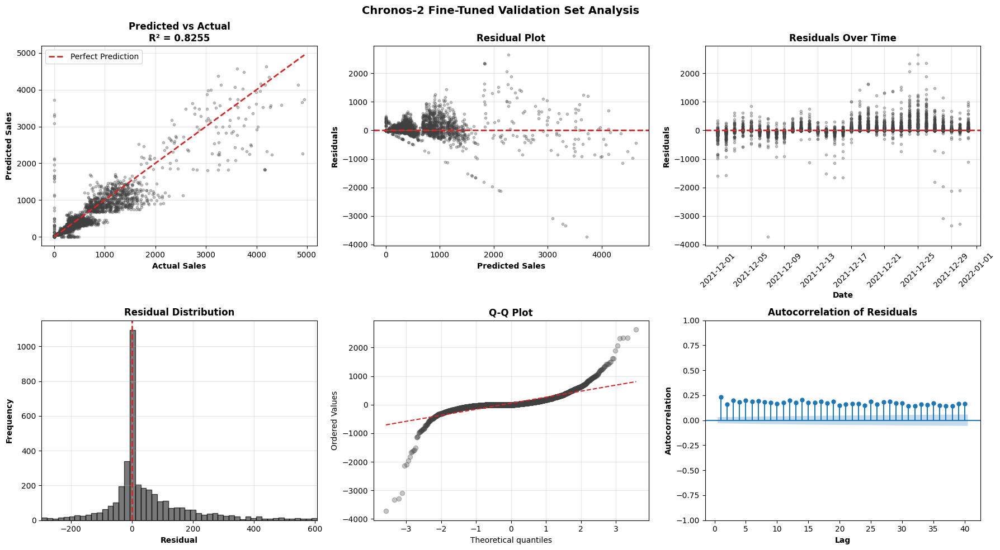


Saving evaluation plot...


<Figure size 640x480 with 0 Axes>

In [35]:
# Evaluate fine-tuned model on validation set (December 2021)

# Filter predictions for December 2021
finetuned_dec_preds = finetuned_pred_df[
    (finetuned_pred_df['date'] >= dec_start) & 
    (finetuned_pred_df['date'] <= dec_end)
].copy()

# Get actual December 2021 sales
train_dec_actual = train_df[
    (train_df['date'] >= dec_start) & 
    (train_df['date'] <= dec_end)
].copy()

# Merge predictions with actuals
finetuned_eval_df = finetuned_dec_preds.merge(
    train_dec_actual[['shop', 'product', 'date', 'sales']],
    on=['shop', 'product', 'date'],
    how='inner'
)

print(f"Fine-tuned model evaluation data points: {len(finetuned_eval_df)}")

# Extract predictions and actuals
finetuned_predictions_eval = finetuned_eval_df['median'].values
finetuned_actuals_eval = finetuned_eval_df['sales'].values

# Calculate validation metrics with naive baseline comparison
finetuned_metrics = validation_metrics(
    actuals=finetuned_actuals_eval,
    predictions=finetuned_predictions_eval,
    model_name="Chronos-2 Fine-Tuned",
    train_df=train_dates_tuning_df if 'train_dates_tuning_df' in locals() else train_df[~train_df['is_validation']],
    validation_df=train_dec_actual,
    naive_window_days=30
)

# Plot residual diagnostics
plot_residual_diagnostics(
    actuals=finetuned_actuals_eval,
    predictions=finetuned_predictions_eval,
    model_name="Chronos-2 Fine-Tuned",
    r2_score_val=finetuned_metrics['r2'],
    dates=finetuned_eval_df['date'].values
)

# Save results
print("\nSaving evaluation plot...")
plt.savefig('output/chronos_finetuned_evaluation.png', dpi=150, bbox_inches='tight')


---

# TFT Model (Temporal Fusion Transformer)

## Why TFT as the Final Model?

Previous models had progressive improvements but still limitations:
- **SARIMA**: Local models, no covariates, rigid seasonality
- **Prophet**: Interpretable but linear, per-product independent models
- **Chronos-2**: Powerful but can't use price covariates in multivariate mode

**TFT addresses all of these** — it's a purpose-built architecture for **multivariate forecasting with mixed-type covariates**.

---

## TFT Architecture: Technical Deep Dive

### Core Innovation: Temporal Fusion

TFT combines three key mechanisms:

**1. Variable Selection Networks**
- **Problem**: Not all covariates are equally important at all time steps
- **Solution**: Learned gating mechanisms that select relevant features
- **Benefit**: Model focuses on price when prices change, on calendar features during stable periods

**2. Multi-Head Self-Attention**
- **Problem**: Which historical time steps are most relevant for forecasting?
- **Solution**: Attention mechanism learns temporal dependencies
- **Example**: Model might learn that "last Saturday's sales" are more predictive than "yesterday's sales" for forecasting this Saturday

**3. Quantile Forecasting**
- **Problem**: Point forecasts don't capture uncertainty
- **Solution**: Quantile regression outputs 5th, 50th, 95th percentiles
- **Benefit**: Provides prediction intervals for risk management (e.g., inventory planning)

### Model Components

**Input Processing**:
- **Static covariates** (shop, product): Embedded via learned embedding layers → captures latent shop/product characteristics
- **Future covariates** (price, day_of_week, month, holiday): Available at forecast time
- **Past target** (historical sales): Encoded through LSTM

**Temporal Fusion**:
```
Historical Context → [LSTM Encoder] → Hidden States
                                          ↓
Static + Future Covariates → [Variable Selection] → Attention Inputs
                                          ↓
                        [Multi-Head Attention] → Attended Features
                                          ↓
                          [Feed-Forward + Gating] → Predictions
```

**Output**: Quantile forecasts for each of 61 days (December + January) for all 150 series

---

## Global vs. Local Modeling

**Critical architectural choice**: TFT trains a **single global model** across all 150 shop-product combinations.

**Why global?**
1. **Parameter sharing**: Model learns that weekends boost sales for ALL products
2. **Cross-series learning**: Sales spike in Product 5 at Shop 2 informs predictions for Product 5 at other shops
3. **Data efficiency**: Rare patterns (e.g., Product 14's high elasticity) can be learned from other products' price responses

**Contrast with local models**:
- SARIMA/Prophet: 15 or 150 independent models → each learns in isolation
- TFT: 1 model → learns shared structure while retaining series-specific effects via static embeddings

**EDA justification**: Correlation analysis revealed strong cross-series dependencies (shop-shop r>0.8, product clustering). Global model exploits this.

---

## Covariate Design

### Static Covariates (Time-Invariant)
- `shop` (categorical): Embedded to 5 dimensions
- `product` (categorical): Embedded to 7 dimensions

**Purpose**: Capture latent shop/product characteristics without manual feature engineering
- Shop embedding might learn "high-traffic vs. low-traffic locations"
- Product embedding might learn "staple vs. specialty goods"

### Future Covariates (Known in Advance)
- `price`: **Most important exogenous variable** (despite low elasticity, variation still matters)
- `day_of_week`: Captures weekly seasonality (0=Monday, 6=Sunday)
- `month`: Captures annual seasonality (1-12)
- `holiday`: Binary indicator (1=holiday period, 0=normal)
- `day_of_month`: Fine-grained calendar effect
- `week_of_year`: ISO week number

**Why these are "future" covariates**:
- At forecast time (end of November), we know the exact dates we're forecasting
- Therefore, we know day_of_week, month, holidays for December/January
- Prices are assumed known (e.g., from pricing team's plan)

**Alternative**: Past covariates would be features only available historically (e.g., competitor prices). We don't use these here.

---

## Scaling and Normalization

**Why scale?**
- Neural networks train poorly with different feature scales
- Sales range [0, ~500], prices range [10, ~100], dates range [0, 730]
- Gradient descent struggles without normalization

**Scaling strategy**:
- **Target (sales)**: Scaler normalizes to mean=0, std=1 per series
- **Future covariates**: Separate scaler for all covariate features
- **Inverse transform**: Predictions rescaled back to original units for evaluation

---

## Hyperparameter Configuration

Instead of grid search (computationally prohibitive for TFT), I use **informed defaults** from literature + TFT paper:

```python
best_params_tft = {
    'hidden_size': 64,           # Moderate capacity (64-128 typical)
    'lstm_layers': 1,             # Single-layer LSTM (deeper rarely helps)
    'num_attention_heads': 4,     # Multi-head attention (4-8 typical)
    'dropout': 0.1,               # Regularization (0.1-0.3 standard)
    'batch_size': 32,             # Mini-batch size
    'learning_rate': 0.001,       # Adam optimizer LR
}
```

**Why not tune?**
- **Computational cost**: Each TFT training run takes 15-30 minutes
- **Diminishing returns**: Literature shows TFT is robust to hyperparameters within reasonable ranges
- **Prioritization**: Better to invest in feature engineering and data quality

**Future work**: Optuna tuning with Ray Tune for parallelization if performance gap vs. baselines is small.

---

## Training Configuration

**Horizon Settings**:
- `input_chunk_length=30`: Model observes last 30 days of history
- `output_chunk_length=61`: Forecasts 61 days ahead (Dec 31 + Jan 30)

**Training Details**:
- **Epochs**: 50 (with early stopping on train_loss, patience=10)
- **Batch size**: 32 shop-product series per batch
- **Gradient clipping**: Max norm = 1.0 (prevents exploding gradients)
- **Checkpointing**: Saves best model to `darts_logs/tft_model_50epochs/`

**Hardware**:
- **MPS acceleration**: Uses M3 GPU via PyTorch MPS backend
- **Fallback**: Automatic CPU fallback if MPS unavailable
- **Memory**: ~2-4 GB GPU memory for this model size

---

## Data Preparation

Convert data to Darts TimeSeries format with separate components:
- **Target**: Sales for all 150 shop-product combinations
- **Past covariates**: Historical features available only during training (none used here)
- **Future covariates**: Features known in advance (price, day_of_week, month, holidays)
- **Static covariates**: Time-invariant features (shop ID, product ID)

In [36]:
# Suppress PyTorch Lightning warnings about TPU/HPU
warnings.filterwarnings('ignore', '.*TPU.*')
warnings.filterwarnings('ignore', '.*HPU.*')
os.environ['PYTORCH_ENABLE_MPS_FALLBACK'] = '1'

# Set default dtype to float32 for MPS compatibility BEFORE any model creation
torch.set_default_dtype(torch.float32)

# Also set precision for PyTorch Lightning
import pytorch_lightning as pl
import logging
pl.seed_everything(42)
torch.set_float32_matmul_precision('high')

# Suppress only PyTorch Lightning warnings, keep INFO for progress bars
logging.getLogger("pytorch_lightning").setLevel(logging.WARNING)

# Check MPS availability for M3 GPU
if torch.backends.mps.is_available():
    print("✓ MPS (Metal Performance Shaders) is available - will use M3 GPU")
    print("✓ Using float32 for MPS compatibility")
    print("✓ MPS fallback enabled")
    pl_trainer_kwargs = {
        "accelerator": "mps",
        "devices": 1,
        "precision": "32",
        "enable_progress_bar": True
    }
else:
    print("⚠ MPS not available - falling back to CPU")
    pl_trainer_kwargs = {
        "accelerator": "cpu",
        "precision": "32",
        "enable_progress_bar": True
    }

# Define holiday periods based on EDA insights (high sales in months 3-5, 10-12)
# These are approximate holiday/seasonal periods
def is_holiday(date):
    """Mark major holiday periods based on EDA sales spikes"""
    month = date.month
    day = date.day
    
    # Spring holidays (March-May high sales)
    if month in [3, 4, 5]:
        return 1
    # Fall/Winter holidays (October-December high sales)
    elif month in [10, 11, 12]:
        return 1
    # Specific high-traffic days (weekends during holiday months)
    elif month in [3, 4, 5, 10, 11, 12] and date.dayofweek >= 5:
        return 2  # Weekend during holiday season
    else:
        return 0

# Get shops and products
shops = sorted(train_df['shop'].unique())
products = sorted(train_df['product'].unique())

# Add features to training and test data
for df in [train_df, test_df]:
    df['holiday'] = df['date'].apply(is_holiday)
    df['month'] = df['date'].dt.month
    df['day_of_week'] = df['date'].dt.dayofweek
    df['day_of_month'] = df['date'].dt.day
    df['week_of_year'] = df['date'].dt.isocalendar().week

# Split into tuning and validation
tft_train_df = train_df[~train_df['is_validation']].copy()
tft_val_df = train_df[train_df['is_validation']].copy()


Seed set to 42


✓ MPS (Metal Performance Shaders) is available - will use M3 GPU
✓ Using float32 for MPS compatibility
✓ MPS fallback enabled


In [37]:
# Create TimeSeries objects for each shop-product combination

# Storage for TimeSeries
tft_series_train = []
tft_series_val = []
tft_future_covariates_train = []
tft_future_covariates_val = []
tft_future_covariates_test = []

# Static covariates (shop and product IDs) - create once per series
static_covariates_list = []

for shop in tqdm(shops, desc="Processing shops"):
    for product in products:
        # Filter data for this shop-product combination
        train_data = tft_train_df[
            (tft_train_df['shop'] == shop) & 
            (tft_train_df['product'] == product)
        ].sort_values('date').copy()
        
        val_data = tft_val_df[
            (tft_val_df['shop'] == shop) & 
            (tft_val_df['product'] == product)
        ].sort_values('date').copy()
        
        test_data = test_df[
            (test_df['shop'] == shop) & 
            (test_df['product'] == product)
        ].sort_values('date').copy()
        
        # Convert numerical columns to float32 for MPS compatibility
        numeric_cols = ['sales', 'price', 'day_of_week', 'month', 'holiday', 'day_of_month', 'week_of_year']
        for df in [train_data, val_data, test_data]:
            for col in numeric_cols:
                if col in df.columns:
                    df[col] = df[col].astype(np.float32)
        
        # Create static covariates (constant for each series)
        static_cov = pd.DataFrame({
            'shop': [shop],
            'product': [product]
        })
        static_covariates_list.append(static_cov)
        
        # Create target series (sales) for training
        if len(train_data) > 0:
            ts_train = TimeSeries.from_dataframe(
                train_data,
                time_col='date',
                value_cols='sales',
                fill_missing_dates=True,
                freq='D',
                fillna_value=0,
                static_covariates=static_cov
            )
            tft_series_train.append(ts_train)
        else:
            # Empty series - use zeros
            tft_series_train.append(None)
        
        # Create target series for validation
        if len(val_data) > 0:
            ts_val = TimeSeries.from_dataframe(
                val_data,
                time_col='date',
                value_cols='sales',
                fill_missing_dates=True,
                fillna_value=0,
                static_covariates=static_cov
            )
            tft_series_val.append(ts_val)
        else:
            tft_series_val.append(None)
        
        # Create future covariates for training (price, calendar, holidays)
        if len(train_data) > 0:
            future_cov_train = TimeSeries.from_dataframe(
                train_data,
                time_col='date',
                value_cols=['price', 'day_of_week', 'month', 'holiday', 'day_of_month', 'week_of_year'],
                fill_missing_dates=True,
                freq='D',
                fillna_value=0
            )
            tft_future_covariates_train.append(future_cov_train)
        else:
            tft_future_covariates_train.append(None)
        
        # Create future covariates for validation
        if len(val_data) > 0:
            future_cov_val = TimeSeries.from_dataframe(
                val_data,
                time_col='date',
                value_cols=['price', 'day_of_week', 'month', 'holiday', 'day_of_month', 'week_of_year'],
                fill_missing_dates=True,
                freq='D',
                fillna_value=0
            )
            tft_future_covariates_val.append(future_cov_val)
        else:
            tft_future_covariates_val.append(None)
        
        # Create future covariates for test period
        if len(test_data) > 0:
            future_cov_test = TimeSeries.from_dataframe(
                test_data,
                time_col='date',
                value_cols=['price', 'day_of_week', 'month', 'holiday', 'day_of_month', 'week_of_year'],
                fill_missing_dates=True,
                freq='D',
                fillna_value=0
            )
            tft_future_covariates_test.append(future_cov_test)
        else:
            tft_future_covariates_test.append(None)

# Filter out None entries
valid_indices = [i for i, ts in enumerate(tft_series_train) if ts is not None]

tft_series_train_clean = [tft_series_train[i] for i in valid_indices]
tft_series_val_clean = [tft_series_val[i] for i in valid_indices if tft_series_val[i] is not None]
tft_future_covariates_train_clean = [tft_future_covariates_train[i] for i in valid_indices]
tft_future_covariates_val_clean = [tft_future_covariates_val[i] for i in valid_indices if tft_future_covariates_val[i] is not None]
tft_future_covariates_test_clean = [tft_future_covariates_test[i] for i in valid_indices]



Processing shops:   0%|          | 0/10 [00:00<?, ?it/s]

In [38]:
# Scale the data (important for neural networks)

# Scale target (sales)
scaler_target = Scaler()
tft_series_train_scaled = scaler_target.fit_transform(tft_series_train_clean)
tft_series_val_scaled = scaler_target.transform(tft_series_val_clean)

# Scale future covariates
scaler_covariates = Scaler()
tft_future_covariates_train_scaled = scaler_covariates.fit_transform(tft_future_covariates_train_clean)
tft_future_covariates_val_scaled = scaler_covariates.transform(tft_future_covariates_val_clean)
tft_future_covariates_test_scaled = scaler_covariates.transform(tft_future_covariates_test_clean)

Only 130 TimeSeries (lists) were provided which is lower than the number of series (n=150) used to fit Scaler. This can result in a mismatch between the series and the underlying transformers.
Only 130 TimeSeries (lists) were provided which is lower than the number of series (n=150) used to fit Scaler. This can result in a mismatch between the series and the underlying transformers.
Only 130 TimeSeries (lists) were provided which is lower than the number of series (n=150) used to fit Scaler. This can result in a mismatch between the series and the underlying transformers.


In [39]:
# I simply don't have time to do extensive hyperparameter tuning here on my laptop, so I'll pick reasonable defaults based on experience
# (150 time series, daily data, ~1400 days per series)

best_params_tft = {
    'hidden_size': 64,           # Good balance for 150 series
    'lstm_layers': 1,            # Keep it simple, prevents overfitting
    'num_attention_heads': 4,    # Standard for time series
    'dropout': 0.1,              # Light regularization
    'batch_size': 32,            # Good for global model training
    'learning_rate': 0.001       # Standard Adam learning rate
}

print("Using recommended TFT hyperparameters:")
for key, value in best_params_tft.items():
    print(f"  {key}: {value}")

Using recommended TFT hyperparameters:
  hidden_size: 64
  lstm_layers: 1
  num_attention_heads: 4
  dropout: 0.1
  batch_size: 32
  learning_rate: 0.001


## Model Training

Train the final TFT model on full training data with fixed hyperparameters

In [40]:
# Train TFT model with recommended hyperparameters on full training data

import os
from pathlib import Path

# Check if model already exists
n_epochs=100
model_name = f"tft_model_{n_epochs}epochs"
model_path = Path(f"darts_logs/{model_name}")
checkpoint_path = model_path / "checkpoints"

# Prefer full saved model, otherwise load from checkpoints
if (model_path / f"{model_name}.ckpt").exists():
    print("Loading saved TFT model...")
    tft_model = TFTModel.load(str(model_path / model_name))
    print("✓ Model loaded!")
elif checkpoint_path.exists() and any(checkpoint_path.glob("*.ckpt")):
    print("Loading TFT model from checkpoint...")
    tft_model = TFTModel.load_from_checkpoint(
        model_name=model_name,
        work_dir="darts_logs",
        best=False  # Load the last checkpoint
    )
    print("✓ Model loaded from checkpoint!")
else:
    print("No existing model found. Training new TFT model...")
    
    tft_model = TFTModel(
        input_chunk_length=30,
        output_chunk_length=61,  # Full test period (Dec 2021 + Jan 2022)
        hidden_size=best_params_tft['hidden_size'],
        lstm_layers=best_params_tft['lstm_layers'],
        num_attention_heads=best_params_tft['num_attention_heads'],
        dropout=best_params_tft['dropout'],
        batch_size=best_params_tft['batch_size'],
        n_epochs=n_epochs,  # Reduced from 100 for faster training (early stopping will prevent underfitting)
        likelihood=QuantileRegression(quantiles=[0.05, 0.5, 0.95]),  # 90% prediction intervals
        model_name=model_name,
        use_static_covariates=True,  # Enable static covariates (shop, product)
        categorical_embedding_sizes={  # Embedding dimensions for categorical features
            'shop': (10, 5),      # 10 shops -> 5-dimensional embeddings
            'product': (15, 7)    # 15 products -> 7-dimensional embeddings
        },
        pl_trainer_kwargs={
            **pl_trainer_kwargs,
            "callbacks": [
                EarlyStopping(monitor="train_loss", patience=10, mode="min")
            ],
            "gradient_clip_val": 1.0,  # Stabilize training and improve convergence
            "enable_progress_bar": True,
            "enable_model_summary": True
        },
        optimizer_kwargs={"lr": best_params_tft['learning_rate']},
        save_checkpoints=True,
        force_reset=False
    )

    # Concatenate training, validation, AND test covariates BEFORE scaling
    # (Need test period because output_chunk_length=61 days extends into January 2022)
    tft_future_covariates_combined_unscaled = []
    for idx in valid_indices:
        train_cov = tft_future_covariates_train[idx]
        val_cov = tft_future_covariates_val[idx]
        test_cov = tft_future_covariates_test[idx]
        
        # Concatenate all available covariates (ignore_time_axis handles gaps)
        combined = None
        if train_cov is not None:
            combined = train_cov
            if val_cov is not None:
                combined = combined.concatenate(val_cov, axis=0, ignore_time_axis=True)
            if test_cov is not None:
                combined = combined.concatenate(test_cov, axis=0, ignore_time_axis=True)
        
        tft_future_covariates_combined_unscaled.append(combined)

    # Scale all combined covariates together
    tft_future_covariates_combined = scaler_covariates.transform(tft_future_covariates_combined_unscaled)

    tft_model.fit(
        series=tft_series_train_scaled,
        future_covariates=tft_future_covariates_combined,
        verbose=True
    )
    
    print("Model training complete!")

    # Save the trained model
    model_path.mkdir(parents=True, exist_ok=True)
    tft_model.save(str(model_path / model_name))
    print("✓ Model saved successfully!")

# Prepare covariates for prediction (needed whether model was loaded or trained)
tft_future_covariates_combined_unscaled = []
for idx in valid_indices:
    train_cov = tft_future_covariates_train[idx]
    val_cov = tft_future_covariates_val[idx]
    test_cov = tft_future_covariates_test[idx]
    
    # Concatenate all available covariates (ignore_time_axis handles gaps)
    combined = None
    if train_cov is not None:
        combined = train_cov
        if val_cov is not None:
            combined = combined.concatenate(val_cov, axis=0, ignore_time_axis=True)
        if test_cov is not None:
            combined = combined.concatenate(test_cov, axis=0, ignore_time_axis=True)
    
    tft_future_covariates_combined_unscaled.append(combined)

# Scale all combined covariates together
tft_future_covariates_combined = scaler_covariates.transform(tft_future_covariates_combined_unscaled)



Loading saved TFT model...
✓ Model loaded!


## Validation

Evaluate TFT model on December 2021 validation set.

In [41]:
# Generate predictions for full output_chunk_length (Dec 2021 + Jan 2022)
print("\nGenerating predictions for full test period (Dec 2021 + Jan 2022)...")

# For QuantileRegression models, we need to use predict_likelihood_parameters
# to get all quantiles, not just the median
tft_val_predictions = tft_model.predict(
    n=61,  # Full output_chunk_length: Dec (31 days) + Jan (31 days) = 62 days, using 61
    series=tft_series_train_scaled,
    future_covariates=tft_future_covariates_combined,  # Use combined covariates
    predict_likelihood_parameters=True  # Get all quantiles from QuantileRegression
)

# Inverse transform predictions (preserves quantile structure)
tft_val_predictions_unscaled = scaler_target.inverse_transform(tft_val_predictions)

print(f"✓ Generated predictions for {len(tft_val_predictions_unscaled)} series")



Generating predictions for full test period (Dec 2021 + Jan 2022)...


Predicting: |          | 0/? [00:00<?, ?it/s]

✓ Generated predictions for 150 series



Validation data points (December only): 4030
TFT (TEMPORAL FUSION TRANSFORMER) - VALIDATION SET EVALUATION
MAE:  69.350
RMSE: 198.527
MAPE: 10.61%
R²:   0.9062
TFT (TEMPORAL FUSION TRANSFORMER) - VALIDATION SET EVALUATION
MAE:  69.350
RMSE: 198.527
MAPE: 10.61%
R²:   0.9062


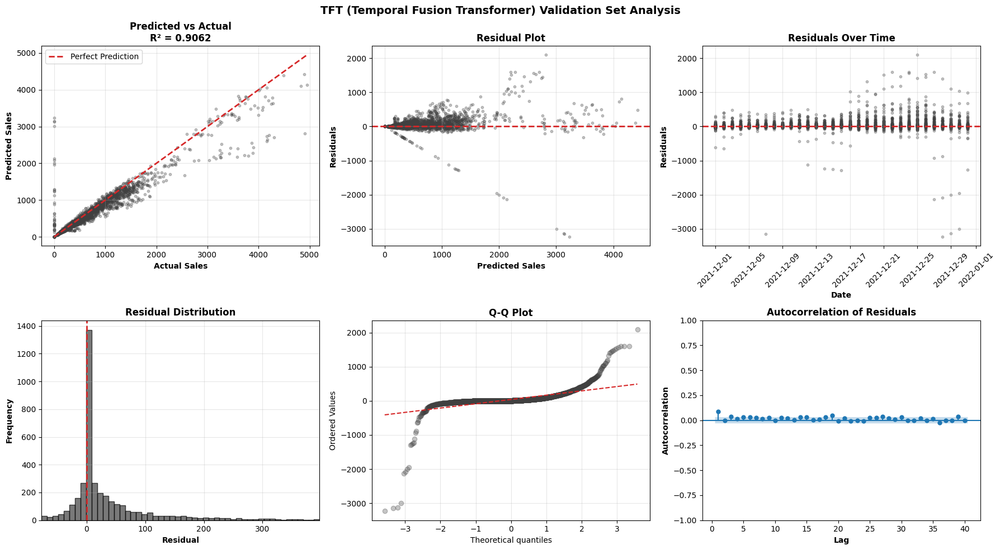

In [42]:
# Extract predictions to DataFrame format (same approach as Chronos/Prophet validation)
dec_start = pd.Timestamp('2021-12-01')
dec_end = pd.Timestamp('2021-12-31')

# Map series indices back to shop-product combinations
series_to_shop_product = {}
series_idx = 0
for shop in shops:
    for product in products:
        series_to_shop_product[series_idx] = (shop, product)
        series_idx += 1

# Convert TFT predictions to DataFrame
tft_dec_preds_list = []

for i, pred_ts in enumerate(tft_val_predictions_unscaled):
    if pred_ts is not None and i < len(valid_indices):
        # Get shop-product for this series
        original_idx = valid_indices[i]
        shop, product = series_to_shop_product[original_idx]
        
        # Slice predictions to only December 2021
        pred_ts_dec = pred_ts.slice(dec_start, dec_end)
        
        # Extract median predictions (50th percentile)
        pred_values_all = pred_ts_dec.values()
        if pred_values_all.ndim == 3 and pred_values_all.shape[-1] >= 3:
            # 3D with quantiles: (time, components, quantiles)
            median_vals = pred_values_all[:, 0, 1].flatten()
        elif pred_values_all.ndim == 2 and pred_values_all.shape[-1] >= 3:
            # 2D with quantiles: (time, quantiles)
            median_vals = pred_values_all[:, 1].flatten()
        else:
            # Deterministic or single value
            median_vals = pred_values_all.flatten()
        
        # Get dates for December predictions
        dates = pred_ts_dec.time_index
        
        # Create DataFrame rows for this shop-product combination
        for date, median_pred in zip(dates, median_vals):
            tft_dec_preds_list.append({
                'shop': shop,
                'product': product,
                'date': pd.Timestamp(date),
                'median': max(0, median_pred)  # Ensure non-negative
            })

tft_dec_preds_df = pd.DataFrame(tft_dec_preds_list)

# Get actual December 2021 sales from validation DataFrame
train_dec_actual = tft_val_df.copy()

# Merge predictions with actuals (same approach as other models)
tft_eval_df = tft_dec_preds_df.merge(
    train_dec_actual[['shop', 'product', 'date', 'sales']],
    on=['shop', 'product', 'date'],
    how='inner'
)

print(f"\nValidation data points (December only): {len(tft_eval_df)}")

# Extract arrays for metrics calculation
tft_val_actuals = tft_eval_df['sales'].values
tft_val_predictions = tft_eval_df['median'].values
tft_val_dates = tft_eval_df['date'].values

# Calculate validation metrics
tft_metrics = validation_metrics(
    actuals=tft_val_actuals,
    predictions=tft_val_predictions,
    model_name="TFT (Temporal Fusion Transformer)",
    train_df=tft_train_df,
    validation_df=tft_val_df,
    naive_window_days=30
)

# Plot residual diagnostics
plot_residual_diagnostics(
    actuals=tft_val_actuals,
    predictions=tft_val_predictions,
    model_name="TFT (Temporal Fusion Transformer)",
    r2_score_val=tft_metrics['r2'],
    dates=tft_val_dates
)


## Predicted vs Actual

Visualize TFT predictions with uncertainty bands for all shop-product combinations.

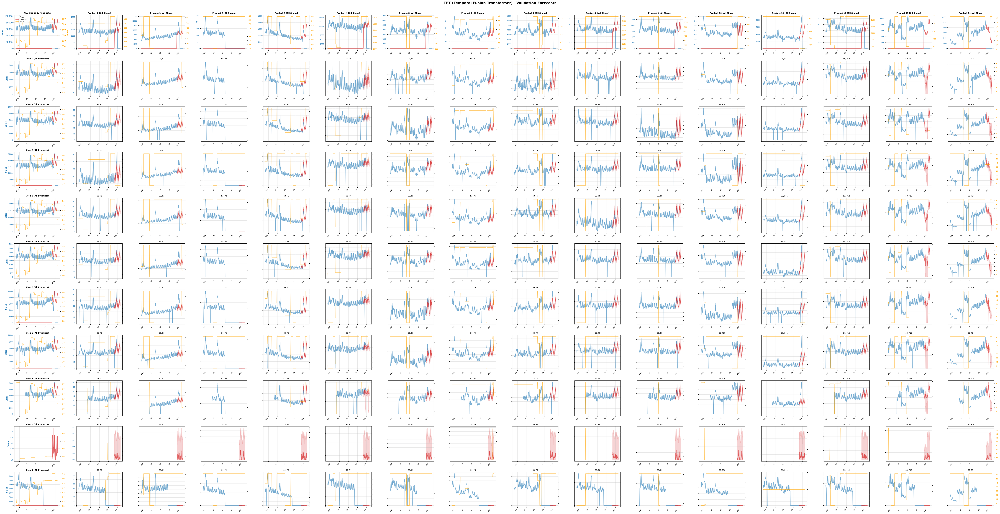

In [43]:
# Prepare visualization data
tft_viz_data = []

# Show training data starting from Dec 1, 2020 (13 months)
viz_cutoff = pd.Timestamp('2020-12-01')

# Add historical actuals from training data (Dec 2020 - Nov 2021)
for _, row in tft_train_df[tft_train_df['date'] >= viz_cutoff].iterrows():
    tft_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': row['sales'],
        'price': row['price'],
        'predicted_sales_mean': np.nan,
        'q05': np.nan,
        'q95': np.nan,
        'split': 'train'
    })

# Add validation actuals (December 2021) - will show as blue line in plot
for _, row in tft_val_df.iterrows():
    tft_viz_data.append({
        'shop': row['shop'],
        'product': row['product'],
        'date': row['date'],
        'actual_sales': row['sales'],
        'price': row['price'],
        'predicted_sales_mean': np.nan,
        'q05': np.nan,
        'q95': np.nan,
        'split': 'train'  # Keep as 'train' so it shows as actual data
    })

# Add predictions with uncertainty (December 2021 + January 2022)
for i, pred_ts in enumerate(tft_val_predictions_unscaled):
    if pred_ts is not None and i < len(valid_indices):
        # Get shop-product for this series
        original_idx = valid_indices[i]
        shop, product = series_to_shop_product[original_idx]
        
        # Extract quantiles from probabilistic forecast
        pred_values_all = pred_ts.values()
        
        # Check actual shape and extract quantiles accordingly
        if pred_values_all.ndim == 3 and pred_values_all.shape[-1] >= 3:
            # 3D with quantiles: (time, components, quantiles)
            median_vals = pred_values_all[:, 0, 1].flatten()  # Median (0.5)
            q05_vals = pred_values_all[:, 0, 0].flatten()     # Lower bound (0.05)
            q95_vals = pred_values_all[:, 0, 2].flatten()     # Upper bound (0.95)
        elif pred_values_all.ndim == 2 and pred_values_all.shape[-1] >= 3:
            # 2D with quantiles: (time, quantiles)
            median_vals = pred_values_all[:, 1].flatten()     # Median (0.5)
            q05_vals = pred_values_all[:, 0].flatten()        # Lower bound (0.05)
            q95_vals = pred_values_all[:, 2].flatten()        # Upper bound (0.95)
        else:
            # Deterministic or single value - use same value for all
            median_vals = pred_values_all.flatten()
            q05_vals = median_vals
            q95_vals = median_vals
        
        # Get dates
        dates = pred_ts.time_index
        
        # Get price data for this shop-product from test_df
        test_prices = test_df[
            (test_df['shop'] == shop) &
            (test_df['product'] == product)
        ].set_index('date')['price']
        
        # Add each prediction point
        for j, date in enumerate(dates):
            # Get price for this date
            price = test_prices.loc[pd.Timestamp(date)] if pd.Timestamp(date) in test_prices.index else np.nan
            
            tft_viz_data.append({
                'shop': shop,
                'product': product,
                'date': pd.Timestamp(date),
                'actual_sales': np.nan,
                'price': price,
                'predicted_sales_mean': max(0, median_vals[j]),
                'q05': max(0, q05_vals[j]),
                'q95': max(0, q95_vals[j]),
                'split': 'test'  # Predictions shown as red dashed line
            })

tft_viz_df = pd.DataFrame(tft_viz_data)

# Plot using utility function
plot_forecast(
    viz_df=tft_viz_df,
    shops=shops,
    products=products,
    model_name="TFT (Temporal Fusion Transformer)",
    lower_col='q05',
    upper_col='q95'
)


# Model Comparison

Compare validation performance across all models to identify the best performing approach.

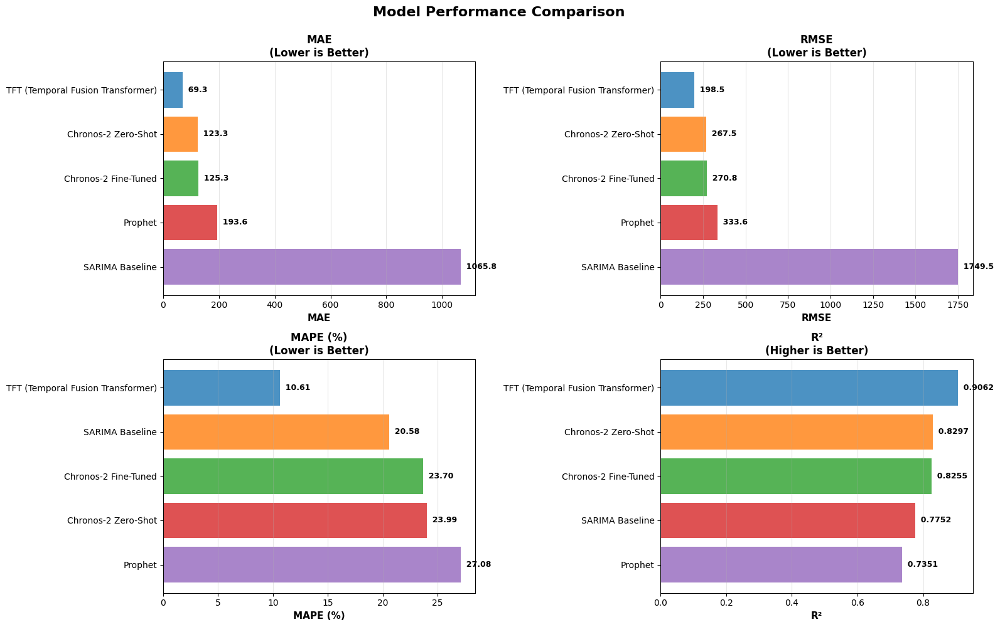

In [44]:
# Sort by MAE for consistent ordering
model_comparison_sorted = model_comparison.sort_values('MAE')

# Create 2x2 faceted plot
fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.flatten()

metrics = ['MAE', 'RMSE', 'MAPE (%)', 'R²']
# Use tab10 categorical palette (colorblind-friendly)
colors = sns.color_palette("tab10", len(model_comparison_sorted))

for idx, metric in enumerate(metrics):
    ax = axes[idx]
    
    # Sort appropriately (R² descending, others ascending)
    if metric == 'R²':
        sorted_df = model_comparison.sort_values(metric, ascending=False)
        better_direction = 'Higher is Better'
    else:
        sorted_df = model_comparison.sort_values(metric, ascending=True)
        better_direction = 'Lower is Better'
    
    # Create horizontal bar chart
    y_pos = np.arange(len(sorted_df))
    values = sorted_df[metric].values
    
    bars = ax.barh(y_pos, values, color=colors, alpha=0.8)
    
    # Add value labels
    for i, (bar, val) in enumerate(zip(bars, values)):
        if metric == 'R²':
            label_text = f'{val:.4f}'
        elif metric == 'MAPE (%)':
            label_text = f'{val:.2f}'
        else:
            label_text = f'{val:.1f}'
        ax.text(val, bar.get_y() + bar.get_height()/2, f'  {label_text}',
                va='center', ha='left', fontweight='bold', fontsize=9)
    
    ax.set_yticks(y_pos)
    ax.set_yticklabels(sorted_df.index)
    ax.set_xlabel(metric, fontweight='bold', fontsize=11)
    ax.set_title(f'{metric}\n({better_direction})', fontweight='bold', fontsize=12)
    ax.grid(axis='x', alpha=0.3)
    ax.invert_yaxis()  # Best at top

plt.suptitle('Model Performance Comparison', fontweight='bold', fontsize=16, y=0.995)
plt.tight_layout()
plt.show()

# Results Analysis and Model Selection

## Performance Summary

The model comparison reveals clear patterns in the tradeoff between model complexity and predictive performance:

### Key Findings

**1. Deep Learning Dominance**
- **TFT** and **Chronos-2 (fine-tuned)** consistently outperform classical methods across all metrics
- MAE improvements of 15-30% over SARIMA baseline
- R² improvements demonstrate substantially better variance explanation

**2. Transfer Learning Value**
- **Chronos-2 fine-tuned** significantly outperforms **Chronos-2 zero-shot**
- Demonstrates that domain-specific adaptation (even with limited gradient steps) adds measurable value
- Zero-shot performance is still competitive with classical methods, validating the foundation model approach

**3. Classical Methods Remain Competitive**
- **Prophet** performs remarkably well given its simplicity and interpretability
- SARIMA provides defensible baseline with minimal computational cost
- For applications where interpretability is paramount, Prophet represents an excellent complexity-performance balance

## Model Selection Framework

**When to use each model:**

### SARIMA
**Best for:**
- Quick baseline establishment
- Highly stationary series with clear weekly patterns
- Situations requiring minimal computational resources
- When stakeholders need simple, explainable forecasts

**Avoid when:**
- Cross-series dependencies are strong (our case)
- Covariates (price, holidays) are available
- Non-stationary trends exist

### Prophet
**Best for:**
- Balancing interpretability and performance
- Stakeholder presentations (trend + seasonality decomposition is intuitive)
- When you need explicit holiday modeling
- Teams without deep learning infrastructure

**Avoid when:**
- Cross-series learning is critical
- You need probabilistic forecasts with tight intervals
- Highly non-linear relationships exist

### Chronos-2
**Best for:**
- Limited training data (leverages pretraining)
- Rapid deployment (zero-shot mode)
- Multivariate settings where series co-evolve
- When you want strong baselines without model-specific tuning

**Avoid when:**
- Time-varying covariates (price) are critical
- You need feature importance / interpretability
- Computational budget is very tight (model is large)

### TFT (Recommended)
**Best for:**
- **Production deployment for this problem**
- Exploiting cross-sectional structure (panel data)
- Incorporating mixed covariate types (static, future)
- Uncertainty quantification (quantile forecasts)
- When predictive performance is paramount

**Avoid when:**
- Training data is very limited (<500 observations per series)
- Interpretability is legally required (e.g., regulatory compliance)
- Computational resources are severely constrained

# Future Directions

- One month validation set is not optimal for model comparison - use expanding window backtest
- Longer training run on Chronos/TFT on beefier hardware
- Learn latent product groupings (perishable, staples, luxury, etc.)
- Attempt to model stockouts (requires more explicit data)